In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
import torch.optim as optim
import mlflow
import mlflow.pytorch

from transformers import AutoTokenizer, GPT2LMHeadModel
from undecorated import undecorated
from types import MethodType

import time
import pickle
import io
import os

device = (
    "cuda"
    if torch.cuda.is_available()
    else "mps"
    if torch.backends.mps.is_available()
    else "cpu"
)
torch.set_default_device(device)
print(f"Using {device} device")
print(torch.tensor([1, 2, 3]).device)

def llikelihood(output: tuple, target_sequence) -> float:
    """Calculate the log-likelihood of the target tokens in the output sequence.
    NOTE: This only works for greedy search, not beam search (i.e. set num_beams=1).
    NOTE: We use a minimizer

    Args:
        output (tuple): Output from a HF LLM text generation model. Only pass one sequence.
        target_sequence (torch.Tensor): The target tokens (the sequence) to calculate the log-likelihood of.

    Returns:
        float: log-llikelihood for the sequence
    """

    # get scores and the sequences
    scores = torch.stack(output.scores).reshape(len(output.scores), -1).transpose(0, 1)

    # get the scores into a matrix, use log_softmax
    m_prob = torch.nn.functional.log_softmax(scores, dim=0)
    m_prob_sub = m_prob[target_sequence.squeeze()]

    # get the diagonal of the matrix
    v_trans_prob = torch.diag(m_prob_sub)
    print(v_trans_prob.shape)
    d_llikelihood = torch.sum(v_trans_prob) * (-1)

    return d_llikelihood

# Defining Autoencoder model
class Autoencoder(nn.Module):
   def __init__(self, input_size, encoding_dim, output_size):
       super(Autoencoder, self).__init__()
       self.encoder = nn.Sequential(
           nn.Linear(input_size, encoding_dim, bias=True)
       )
       self.decoder = nn.Sequential(
           nn.Linear(encoding_dim, output_size, bias=True)#,
           #nn.LayerNorm(output_size)
       )

   def forward(self, x):
       x = self.encoder(x)
       x = self.decoder(x)
       return x

def create_input_data(iClaims):
    return torch.eye(iClaims)

fn_generate_i = lambda x, i: model.generate_with_grad(
        inputs_embeds=x,
        do_sample=False,
        eos_token_id=tokenizer.eos_token_id,
        pad_token_id=tokenizer.eos_token_id,
        max_new_tokens=i,
        num_beams=i_num_beams,
        num_return_sequences=i_num_return,
        return_dict_in_generate=True,
        output_scores=True)

# INIT
s_model = "gpt2"

torch.manual_seed(4523522)
model = GPT2LMHeadModel.from_pretrained(s_model)
tokenizer = AutoTokenizer.from_pretrained(s_model)
tokenizer.pad_token_id = tokenizer.eos_token_id
tokenizer.padding_side = "left"


# BUG: Issue that greedy search does not find max likelihood sequence? Does this matter?
i_num_beams = 1 # greedy search for i_num_beams = 1
i_no_repeat_ngram_size = 1 # TODO: This creates inplace gradient error
i_num_return = 1

# TODO: Link to this https://github.com/huggingface/transformers/issues/15552 (last comment)
generate_with_grad = model.generate.__closure__[1].cell_contents
model.generate_with_grad = MethodType(generate_with_grad, model)

lTargetStrings = [
                  "Experience 50% more visible shine after just one use.",
                  "Experience the magic of hair that dazzles with every movement.",
                  "Formulated with light-reflecting technology for a glossy finish.",
                  "Unlock the secret to hair that shines from within, reflecting your inner glow."
                  ]


lTargetStrings = [
    "Experience mirror-like shine with every wash.",
    "Get dazzling, glossy hair in just one use.",
    "Transform dull strands into radiant locks.",
    "Achieve salon-quality shine at home.",
    "Enhance natural brilliance with our advanced formula.",
    "Reveal luminous, shimmering hair from root to tip.",
    "Infuse your hair with a brilliant, high-gloss finish.",
    "Unveil your hair's true sparkle with our revitalizing shampoo.",
    "Illuminate your hair with a dazzling, reflective shine.",
    "See noticeable shine improvement with every application.",
    "Unlock the confidence of luminous hair that turns heads.",
    "Experience the joy of hair that gleams with vitality.",
    "Embrace the radiance of hair that reflects your inner beauty.",
    "Elevate your everyday with hair that shines with sophistication.",
    "Feel the allure of irresistibly shiny hair that captivates.",
    "Indulge in the luxury of silky-smooth hair that shines from within.",
    "Discover the magic of hair that exudes luminosity and health.",
    "Let your hair shine like a beacon of self-assurance and style.",
    "Radiate with the brilliance of hair that embodies vitality and youthfulness.",
    "Celebrate the luminosity of hair that mirrors your vibrant personality."
]

lTargetStrings = [
    "Our surface cleaner delivers a mirror-like shine every time.",
    "Say goodbye to streaks and smudges with our powerful formula.",
    "Achieve a noticeable sparkle on all surfaces with just one application.",
    "Experience surfaces so clean, you can see your reflection in them.",
    "Our cleaner leaves behind a gleaming, polished finish that lasts.",
    "Elevate your surroundings with a touch of brilliance.",
    "Unleash the hidden beauty of your home with our surface cleaner.",
    "Experience the joy of pristine surfaces that brighten your space.",
    "Bring a sense of clarity and freshness to your environment.",
    "Enhance the ambiance of any room with surfaces that radiate.",
    "Experience mirror-like shine with every wash.",
    "Get dazzling, glossy hair in just one use.",
    "Transform dull strands into radiant locks.",
    "Achieve salon-quality shine at home.",
    "Enhance natural brilliance with our advanced formula.",
    "Unlock the confidence of luminous hair that turns heads.",
    "Experience the joy of hair that gleams with vitality.",
    "Embrace the radiance of hair that reflects your inner beauty.",
    "Elevate your everyday with hair that shines with sophistication.",
    "Feel the allure of irresistibly shiny hair that captivates."
    ]

# lTargetStrings = [
#     "Experience 50% more visible shine after just one use.",
#     "Formulated with light-reflecting technology for a glossy finish.",
#     "Transform dull strands into radiant, luminous locks.",
#     "Infused with nourishing oils that enhance natural shine.",
#     "See instant brilliance with our advanced shine-boosting formula.",
#     "Elevate your confidence with hair that gleams under any light.",
#     "Embrace the allure of luminous hair that turns heads.",
#     "Unleash the power of radiant hair that speaks volumes.",
#     "Transform your look with hair that exudes brilliance.",
#     "Feel the difference of hair that shines with vitality and health."]
# lTargetStrings = [
#                   "potato",
#                   "tomato",
#                   "bridge",
#                   "street"
#                   ]
# Hair product
lTargetStrings = [
    "Experience 50% more visible shine after just one use.",
    "Formulated with light-reflecting technology for a glossy finish.",
    "Transform dull strands into radiant, luminous locks.",
    "Infused with nourishing oils that enhance natural shine.",
    "See instant brilliance with our advanced shine-boosting formula.",
    "Locks in moisture to amplify hair's natural luster.",
    "Achieve salon-quality shine without leaving home.",
    "Visible reduction in dullness, replaced with stunning shine.",
    "Say goodbye to lackluster hair, hello to mirror-like shine.",
    "Clinically proven to enhance shine by up to 70%.", # ^tangible
    "Elevate your confidence with hair that gleams under any light.",
    "Embrace the allure of luminous hair that turns heads.",
    "Unleash the power of radiant hair that speaks volumes.",
    "Transform your look with hair that exudes brilliance.",
    "Feel the difference of hair that shines with vitality and health.",
    "Rediscover the joy of hair that beams with inner vibrancy.",
    "Indulge in the luxury of hair that shimmers with elegance.",
    "Step into the spotlight with hair that radiates beauty.",
    "Experience the magic of hair that dazzles with every movement.",
    "Unlock the secret to hair that shines from within, reflecting your inner glow."
]

lTargetStrings = [
    "Our surface cleaner delivers a mirror-like shine every time.",
    "Say goodbye to streaks and smudges with our powerful formula.",
    "Achieve a noticeable sparkle on all surfaces with just one application.",
    "Experience surfaces so clean, you can see your reflection in them.",
    "Our cleaner leaves behind a gleaming, polished finish that lasts.",
    "Elevate your surroundings with a touch of brilliance.",
    "Unleash the hidden beauty of your home with our surface cleaner.",
    "Experience the joy of pristine surfaces that brighten your space.",
    "Bring a sense of clarity and freshness to your environment.",
    "Enhance the ambiance of any room with surfaces that radiate."
]

lTargetStrings = [
    "Experience mirror-like shine with every wash.",
    "Get dazzling, glossy hair in just one use.",
    "Transform dull strands into radiant locks.",
    "Achieve salon-quality shine at home.",
    "Enhance natural brilliance with our advanced formula.",
    "Unlock the confidence of luminous hair that turns heads.",
    "Experience the joy of hair that gleams with vitality.",
    "Embrace the radiance of hair that reflects your inner beauty.",
    "Elevate your everyday with hair that shines with sophistication.",
    "Feel the allure of irresistibly shiny hair that captivates."
]

lTargetStrings = [
    "Locks in moisture to amplify hair's natural luster.",
    "Achieve salon-quality shine without leaving home.",
    "Visible reduction in dullness, replaced with stunning shine.",
    "Say goodbye to lackluster hair, hello to mirror-like shine.",
    "Clinically proven to enhance shine by up to 70%.", # ^tangible
    "Elevate your confidence with hair that gleams under any light.",
    "Embrace the allure of luminous hair that turns heads.",
    "Unleash the power of radiant hair that speaks volumes.",
    "Transform your look with hair that exudes brilliance.",
    "Feel the difference of hair that shines with vitality and health."]

# lTargetStrings = [
#     "I walk in",
#     "You walk in",
#     "I jump up",
#     "You jump up"
# ]

# <|endoftext|>
# lTargetStrings = [
#     "Potatoes are great.",
#     "I love bananas!",
#     "Rotten tomatoes are the worst."
# ]

lGenerate = []
lTargetSequence = []

# automatically append the EOS token now
for i, sTargetString in enumerate(lTargetStrings):
    lTargetSequence.append(torch.cat([tokenizer.encode(sTargetString, return_tensors="pt"), torch.tensor([[tokenizer.eos_token_id]]).to(device)], dim=1))
    lGenerate.append(lambda x: fn_generate_i(x, lTargetSequence[i].shape[1]))

tOHETarget = create_input_data(len(lTargetSequence))

input_size = tOHETarget.shape[0]  # Number of input features
encoding_dim = 2  # Desired number of outtput dimensions
output_size = 768  # Number of output features

/Users/hoener/miniforge3/envs/mphil/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Using mps device
mps:0


In [2]:
# Read in the sentences from lClaims
def TokenizeClaims(lClaims, tokenizer):
    # Tokenize the sentences
    tokenized_sentences = [tokenizer.encode(sentence, add_special_tokens=True) for sentence in lClaims]

    # Find the maximum length of the tokenized sentences
    max_length = max(len(sentence) for sentence in tokenized_sentences)

    # Pad the tokenized sentences on the left to have the same length
    padded_sentences = [sentence + [tokenizer.pad_token_id] * (max_length - len(sentence) + 1) for sentence in tokenized_sentences]

    # Convert the padded sentences to tensors
    padded_sentences = torch.tensor(padded_sentences)
    

    return padded_sentences


In [3]:
tTargetStrings = TokenizeClaims(lTargetStrings, tokenizer)
tTargetStrings

tensor([[44901, 10162,    12,  2339, 18340,   351,   790, 13502,    13, 50256,
         50256, 50256, 50256, 50256, 50256],
        [ 3855, 41535,    11, 40551,  4190,   287,   655,   530,   779,    13,
         50256, 50256, 50256, 50256, 50256],
        [41762, 19222, 36593,   656, 43888, 19253,    13, 50256, 50256, 50256,
         50256, 50256, 50256, 50256, 50256],
        [   32, 24957, 46608,    12, 13237, 18340,   379,  1363,    13, 50256,
         50256, 50256, 50256, 50256, 50256],
        [35476,   590,  3288, 37451,   351,   674,  6190, 10451,    13, 50256,
         50256, 50256, 50256, 50256, 50256],
        [ 3118,  5354,   262,  6628,   286, 29763,   516,  4190,   326,  4962,
          6665,    13, 50256, 50256, 50256],
        [44901,   262,  8716,   286,  4190,   326, 26852,  4105,   351, 41687,
            13, 50256, 50256, 50256, 50256],
        [10161, 46565,   262,  2511,  3610,   286,  4190,   326, 12497,   534,
          8434,  8737,    13, 50256, 50256],
        

In [4]:
iMaxTokens = 15
fn_generate_max = lambda x: model.generate_with_grad(
        inputs_embeds=x,
        do_sample=False,
        pad_token_id=tokenizer.eos_token_id,
        max_new_tokens=iMaxTokens,
        num_beams=1,
        num_return_sequences=1,
        return_dict_in_generate=True,
        output_scores=True)

fn_generate_max = lambda x: model.generate_with_grad(
        inputs_embeds=x,
        do_sample=False,
        pad_token_id=tokenizer.eos_token_id,
        max_new_tokens=iMaxTokens,
        num_beams=1,
        num_return_sequences=1,
        return_dict_in_generate=True,
        output_scores=True)

ae = Autoencoder(input_size, encoding_dim, output_size)
tAEOutputs = ae(tOHETarget).reshape(tOHETarget.shape[0], 1, -1)

In [45]:
def PadScores(tOut, iMaxTokens, iClaims, iVocab: int=50257):

    tPadding = torch.zeros((iClaims, iVocab))
    tPadding[:, -1] = 1
    #tPadding[tPadding == 0] = float('-inf')
    tPadding[tPadding == 0] = float(-1e2)

    n = iMaxTokens - tOut.shape[1]  # Number of times to add tPadding
    tOut_padded = torch.cat([tOut] + [tPadding.unsqueeze(1)] * n, dim=1)
    
    return tOut_padded

def LLikelihood(lScores, tTargetStrings, iMaxTokens, iClaims, iVocab: int=50257):

    # get the prob. scores for all generated tokens, of all claims, mProb is iClaims x iMaxTokens x iVocabSize
    mProb = torch.nn.functional.log_softmax(torch.stack(lScores).transpose(0, 1), dim=2)
    mProb = PadScores(mProb, iMaxTokens, iClaims, iVocab)
    
    # Use advanced indexing to get the values of the target tokens, mProbSub is iClaims x iMaxTokens; Elements are the log-probabilities of the target tokens at
    # that position
    
    # Add a new dimension to B to make it compatible with A
    tTargetStrings = tTargetStrings.unsqueeze(-1)
    mProbSub = mProb.gather(2, tTargetStrings).squeeze(-1)

    # # BUG: Do we really need the sum over the whole matrix?
    # # mProbSub is iClaims x iMaxTokens
    dLL = torch.sum(mProbSub) * (-1)

    return dLL, torch.sum(mProbSub, dim = 1) * (-1)


time: 3.69 s


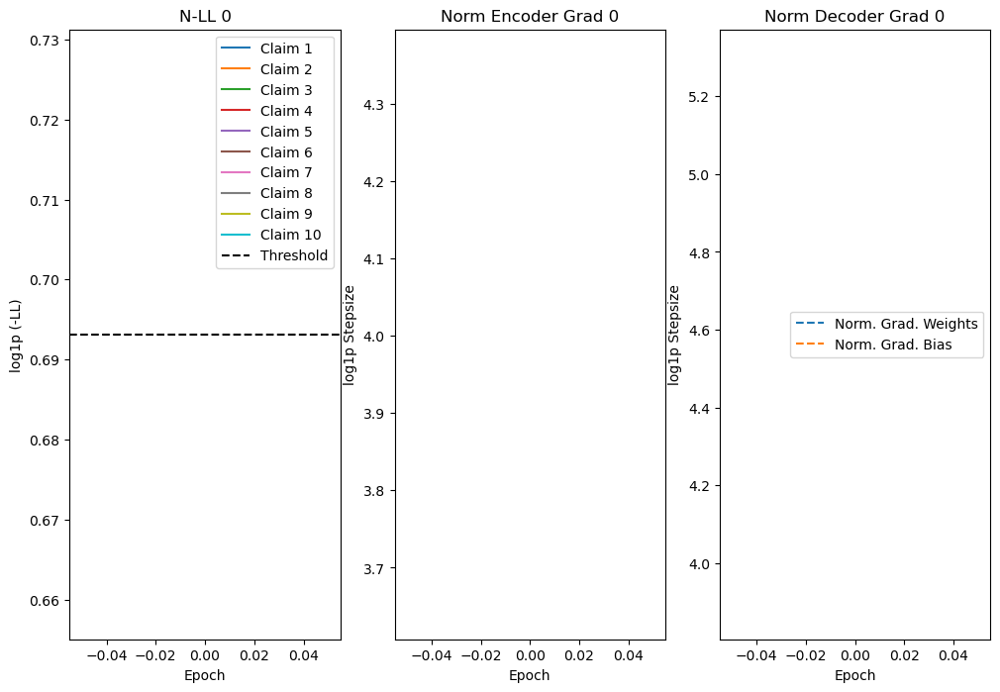

Claim 0: <|endoftext|>_______________
Claim 1: <|endoftext|>_______________
Claim 2: <|endoftext|>. ( " " " " " " " " " " " " "
Claim 3: <|endoftext|>_______________
Claim 4: <|endoftext|>_..____________
Claim 5: <|endoftext|>_______________
Claim 6: <|endoftext|>. < < < < < < < < < < < < < <
Claim 7: <|endoftext|>.. flags: (in: ( "C: ( "C:
Claim 8: <|endoftext|>_______________
Claim 9: <|endoftext|>.W.WwWwWwWwWwWw
time: 29.32 s


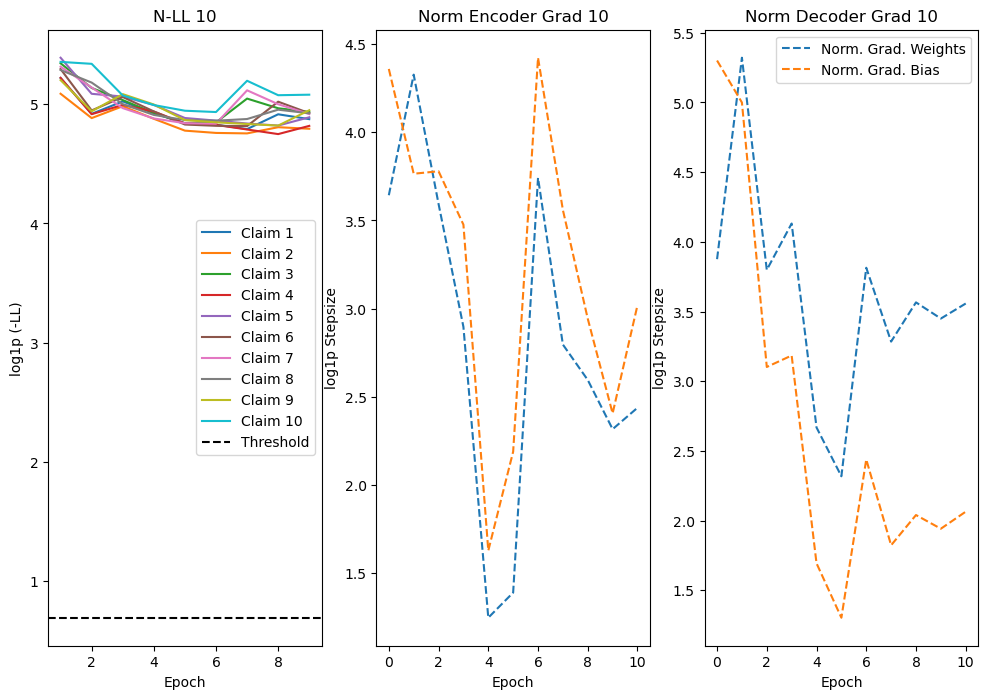

Claim 0: <|endoftext|>Add. a












Claim 1: <|endoftext|>Add. a












Claim 2: <|endoftext|>Add. a












Claim 3: <|endoftext|>
..............
Claim 4: <|endoftext|>_..












Claim 5: <|endoftext|>Add. a












Claim 6: <|endoftext|>Add. a












Claim 7: <|endoftext|>Add. : : : : : : : : : : : : :
Claim 8: <|endoftext|>_..












Claim 9: <|endoftext|>Add. a












time: 26.16 s


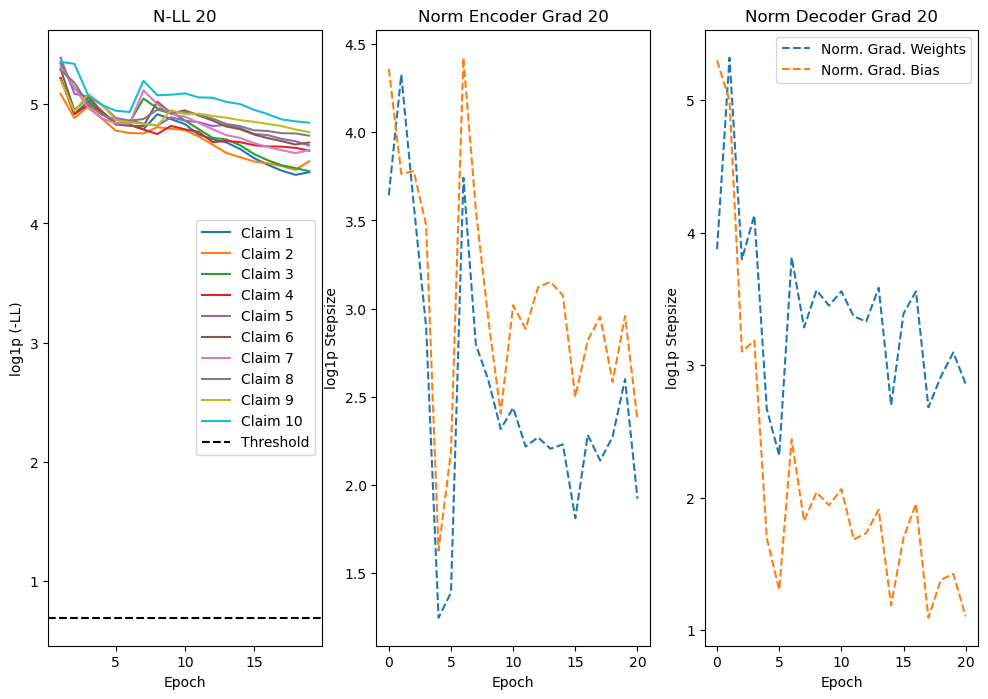

Claim 0: <|endoftext|>Integ<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Integ<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Complete<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Twe.













Claim 4: <|endoftext|>Twe<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Integ<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><

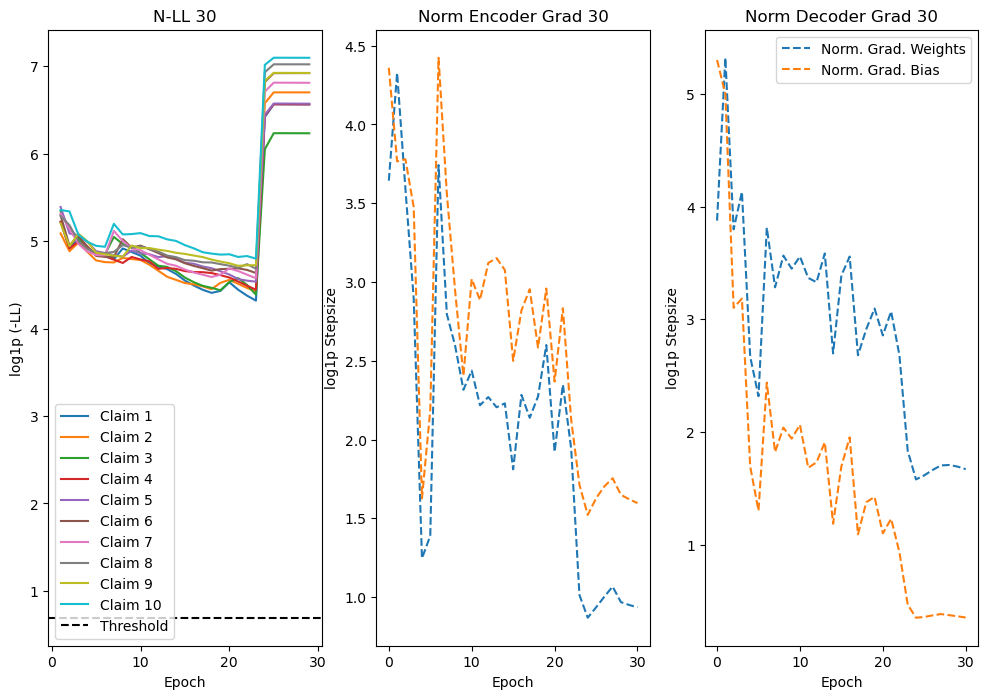

Claim 0: <|endoftext|>Feel<|endoftext|>
Claim 1: <|endoftext|>Feel<|endoftext|>
Claim 2: <|endoftext|>Feel<|endoftext|>
Claim 3: <|endoftext|>Installation<|endoftext|>
Claim 4: <|endoftext|>Installation<|endoftext|>
Claim 5: <|endoftext|>Feel<|endoftext|>
Claim 6: <|endoftext|>Feel<|endoftext|>
Claim 7: <|endoftext|>Feel<|endoftext|>
Claim 8: <|endoftext|>Enjoy<|endoftext|>
Claim 9: <|endoftext|>Feel<|endoftext|>
time: 10.71 s


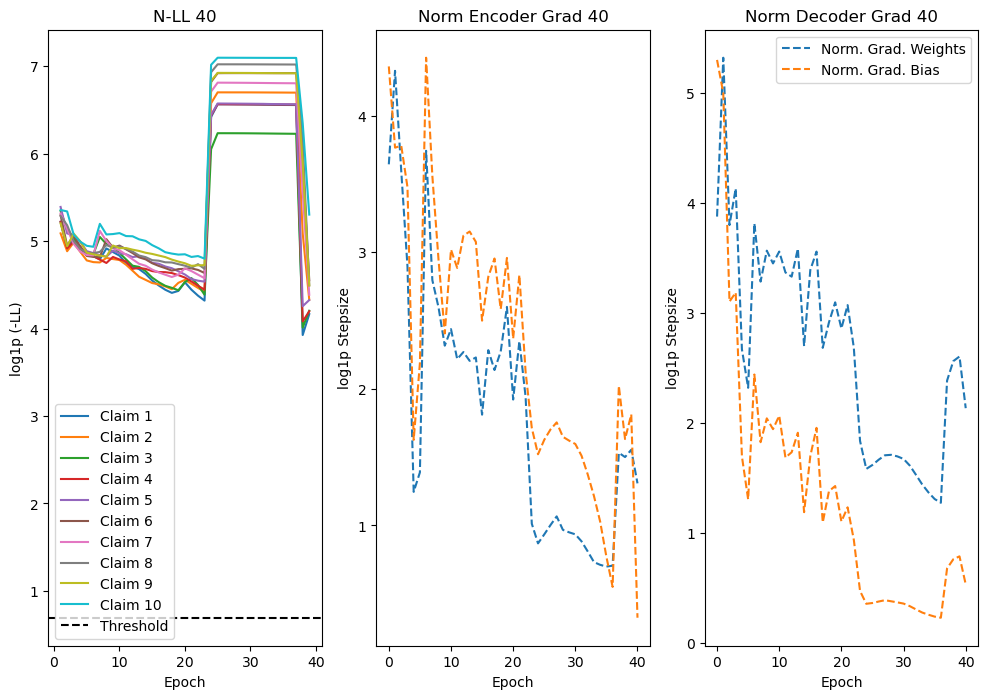

Claim 0: <|endoftext|>Experience the the the the the the<|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience the the the the<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Experience<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Transform<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Transform<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Experience the the the the the the the<|endoftext|>
Claim 6: <|endoftext|>Experience the the the the the the<|endoftext|><|endoftext|>
Claim 7: <|endoftext|>Experience the the the the the the the<|endoftext|>
Claim 8: <|endoftext|>Experience the the the the<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 9: <|endoftext|>Experience the the the the the the the<|endoftext|>
t

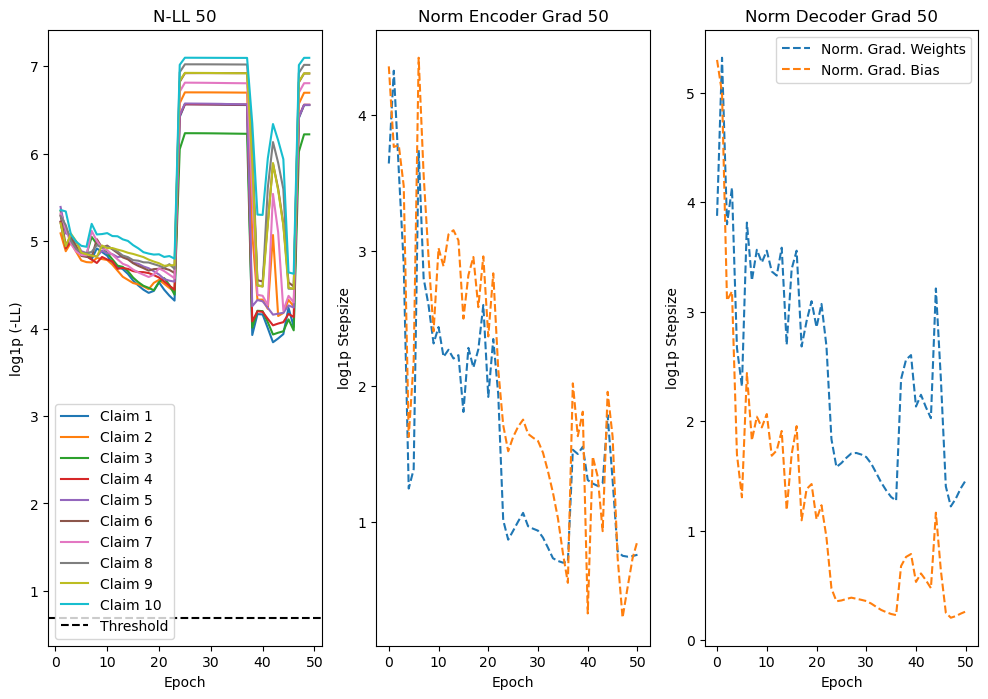

Claim 0: <|endoftext|>Transform<|endoftext|>
Claim 1: <|endoftext|>Transform<|endoftext|>
Claim 2: <|endoftext|>Transform<|endoftext|>
Claim 3: <|endoftext|>Transform<|endoftext|>
Claim 4: <|endoftext|>Transform<|endoftext|>
Claim 5: <|endoftext|>Experience<|endoftext|>
Claim 6: <|endoftext|>Experience<|endoftext|>
Claim 7: <|endoftext|>Un<|endoftext|>
Claim 8: <|endoftext|>Transform<|endoftext|>
Claim 9: <|endoftext|>Experience<|endoftext|>
time: 13.49 s


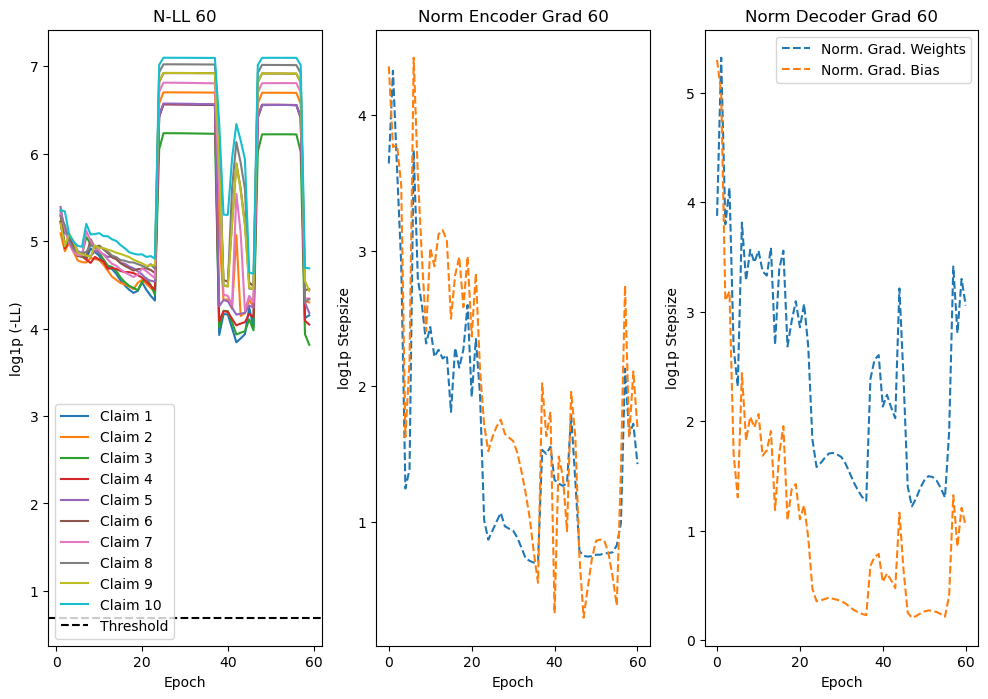

Claim 0: <|endoftext|>Experience<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience the<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Enh<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Enhchievechievechievechieve<|endoftext|>
Claim 4: <|endoftext|>Enh<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Experience the<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|endoftext|>Em of the<|endoftext|><|endoftext|><|endoftext|>
Claim 8: <|endoftext|>Enh the the<|endoftext|><|endoftext|><|endoftext|>
Claim 9: <|endoftext|>Un.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
time: 4.75 s


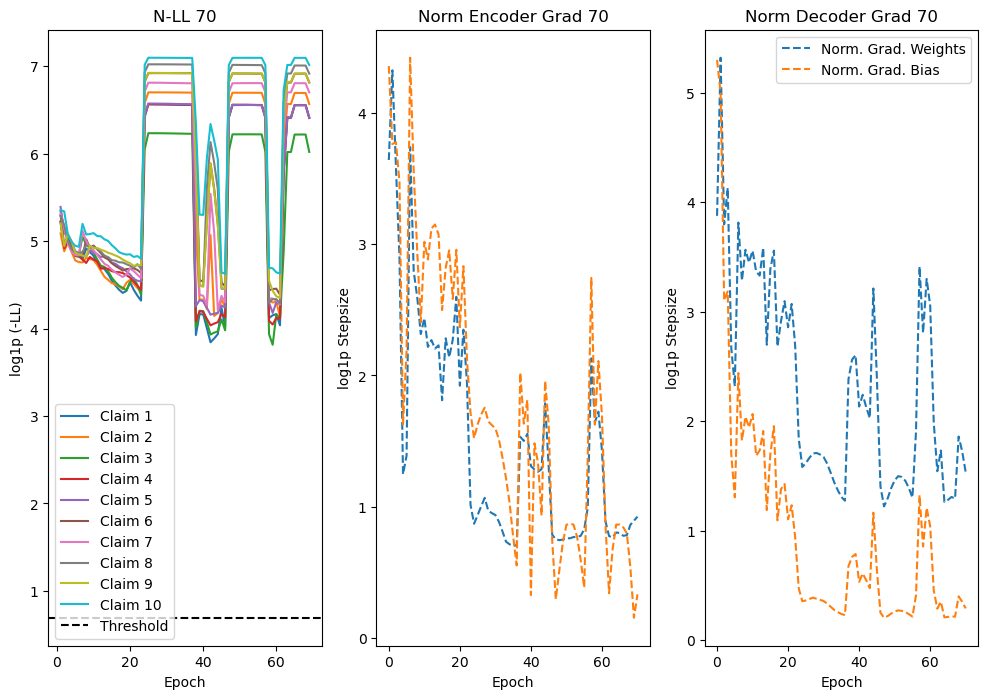

Claim 0: <|endoftext|>Experience<|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience<|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Experience<|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Enh<|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enh<|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Experience the<|endoftext|>
Claim 6: <|endoftext|>Experience the<|endoftext|>
Claim 7: <|endoftext|>Experience the<|endoftext|>
Claim 8: <|endoftext|>E the<|endoftext|>
Claim 9: <|endoftext|>Feel the<|endoftext|>
time: 18.14 s


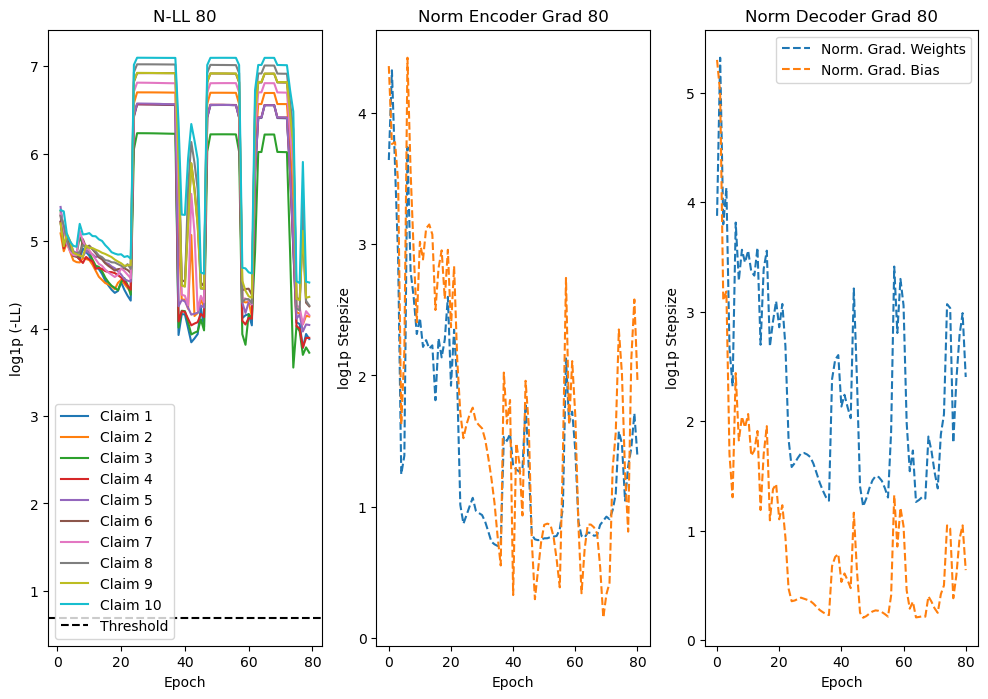

Claim 0: <|endoftext|>Experience radiant radiant radiant radiant radiant radiant<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Transform radiant radiant radiant radiant radiant radiant radiant<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform radiant radiant radiant radiant<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Enhchievechieve<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enh shine shine<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Experience the the the hair hair

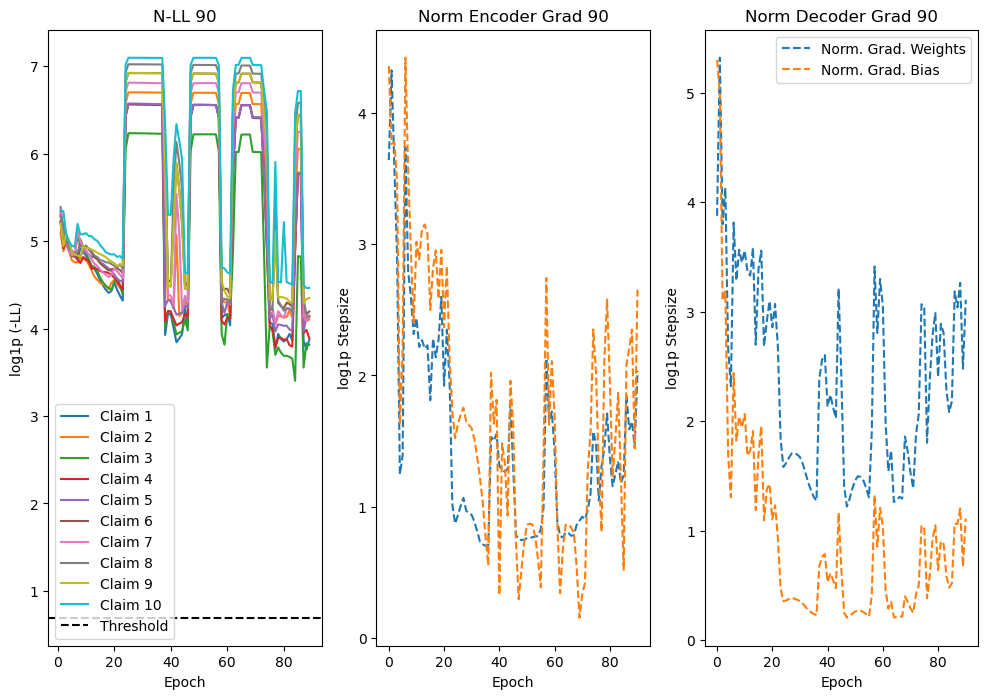

Claim 0: <|endoftext|>Experience radiant radiant<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Get hair with<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>E<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>E<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|en

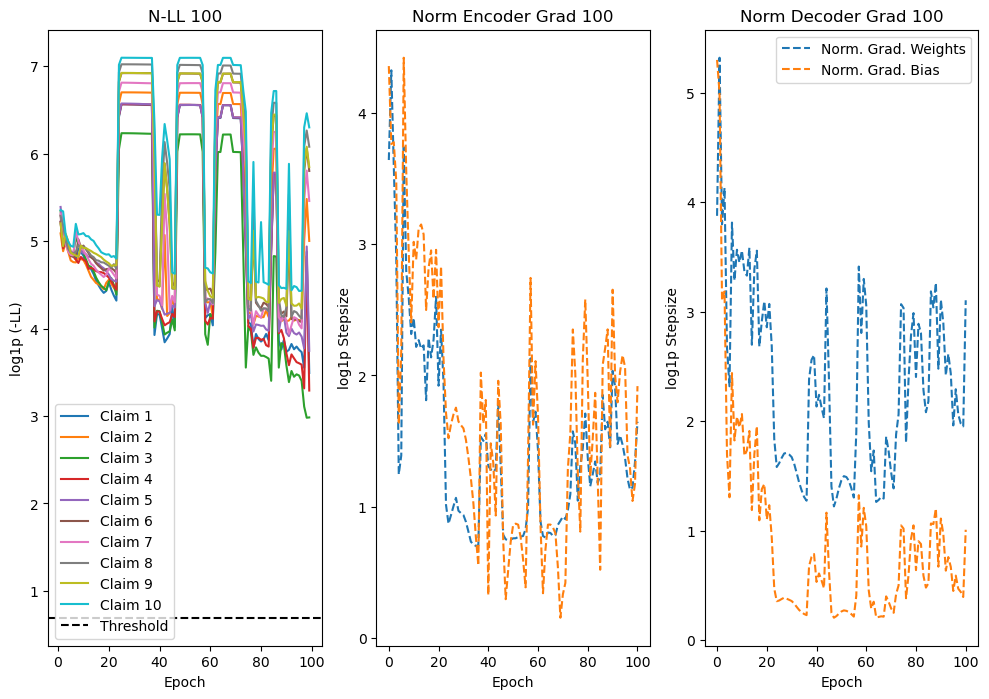

Claim 0: <|endoftext|>Experience with with with with with<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience with with with with with with<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull dull dull dull dull<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Echievechievechievechievechieve.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>E shine shine shine shine<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Feel the the the that that that that that<|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the the that that that that<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|endoftext|>Feel that that that that that that that<|endoftext|><|endoftext|><|endoftext|>
Claim 8: <|endoftext|>E with with with with with with with with with<|endoftext|>
Claim 9: <|endoftext|

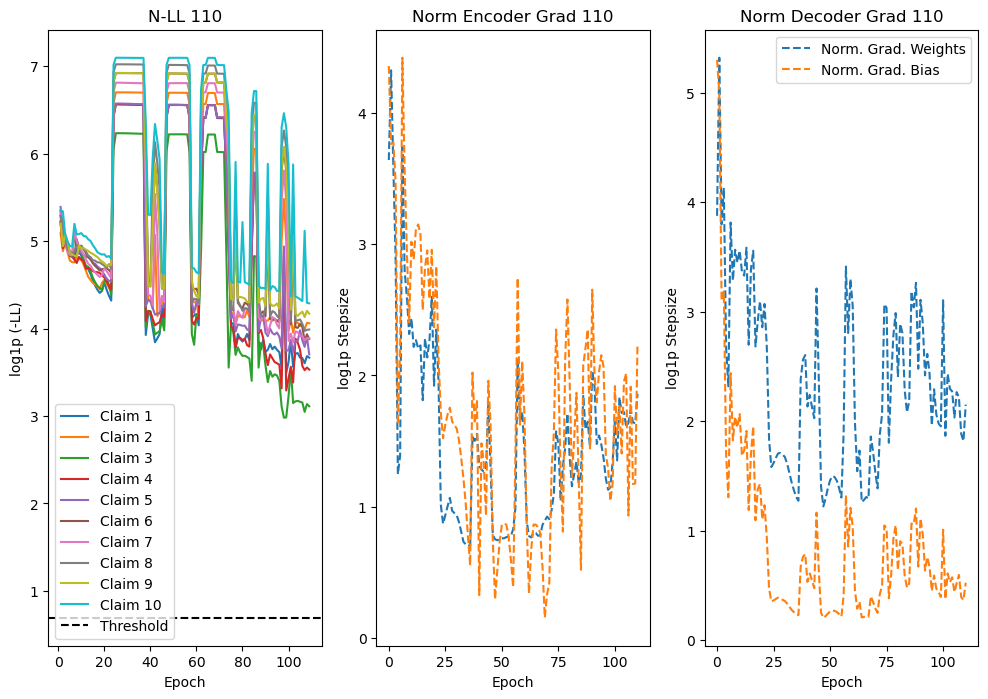

Claim 0: <|endoftext|>Experience radiant radiant radiant radiant with.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>E with with with with with with with with with<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Experience dull dull dull dull dull dull<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Echievechievechieve.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Elikelike with with with with with<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Experience the the the hair of hair hair hair<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the hair of hair of hair

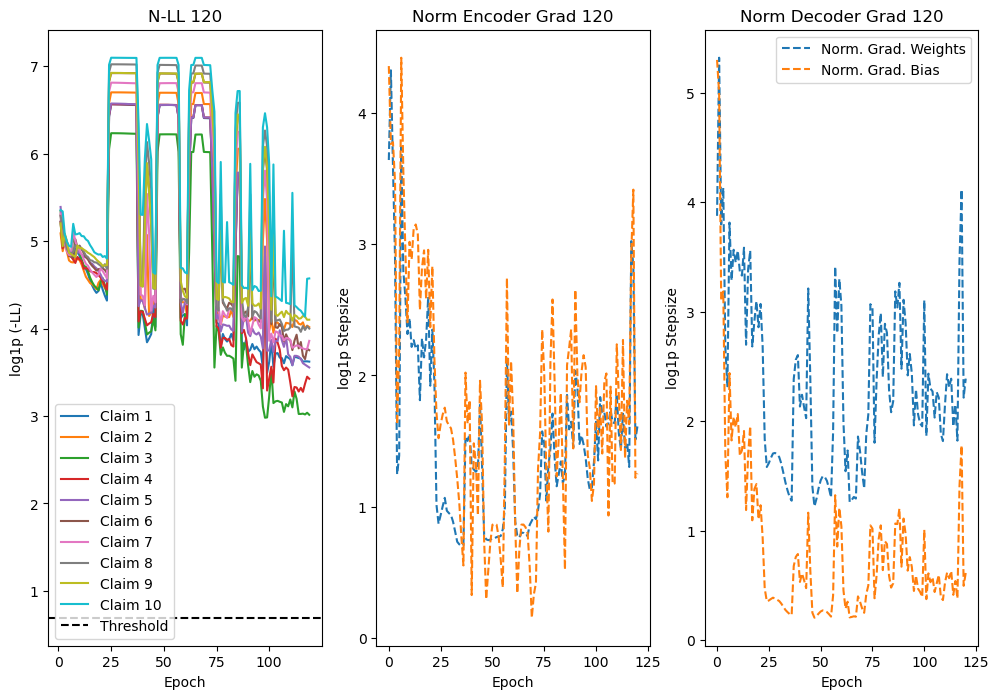

Claim 0: <|endoftext|>E radiant with with with with with<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>E radiant with with with with with<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Experience radiant radiant locks locks locks locks locks<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>A salon salon salon salon salon salon<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Echieve shine shine shine shine shine<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Feelbrace the that that that that that that that<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Feel the the that of that that that that that<|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|endoftext|>Feelbrace that that that that that that hair that hair that<|endoftext|

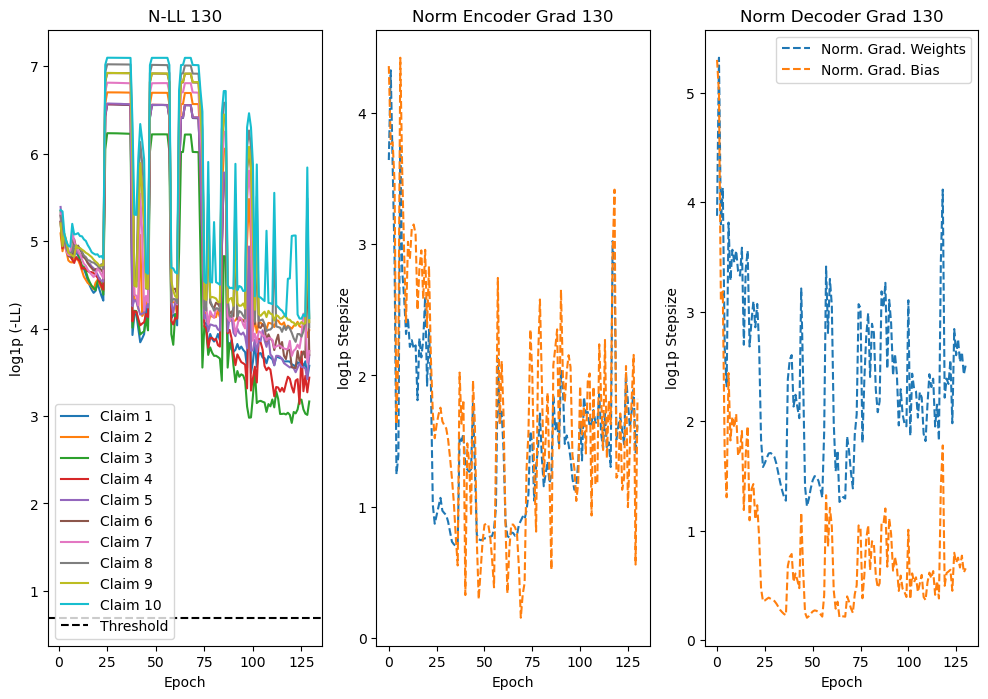

Claim 0: <|endoftext|>Experience every with with with with with with<|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience every with with with with with with<|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Experience dull dull dull dull<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Aqualityqualityquality..<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance dull dull with with<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Feel the the that that that that<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the the of of of of of<|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|endoftext|>Feel the the that that that that<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 8: <|endoftext|>Elike with with with with with with with with<|endoftext|>
Claim 9: <|endoftext|>Feel the the t

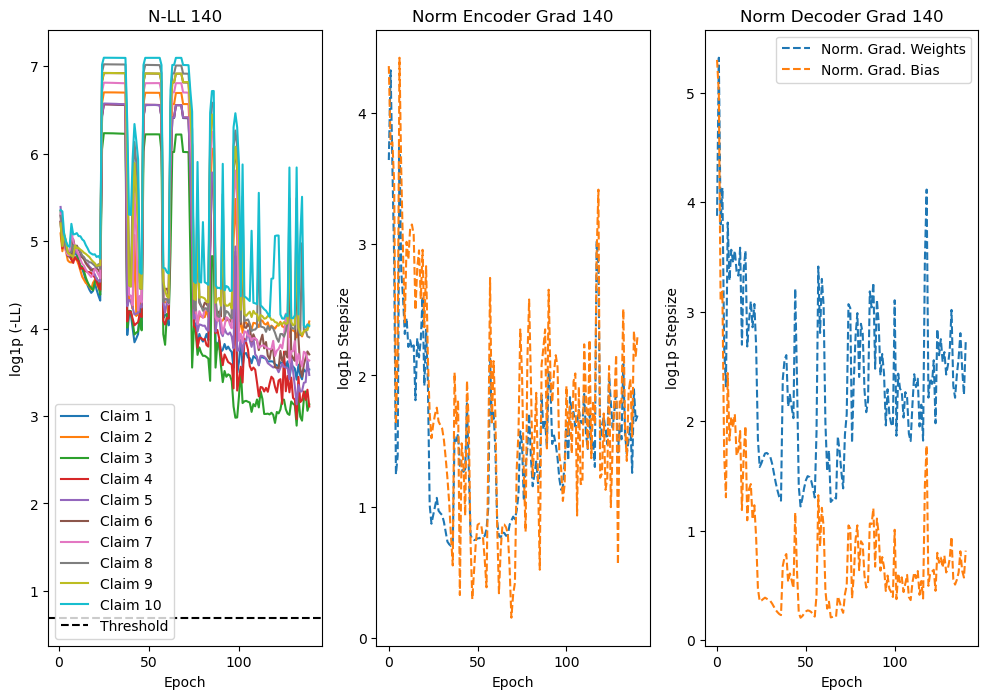

Claim 0: <|endoftext|>E radiant radiant with with with with<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience every with with with with with with<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Experience dull radiant radiant<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Aquality salon salon salon salon salon salon<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Elikelike with with shine with shine<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Experiencebrace the confidence of that hair hair hair hair<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Exp

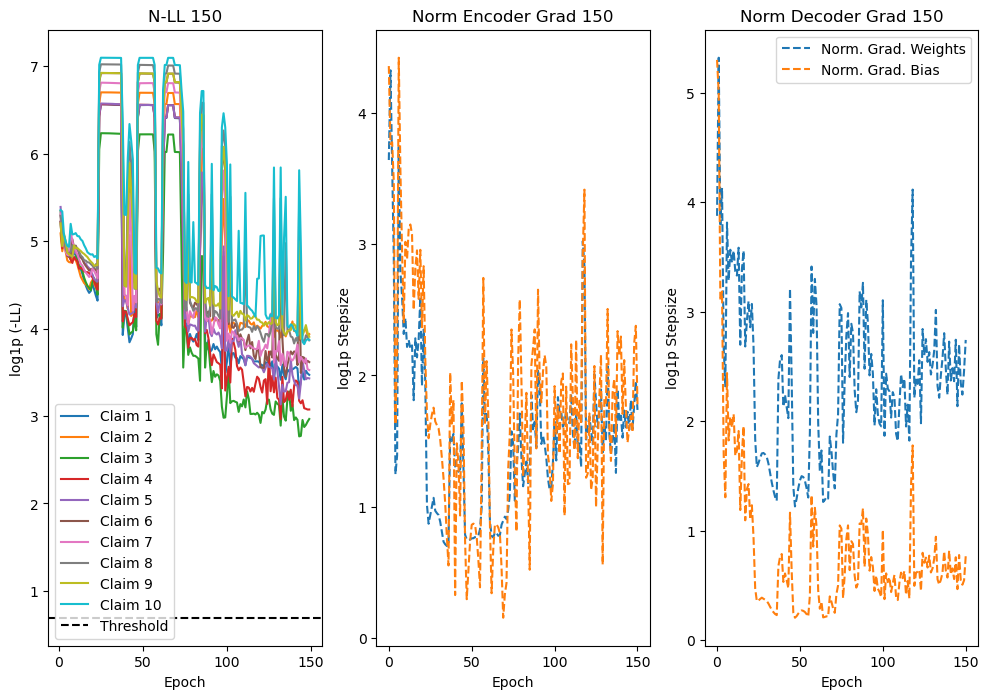

Claim 0: <|endoftext|>Experience dazzling radiant radiant radiant....<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience every hair hair. hair..<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Experience hair hair hair hair hair hair hair hair<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achievechievechieve.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Elevance shine shine shine shine shine<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Embrace confidence of confidence of that hair that.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the hair of hair of hair hair hair<|endoftext|><|endofte

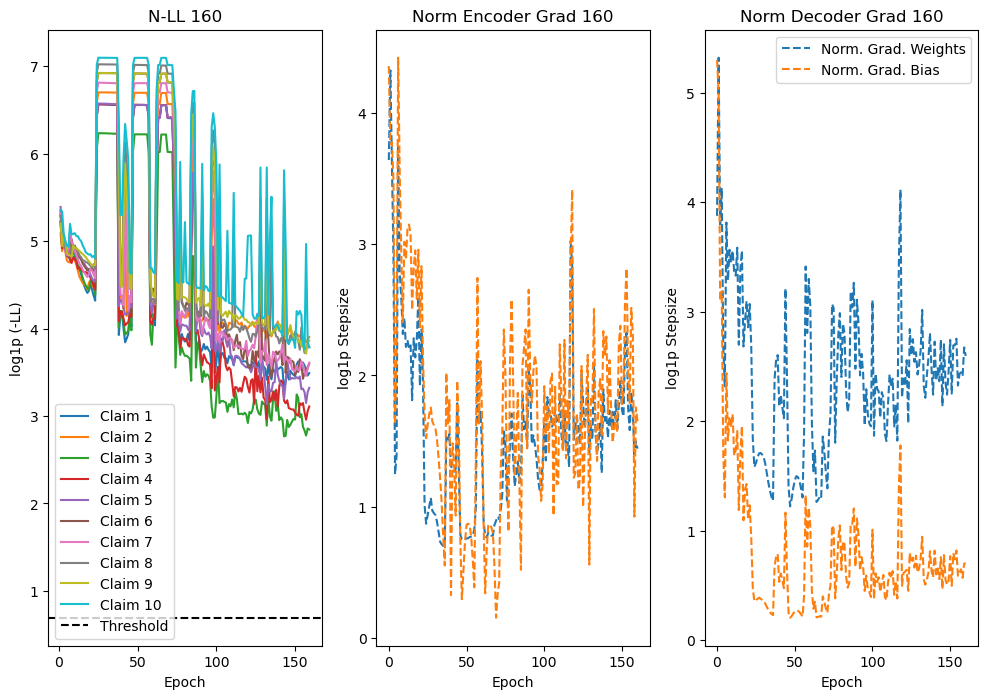

Claim 0: <|endoftext|>Experience mirror mirror with with with with.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience your mirror mirror with with with.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Experience dull strands strands strands locks<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon salon salon salon salon salon<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance salon salon salon with shine.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Embrace the heads of heads of heads. turns turns. turns.<|endoftext|>
Claim 6: <|endoftext|>Experience the the hair of hair hair hair<|endoftext|><|endoftext|><|endoft

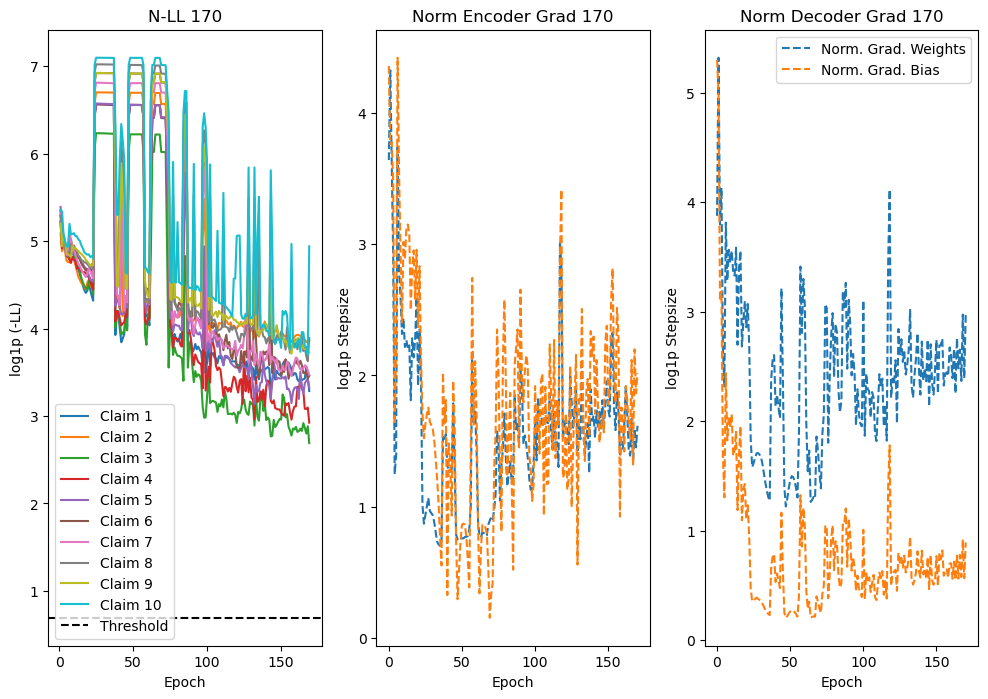

Claim 0: <|endoftext|>Experience dazzling radiant radiant radiant radiant..<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience every hair with with with with.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Experience dull dull strands locks<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achievechievechievequality home home<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance dull everyday everyday everyday.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Embrace the confidence of of of that that that that....
Claim 6: <|endoftext|>Experience the the of of of hair of hair. hair.<|endoftext|>

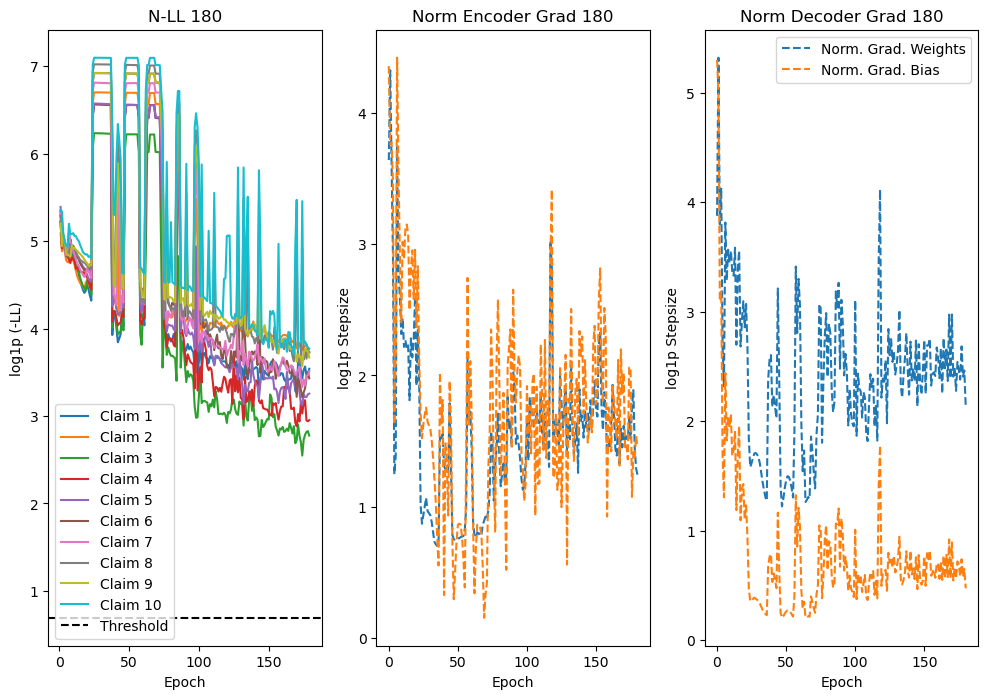

Claim 0: <|endoftext|>Experience mirror mirror with with with with with<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling with with with with with with.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Experience dull dull into into into.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achievequalityqualityqualityquality.quality....<|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhanceance shine shine shine shine shine shine<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Embrace the confidence of of of that that heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the the of of of of of hair.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|endoftext|>Experiencelock the confidence of of of of of that that<|endoftext|><|endoftext|><|end

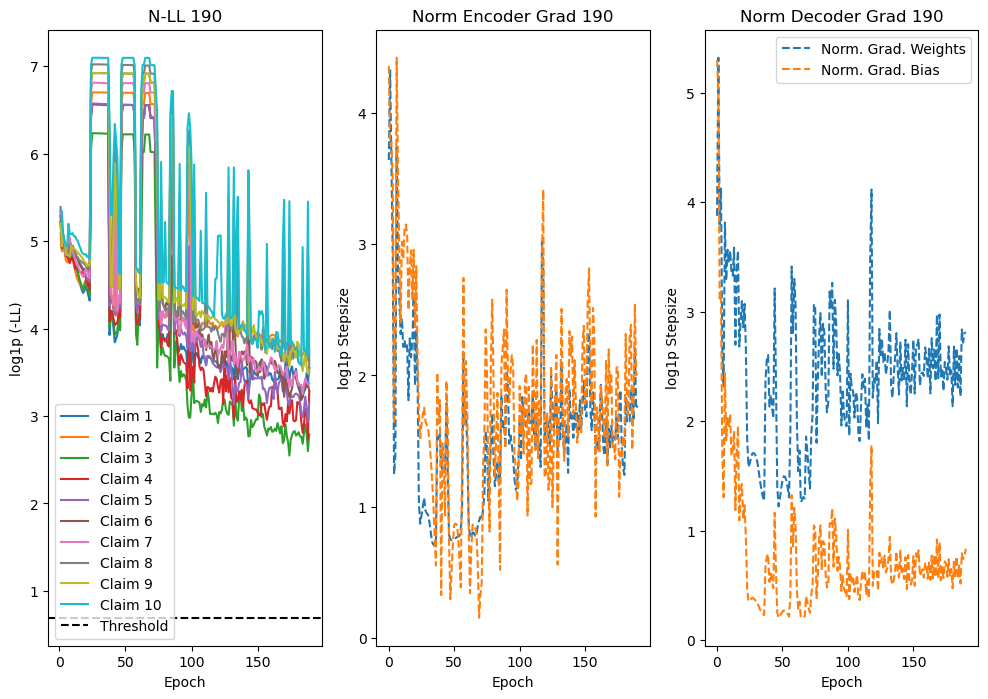

Claim 0: <|endoftext|>Experience dazzling with with with with with with.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling with your hair...<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Experience dull dull into into into.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achievequality advanced advanced advanced advanced<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Achieve-----.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Emlock the of of of that that that that that<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the the of of of of that that that<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|endoftext|>Experience the of of of of of that that that tha

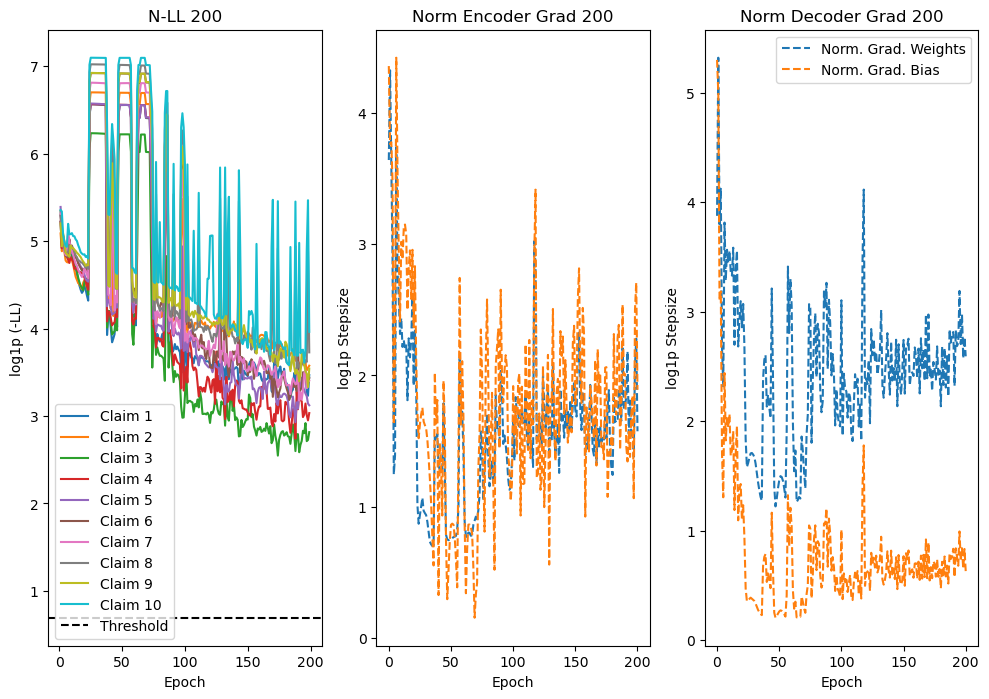

Claim 0: <|endoftext|>Experience mirror mirror with with with with.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling hair hair. hair. hair.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Experience dull strands strands strands. locks<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon salon salon<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural with with with.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Emlock the confidence of of of that that that<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the the of of of of of 

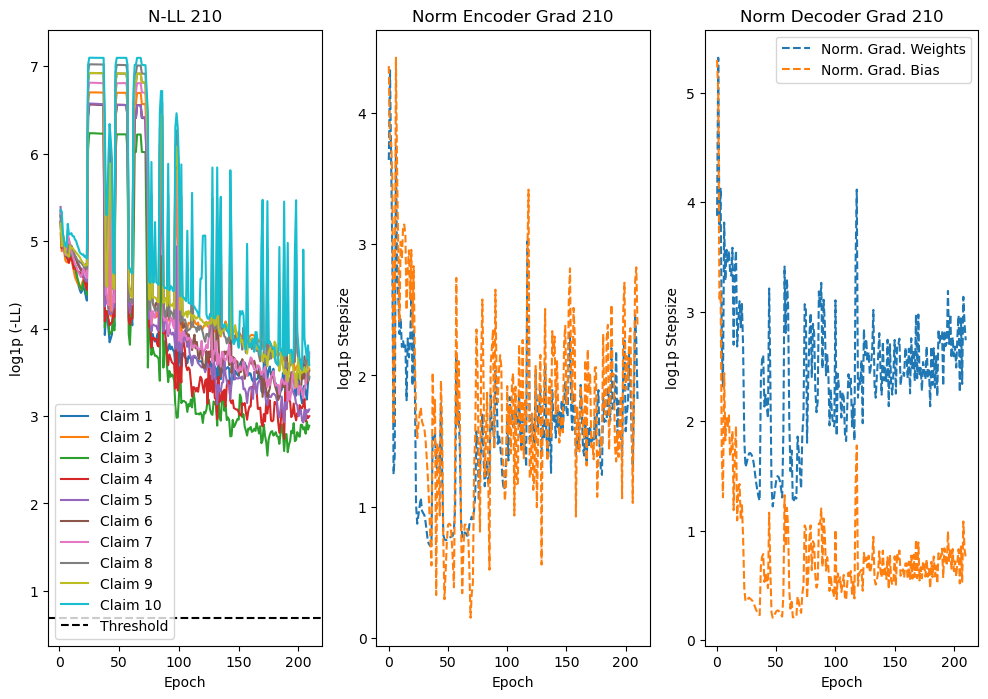

Claim 0: <|endoftext|>Get mirror mirror- every. your..<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling dazzling radiant radiant radiant, that.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull dull into into locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achievequality advanced advanced advanced advanced advanced<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural advanced advanced advanced advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Emlock the confidence of of of that that that that turns.<|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the the of of of ofams ofams<|endoftext|><|endoftext|><|endoftext|><|en

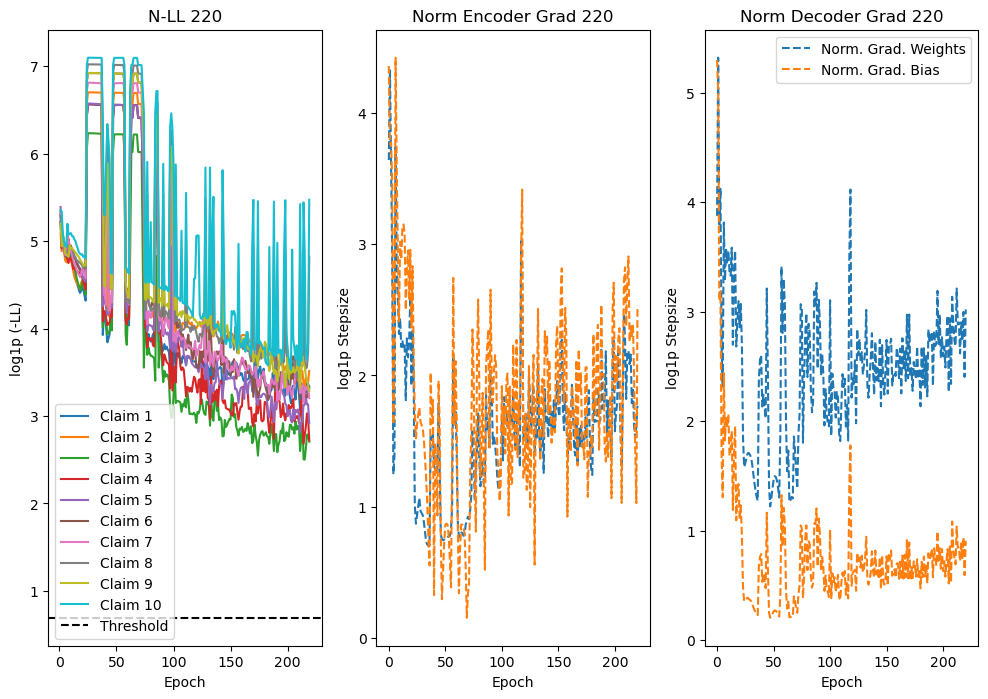

Claim 0: <|endoftext|>E mirror mirror mirror with with with with with<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling dazzling hair hair hair hair use one.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull dull into into into locks<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon salon salon salon.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural natural formula formula formula formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the the of of hair that heads heads. turns.<|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the rad hair of hair of hair that beauty.<|endoftext|><|endoftext|><|endoftext|><|endoftext|

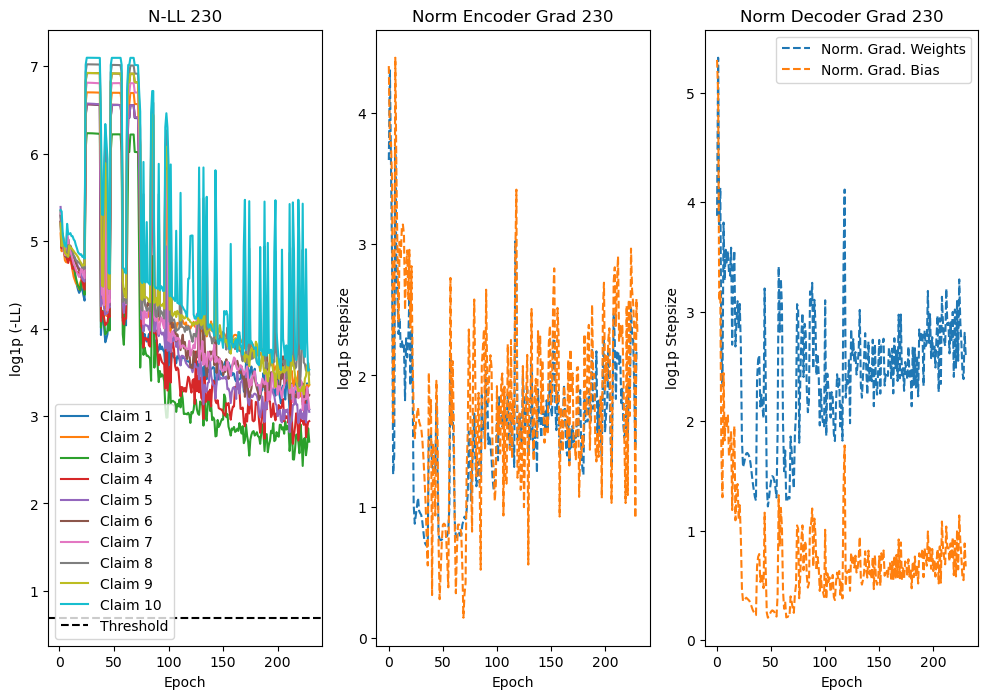

Claim 0: <|endoftext|>Experience mirrorlikelike-like-like<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling dazzling hair hair hair hair.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Experience dull strands into into strands<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achievechievequalityqualityquality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance----.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous luminous luminous<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair of gleams..<|endoftext|><|endof

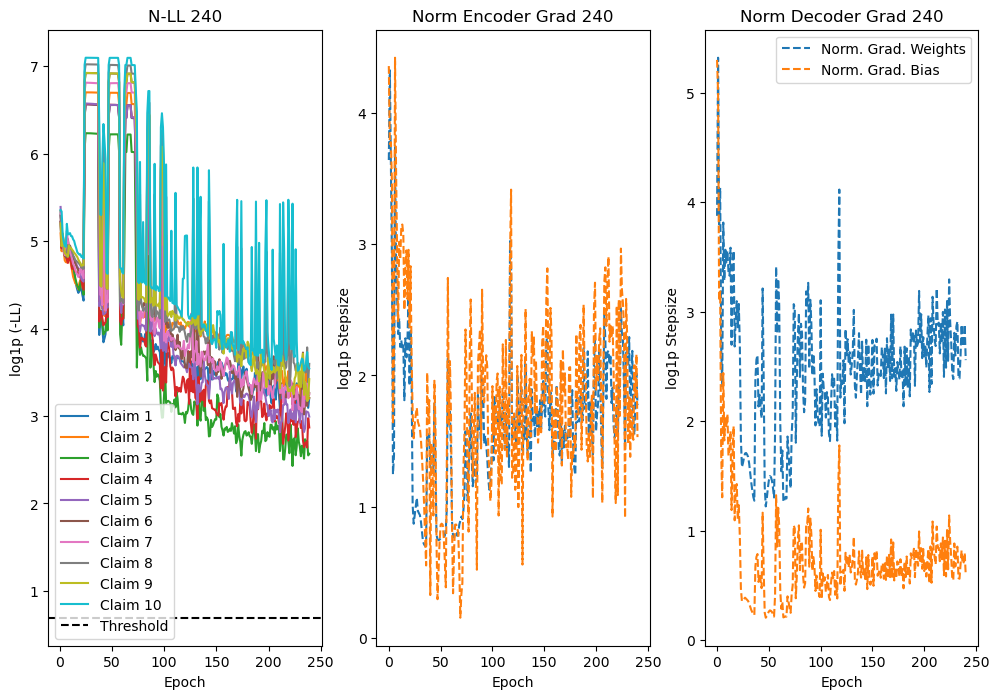

Claim 0: <|endoftext|>E mirrorlike your everyday with with with with<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling glossy glossy glossy glossy glossy.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull dull into locks..<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achievequalityqualityqualityqualityquality<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance shine shine shine shine.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Emlock the confidence of luminous luminous.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair hair that beauty.

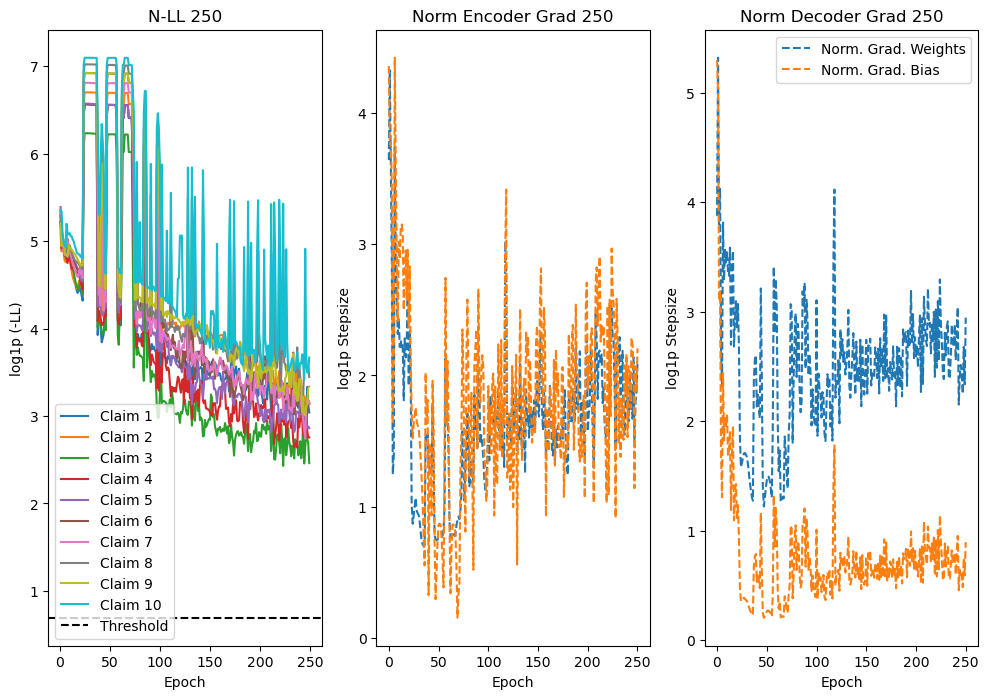

Claim 0: <|endoftext|>E mirror mirror- shine with shine shine radiant<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling radiant radiant hair hair use one..<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands strands into into locks<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural natural natural advanced advanced..<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of hair that hair that turns.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams..<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|endoftext|>Experience the radianceianceianceianceianceianceiance..

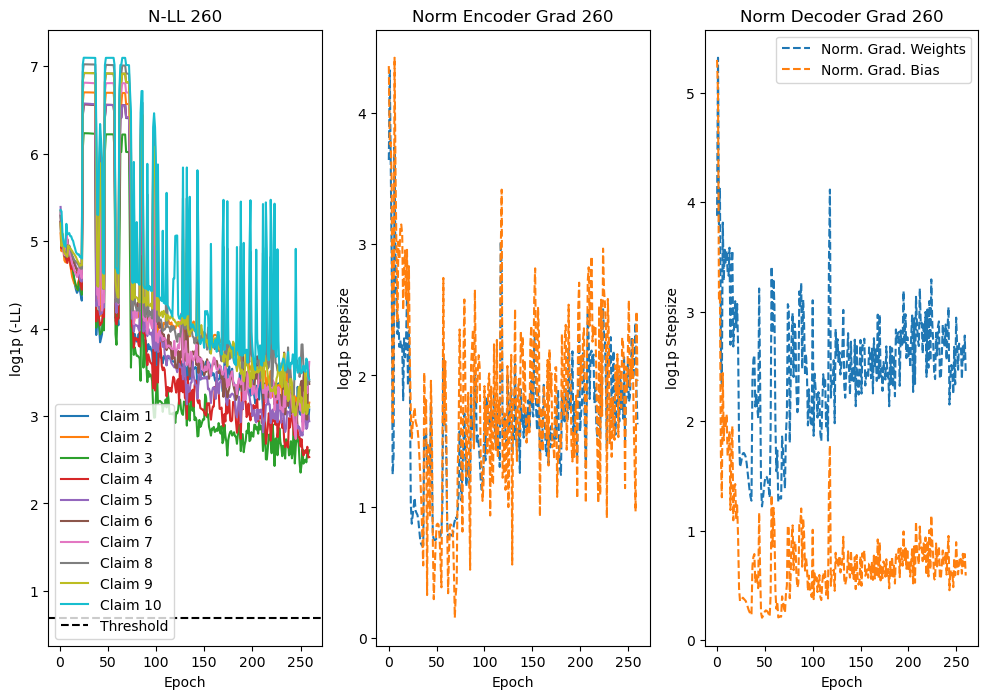

Claim 0: <|endoftext|>E mirrorlikelike with every use with with<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling hair hair hair hair hair one use..<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Experience dull into into locks locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality at.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural with with advanced advanced advanced advanced<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Embrace the confidence of of hair hair hair hair hair.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair hair that gleams.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Cl

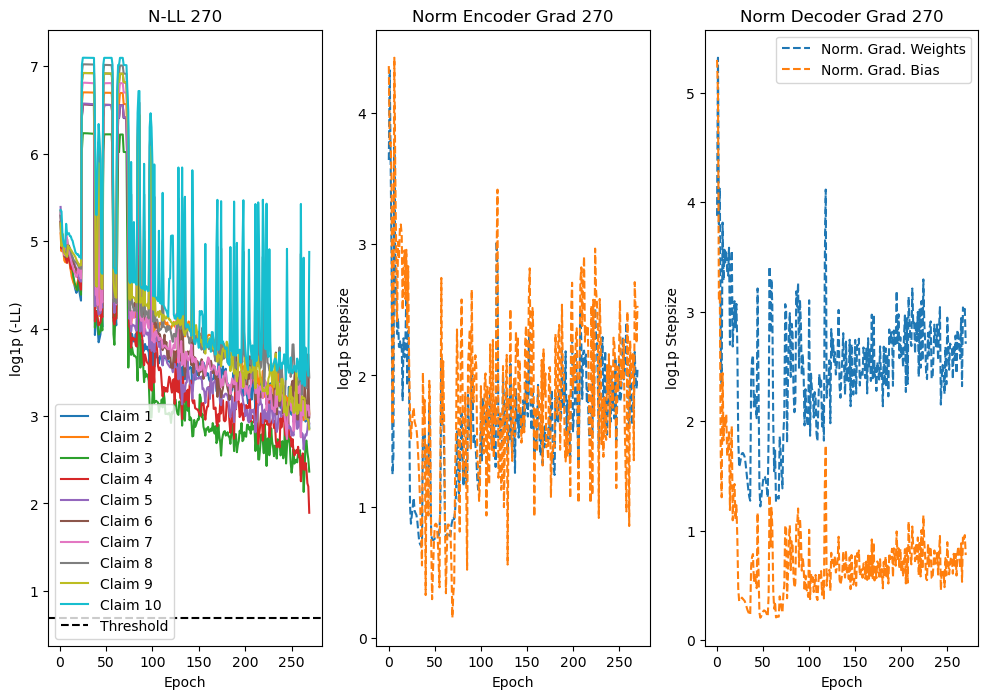

Claim 0: <|endoftext|>Experience mirrorlike-like-like.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling dazzling hair hair hair hair one...<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into strands..<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine shine home<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance brilliance brilliance brilliance our brilliance.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous heads. turns..<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair hairams hairams...<|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|endoftext|

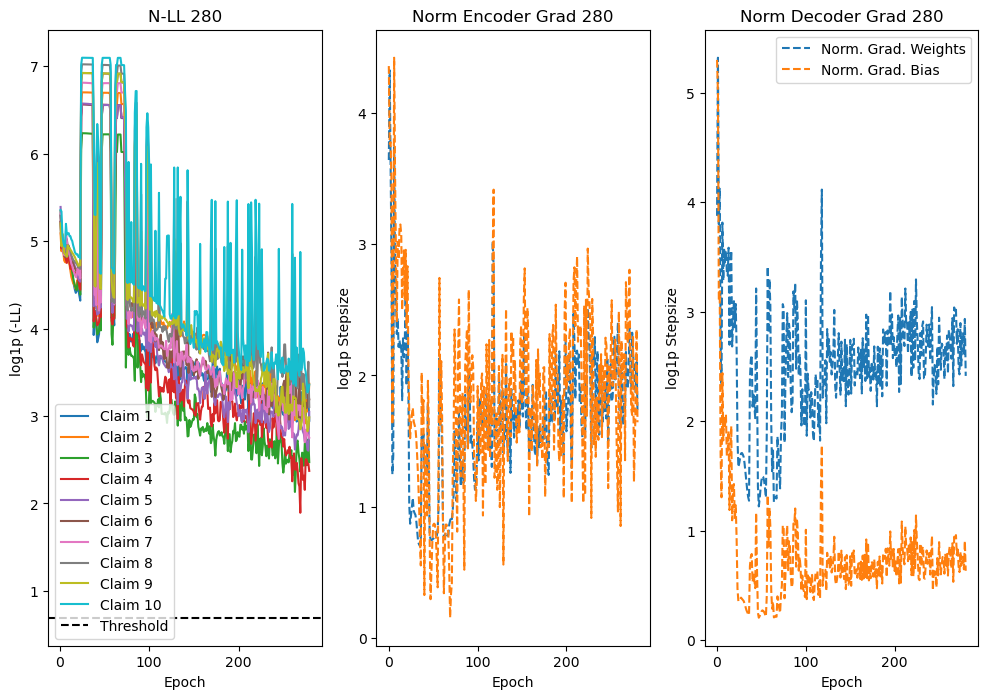

Claim 0: <|endoftext|>Experience mirror-like-----.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling radiant radiant hair just just just use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant into radiant<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance shine shine shine our shine<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Emlocklock the confidence of hair hair that hair hair.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the rad hair that hair that gleams.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>


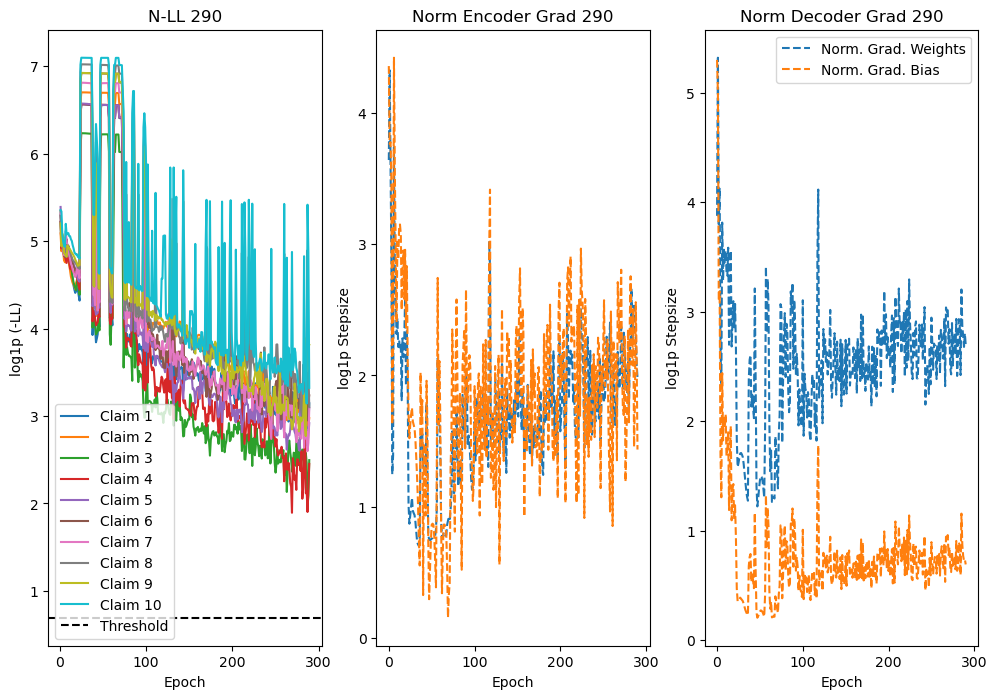

Claim 0: <|endoftext|>Experience mirror shine shine shine radiant radiant.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling dazzling glossy hair with just use.<|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into locks locks<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with brilliance..<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Embrace the confidence of hairousousousous<|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Get the joy of hair withamsamsams..<|endoftext|>
Claim 7: <|endoftext|>Embrace theianceianceianceianceiance that reflects.<|endoftext|>
Claim 8: <|endoftext|>Elevate your everyday with shine shines in shine in<|endoftext|>
Claim 9: <|endoftext|>Feel theureureureureureure. captiv<|endof

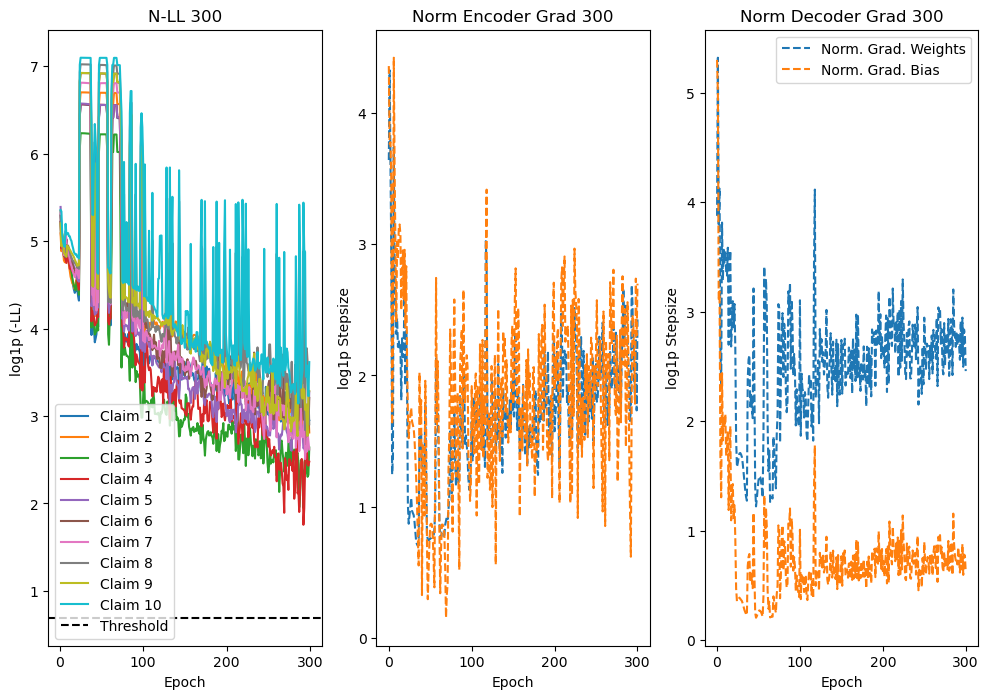

Claim 0: <|endoftext|>Experience mirror-----.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance salon with brilliance our formula<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Embrace the confidence of of of hair that hair turns turns.<|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams vitality..<|endoftext|><|endoftext|><|endoftext|

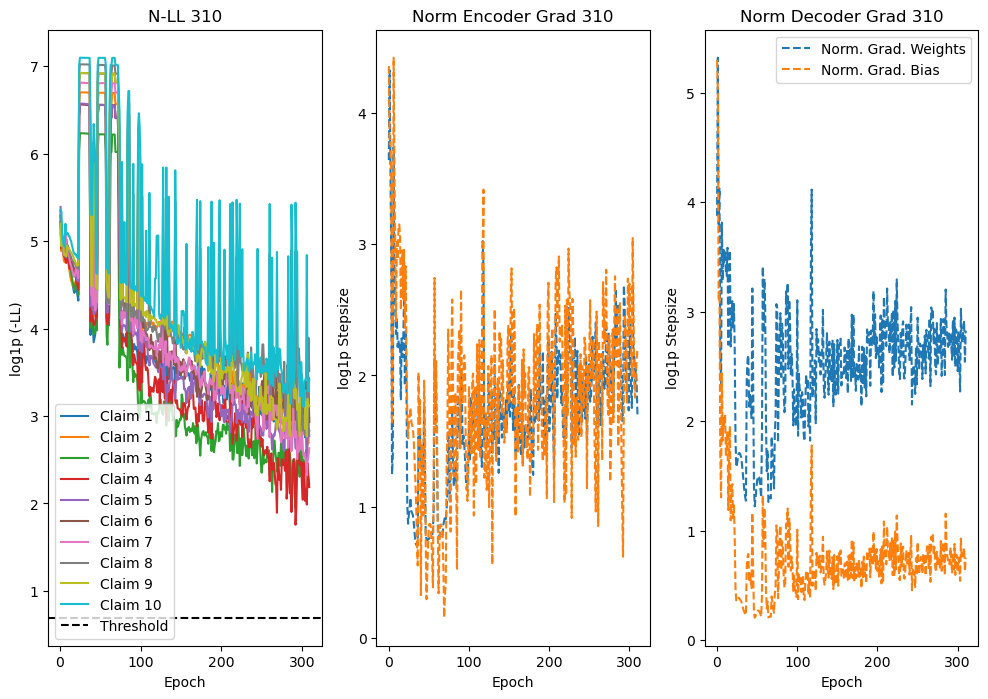

Claim 0: <|endoftext|>E mirrorlikelike shine with every every.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair just just one use<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into locks locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural natural with with with our formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlocklock the confidence of luminous...<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <

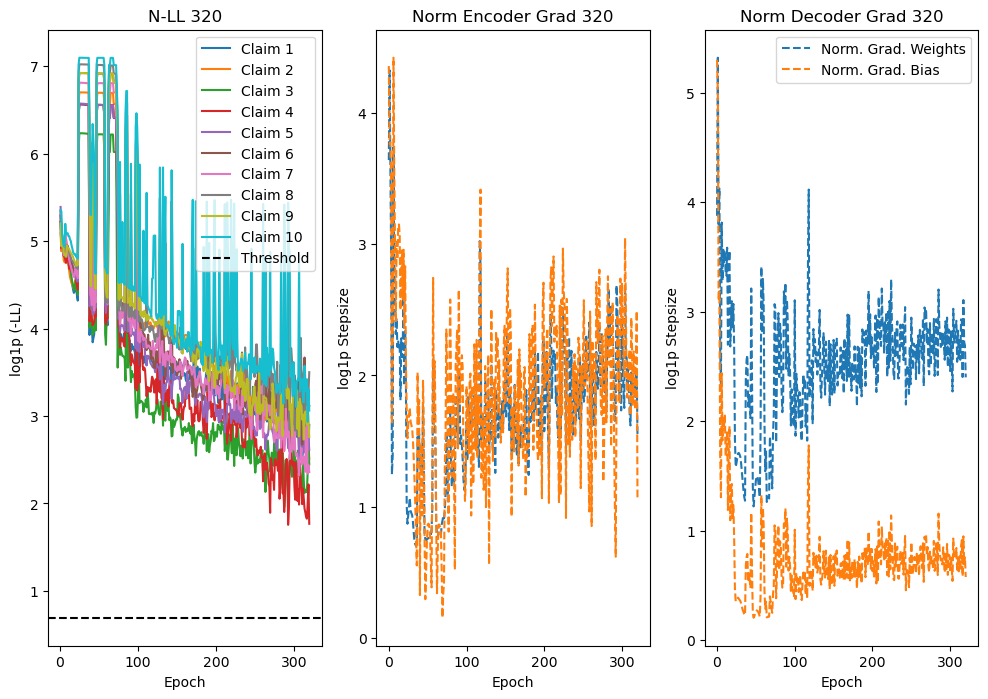

Claim 0: <|endoftext|>Experience mirror mirror- wash with wash wash<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair hair just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant into<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance brilliance with our advanced advanced.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous luminous heads that turns<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that hair that beauty..<|endoftext|><|endof

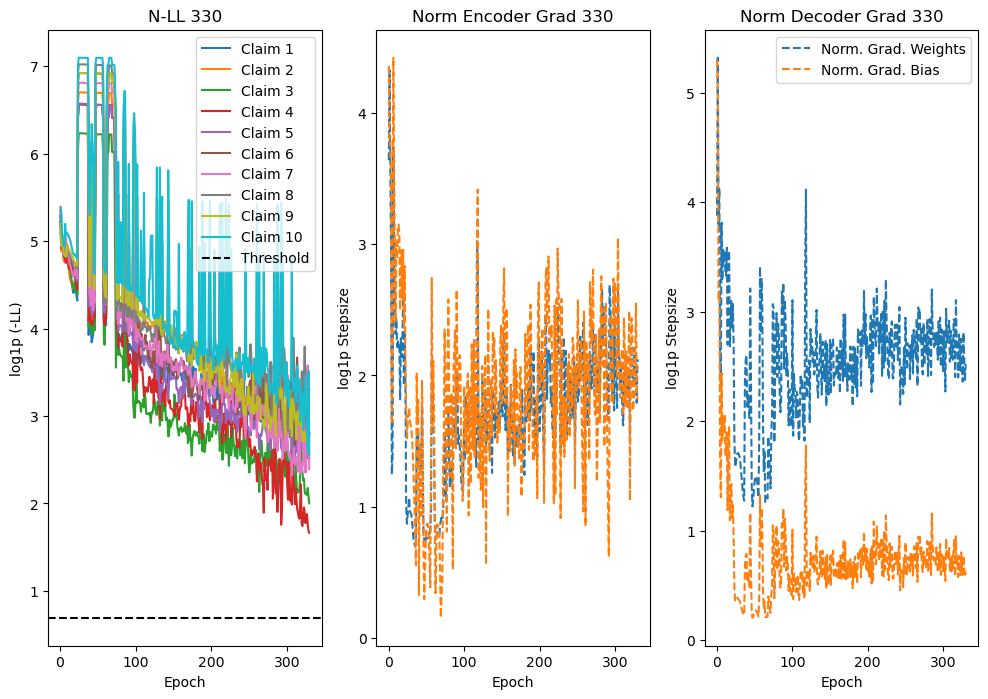

Claim 0: <|endoftext|>Experience mirrorlikelikelikelike- every.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair just just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull radiant locks radiant...<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance brilliance our brilliance.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Emlock the confidence of lumin heads that heads.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|endoftext|>Embrace the radiance of hair that reflects your inner inner<|endoft

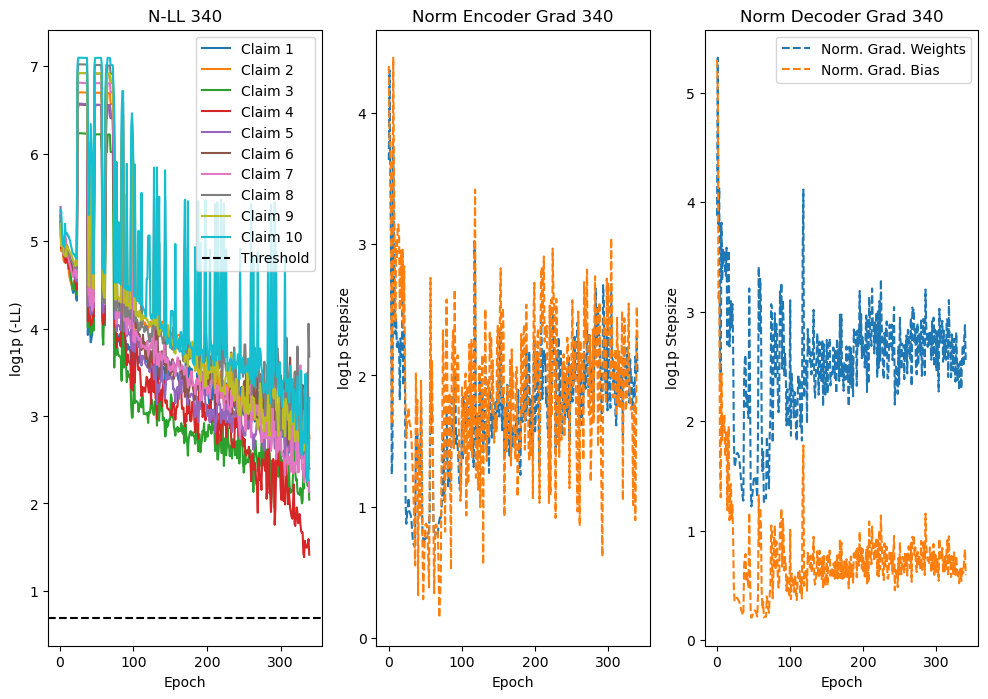

Claim 0: <|endoftext|>Transform mirrorlike shine with every every.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling glossy glossy hair, just one use<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural with with our our<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns turns<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with<|endoftext|><|endoftext|><|

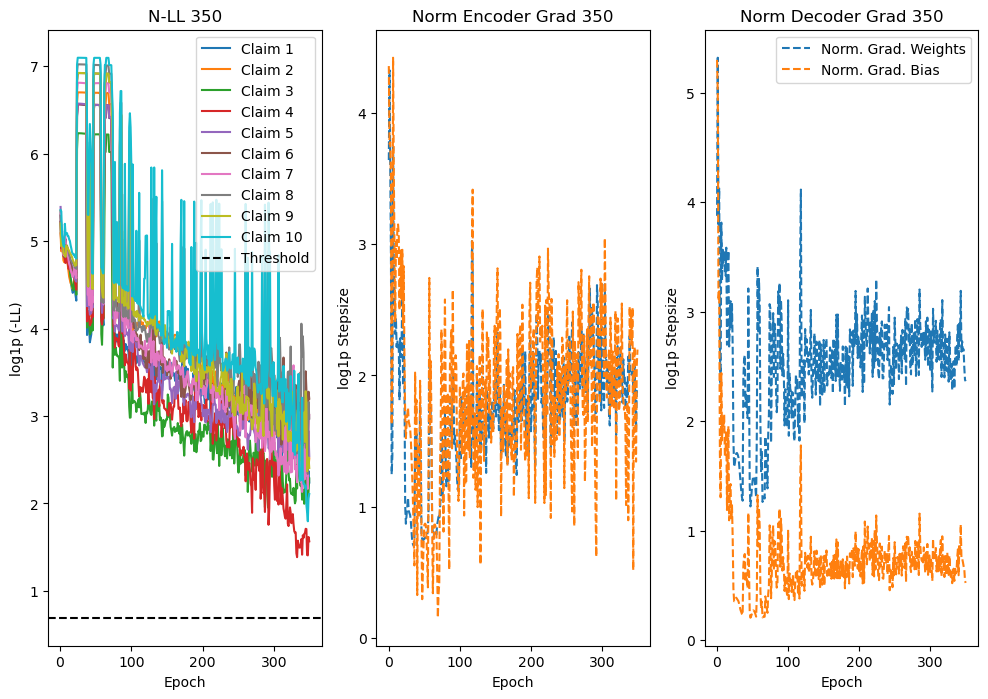

Claim 0: <|endoftext|>Experience mirror-like shine with every shine.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in one use one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant into locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced..<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Emlock the confidence of luminous hair that turns turns<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|endoftext|>E

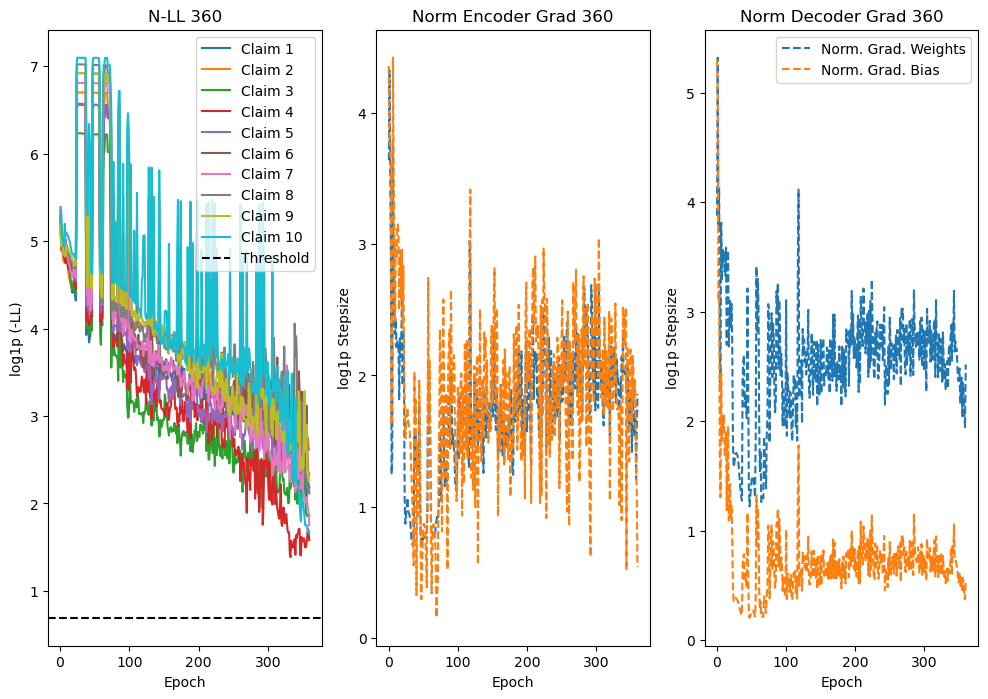

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in one use use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that hair that heads.<|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|endoftext|

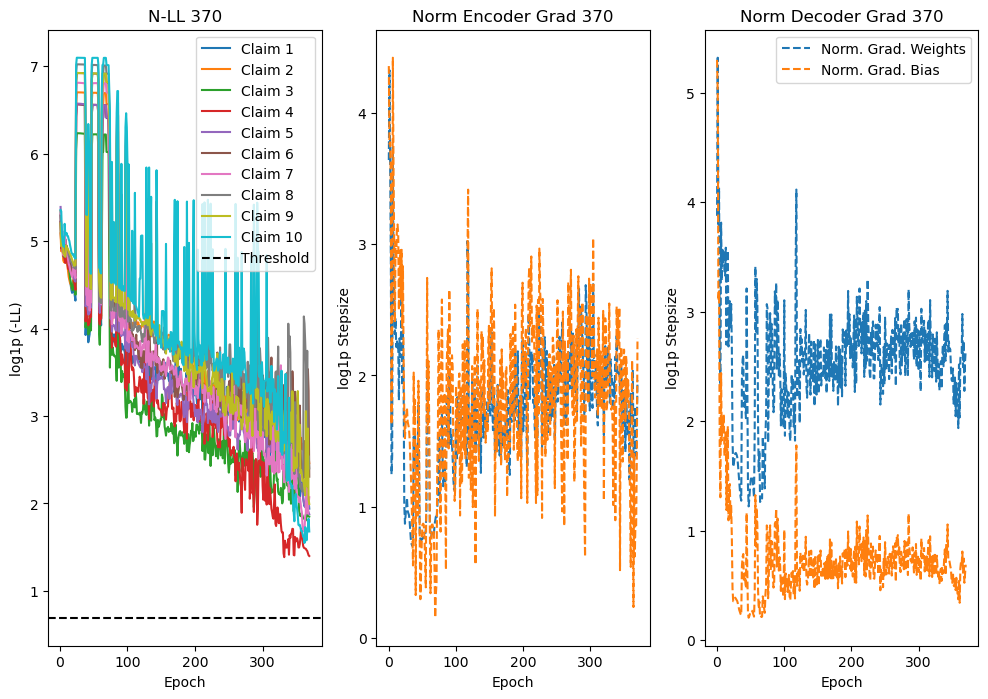

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Emlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
C

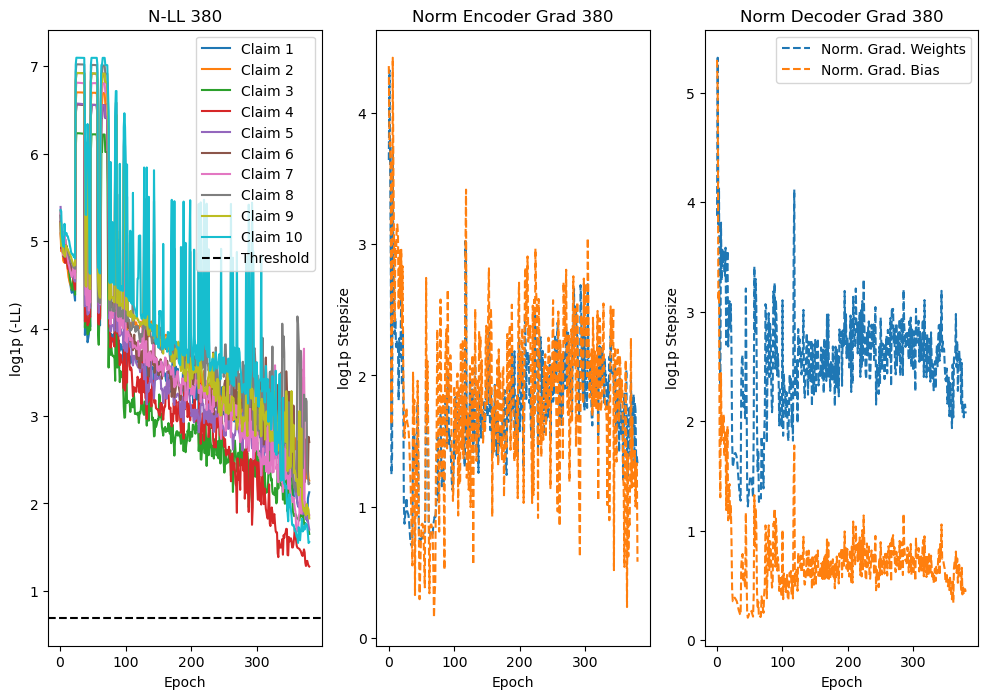

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Cla

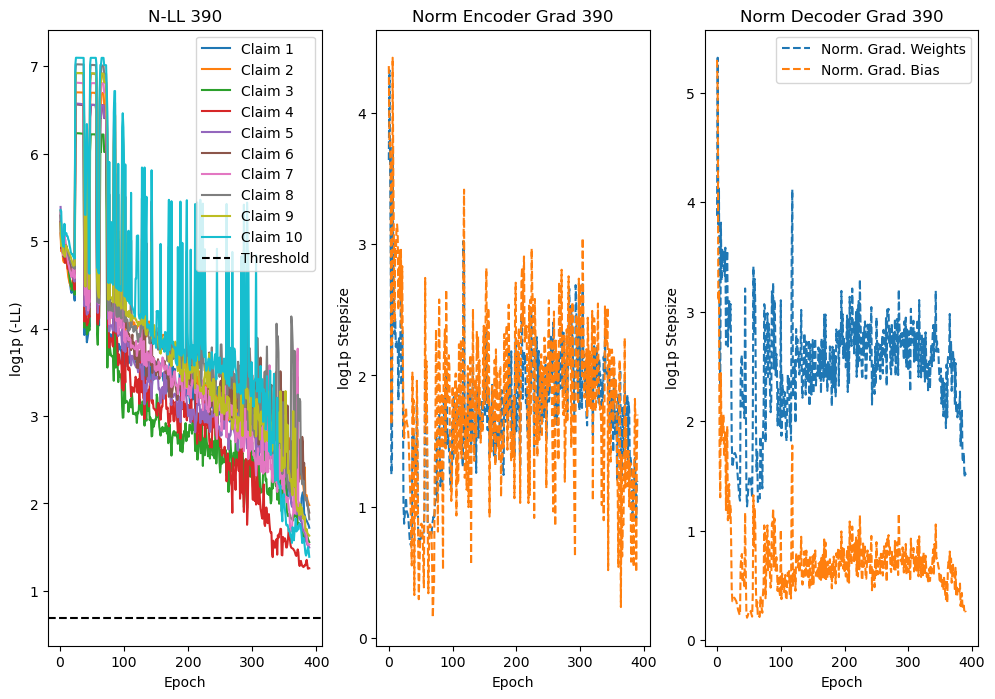

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

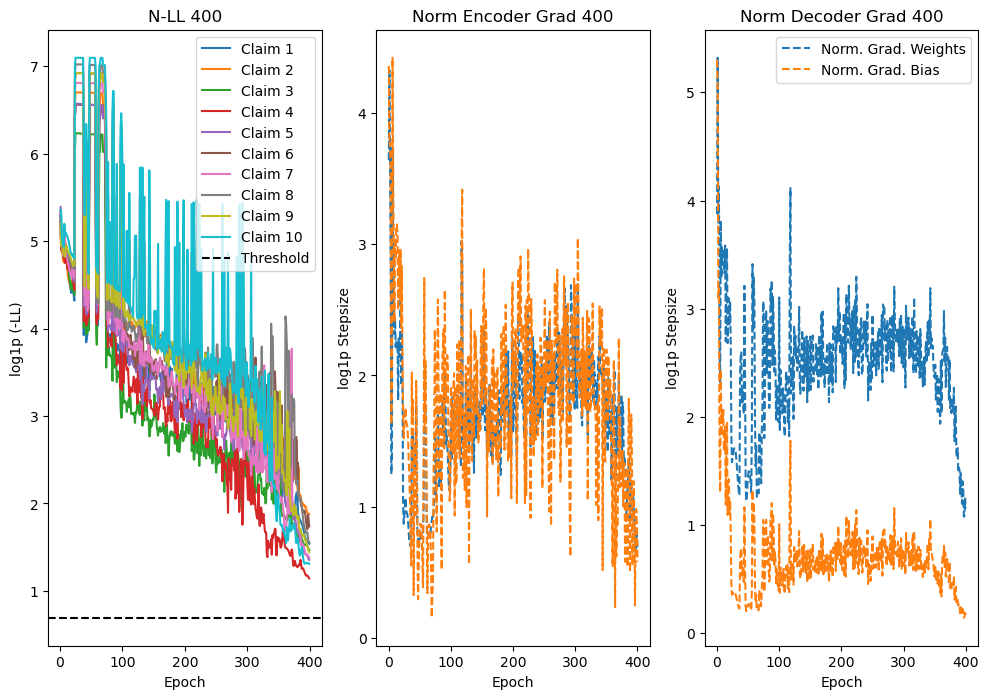

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Emlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

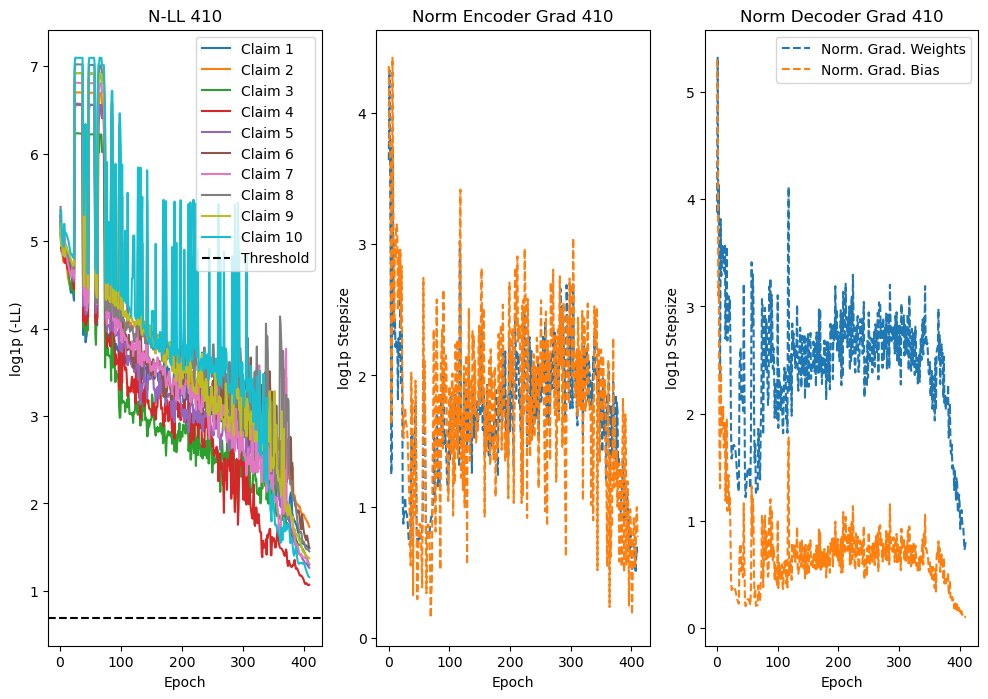

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

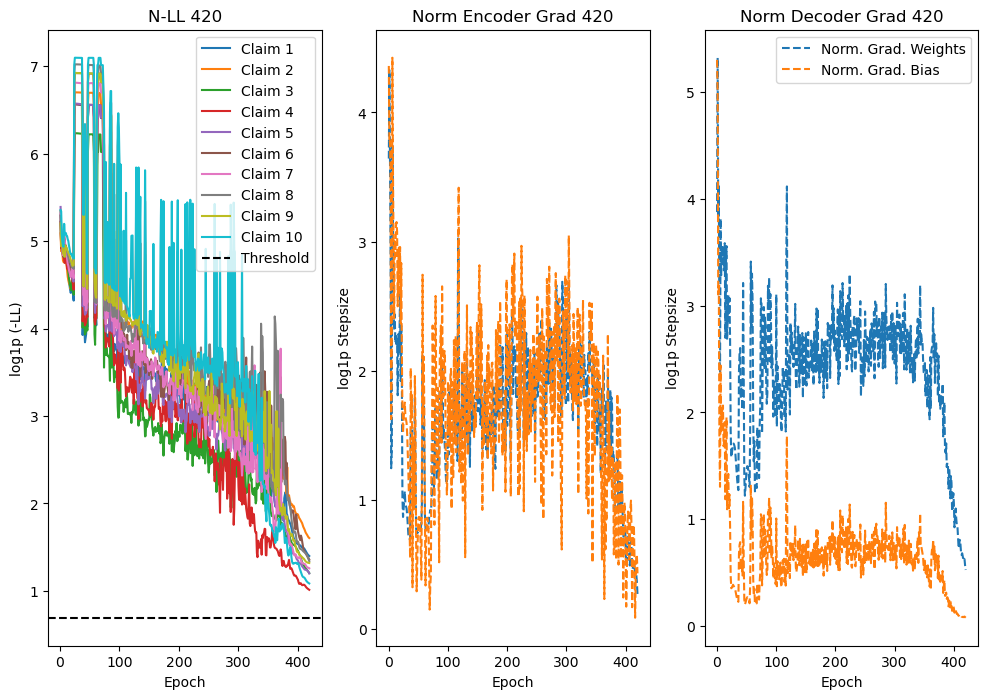

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

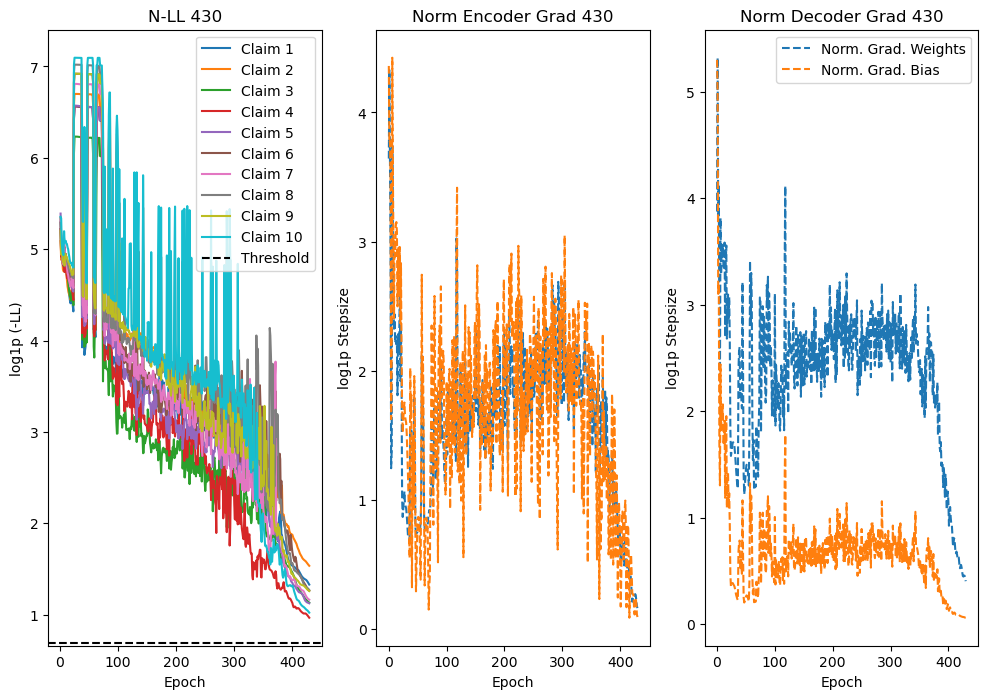

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

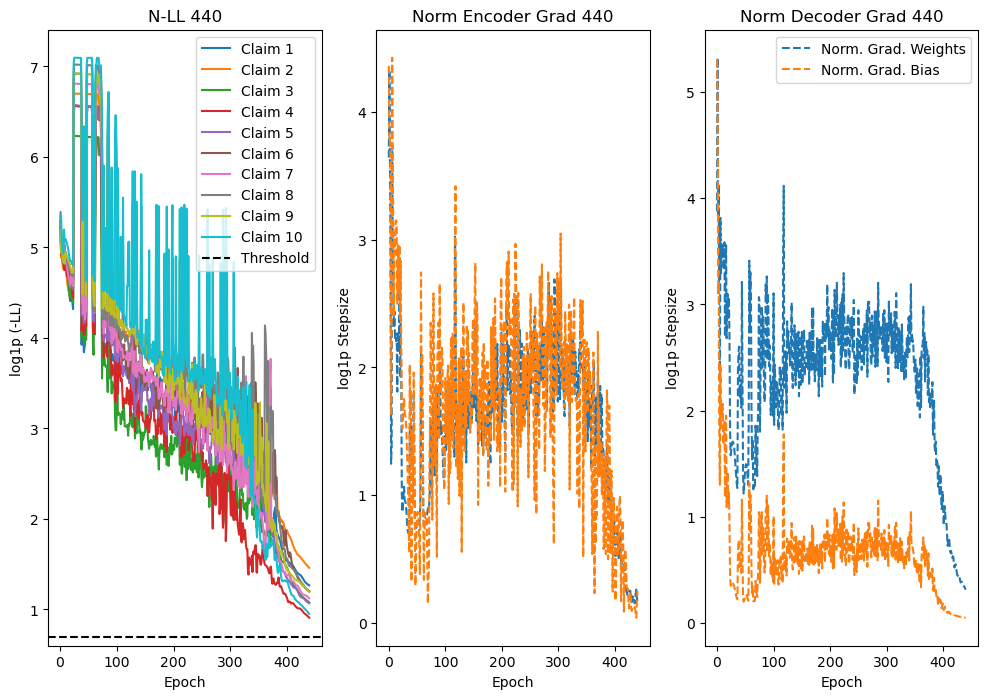

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

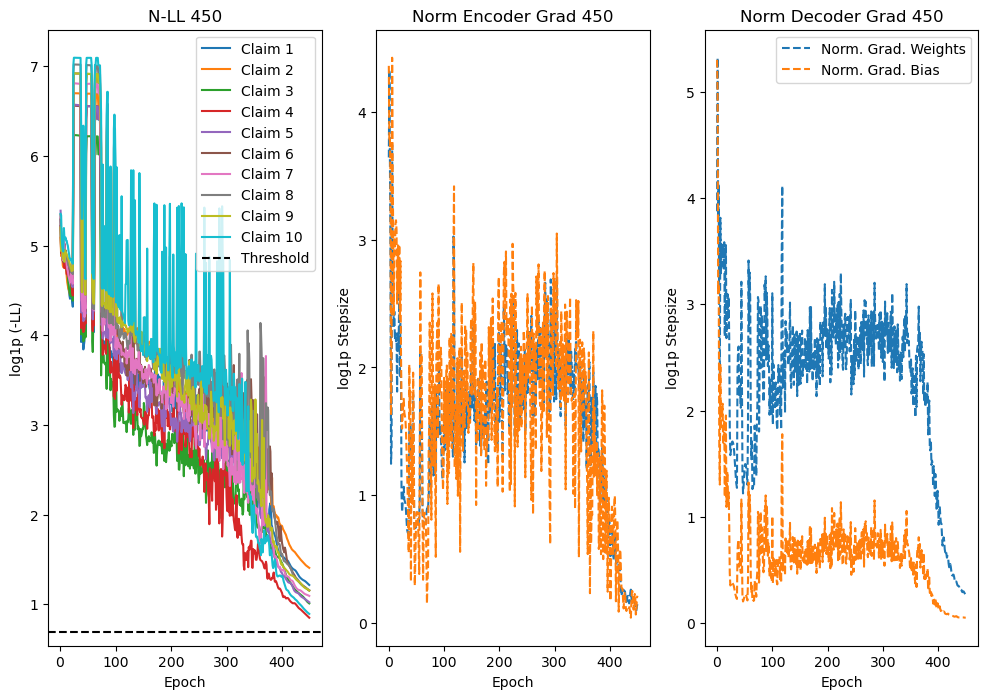

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

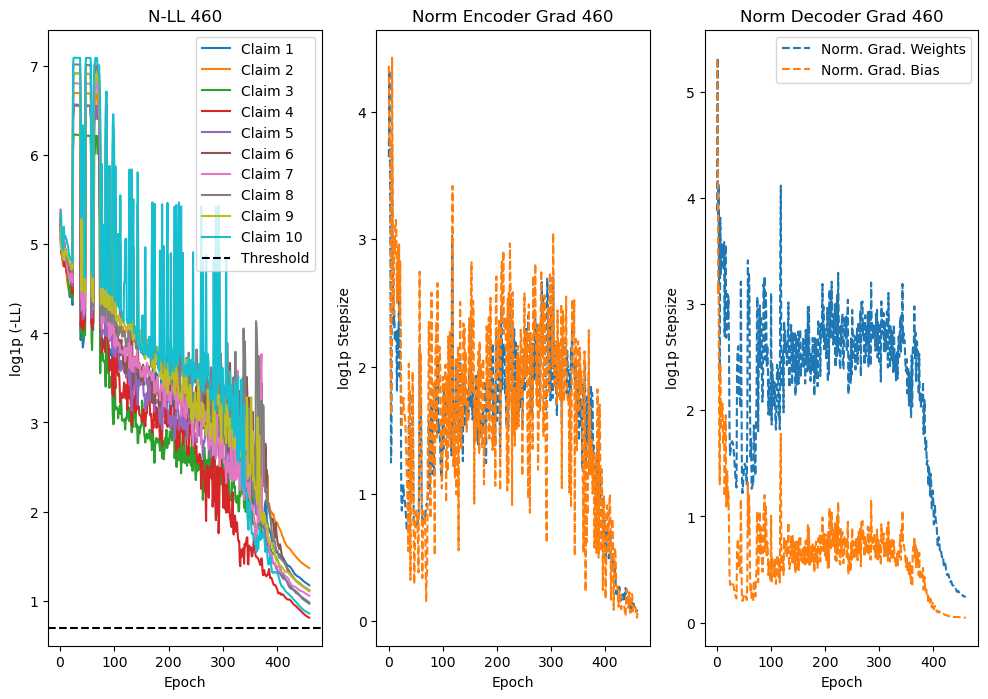

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

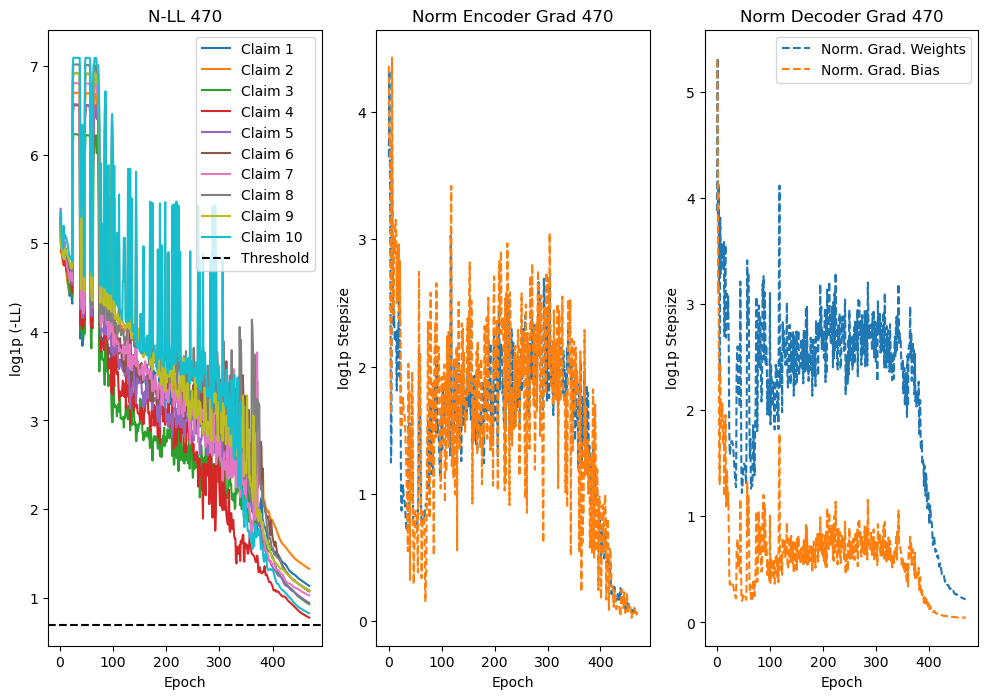

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

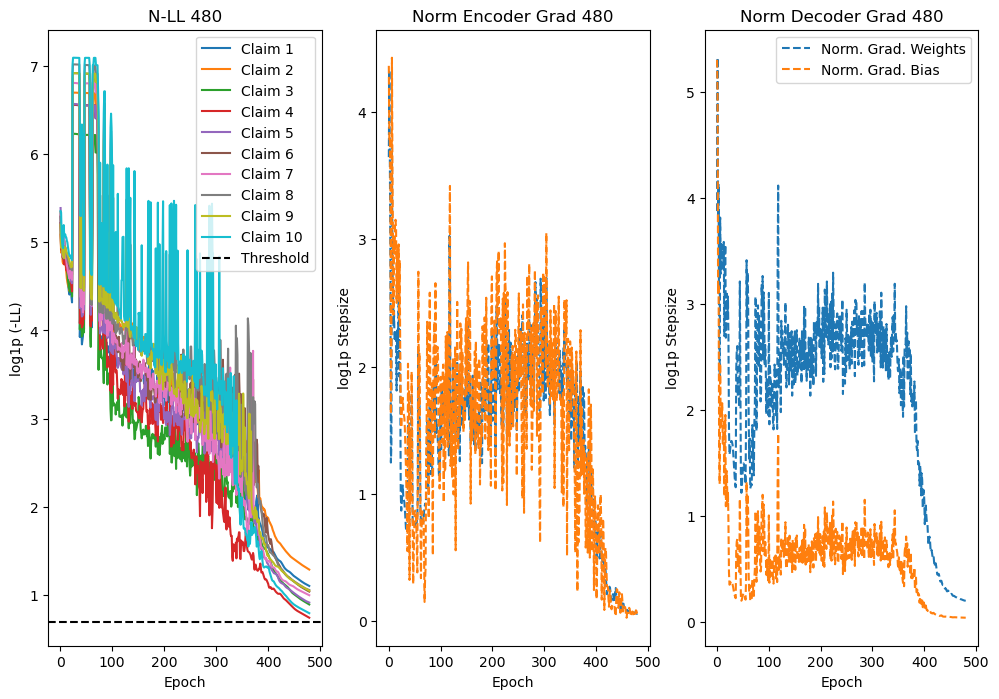

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

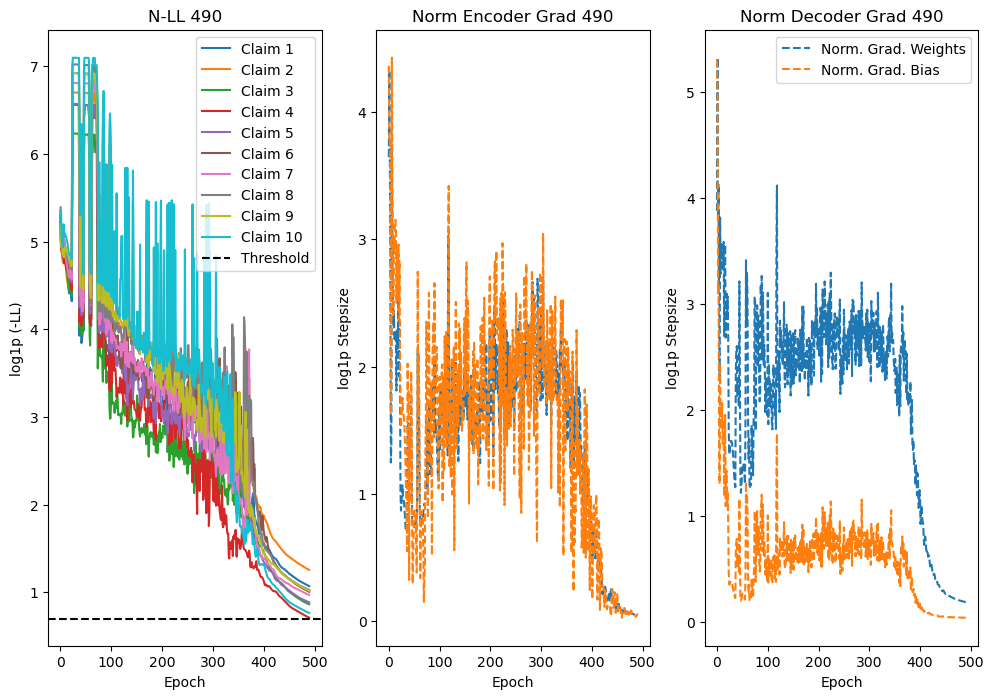

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

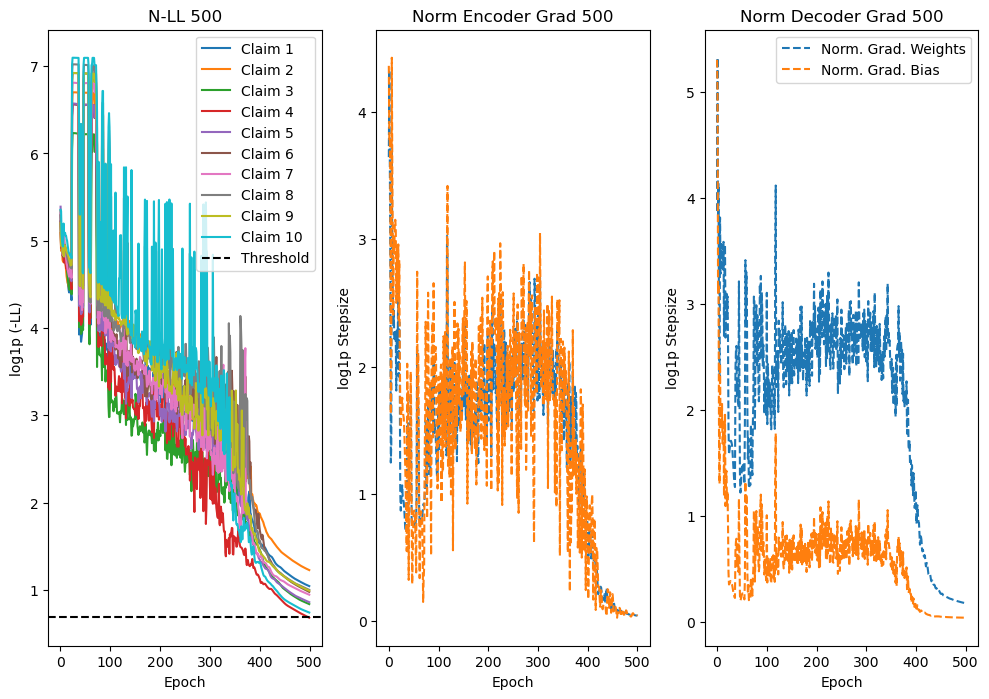

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

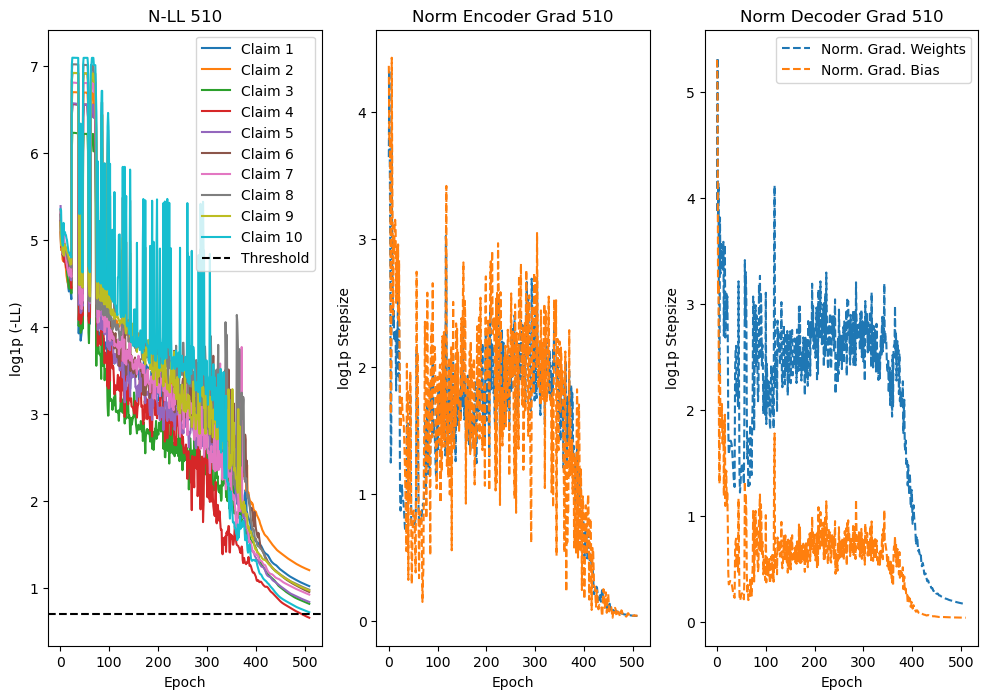

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

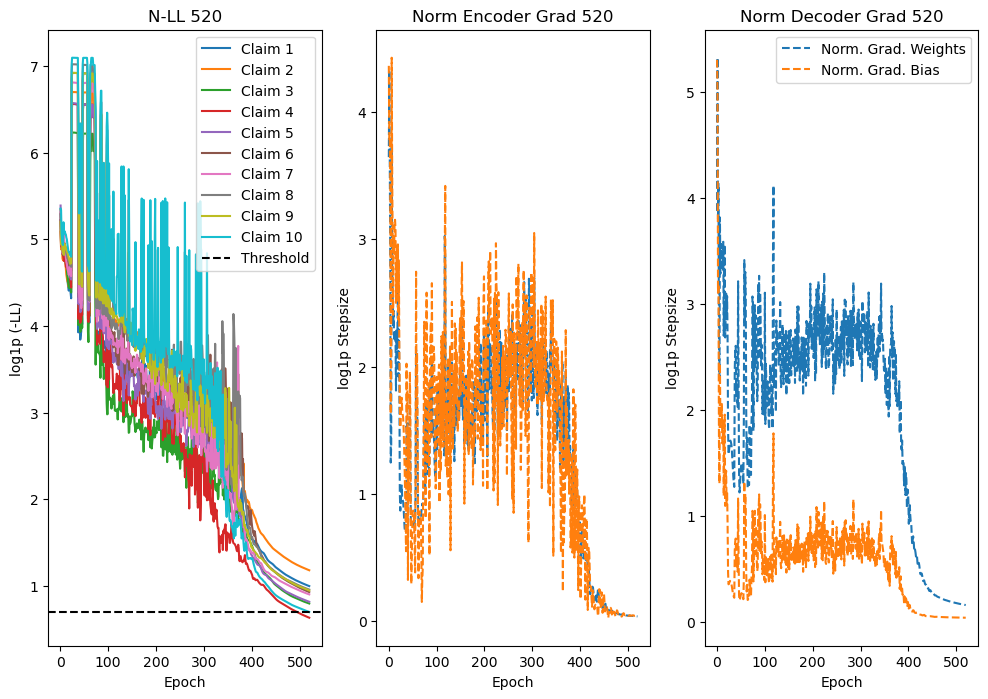

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

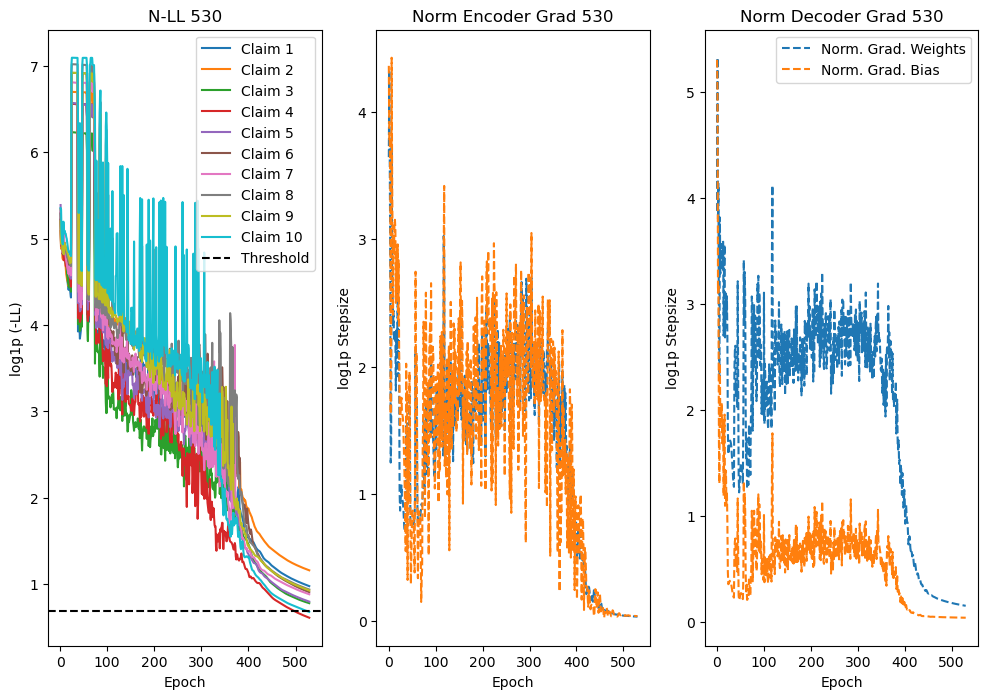

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

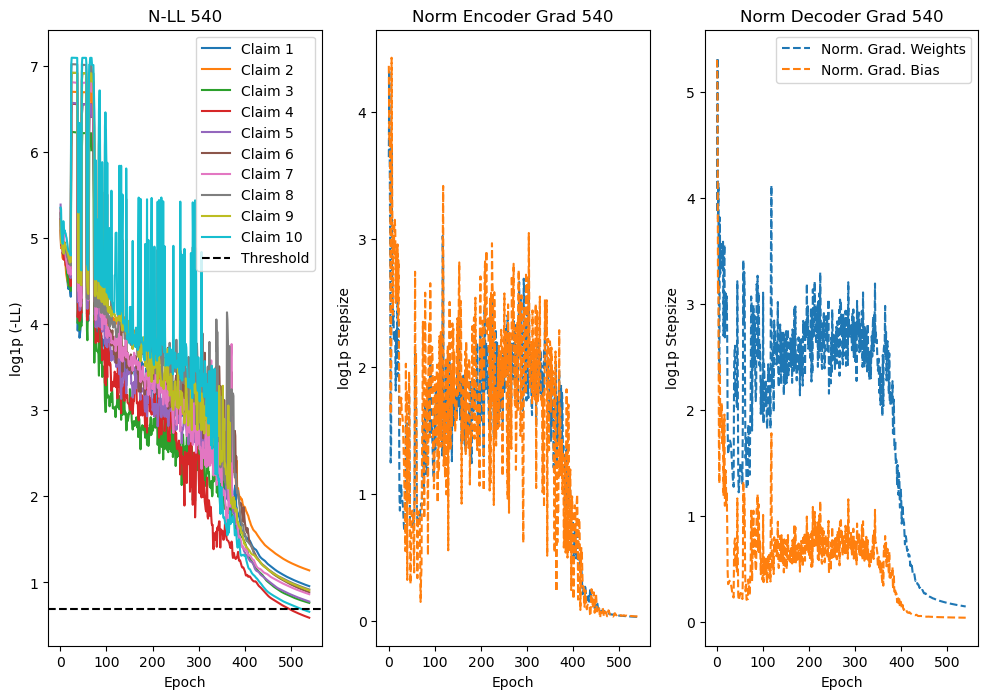

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

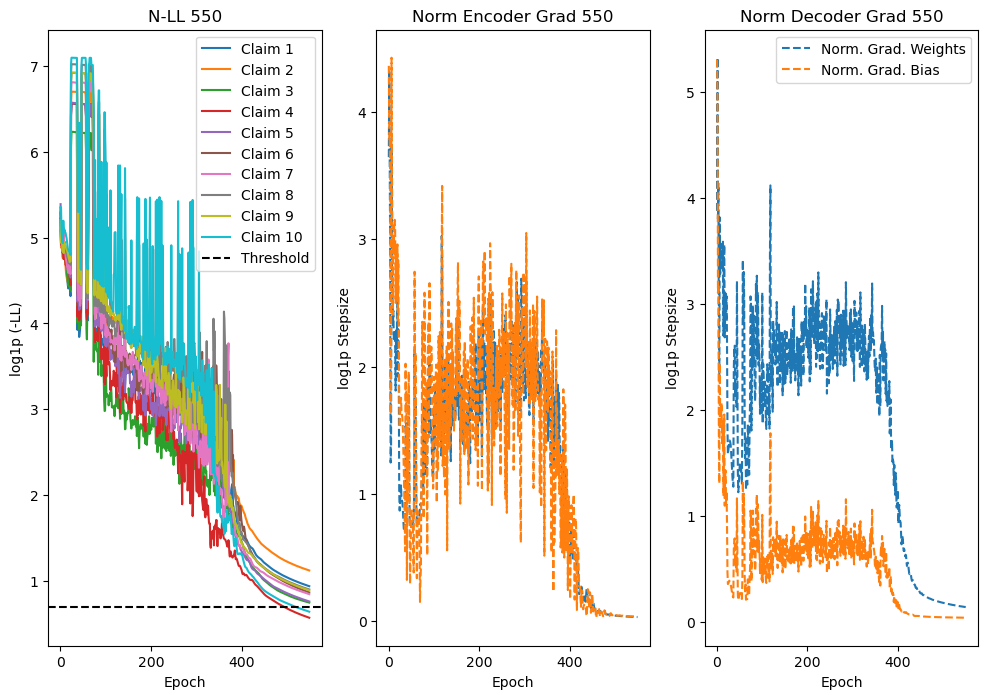

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

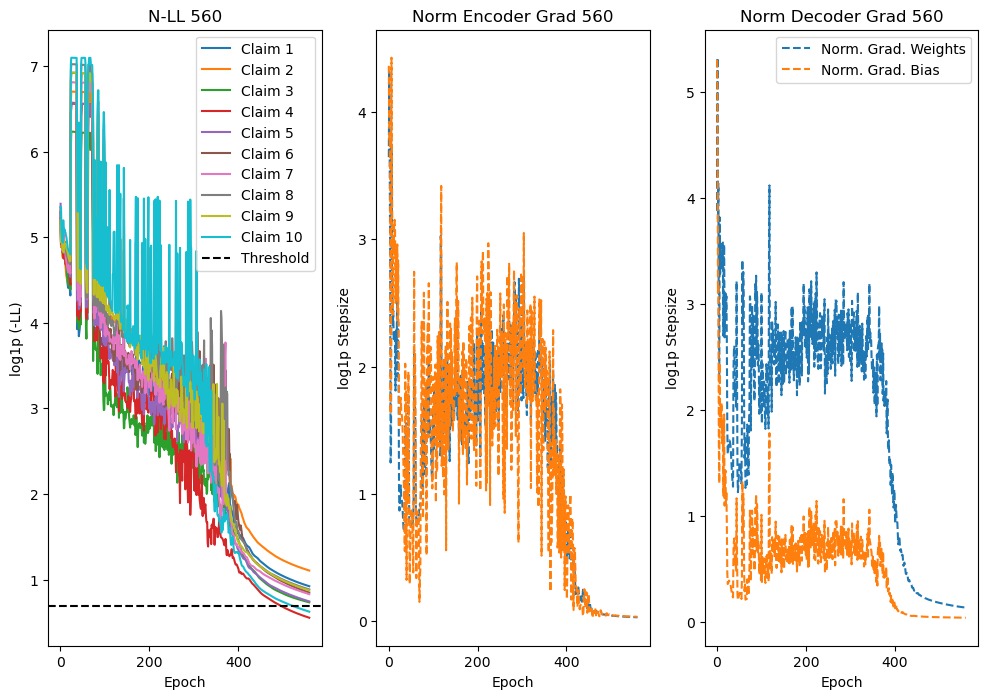

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

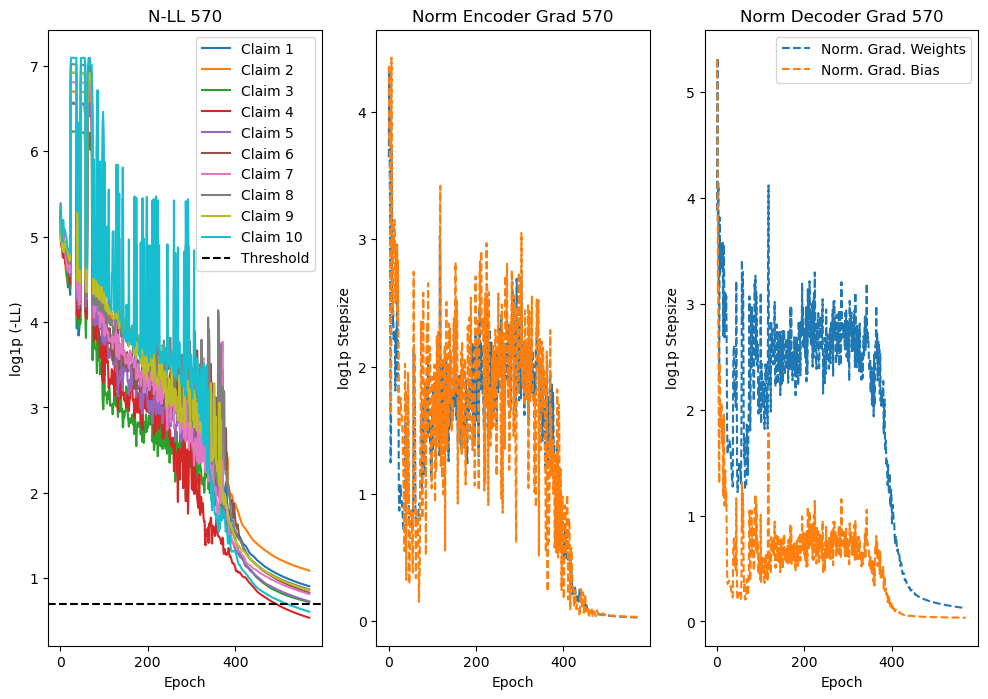

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

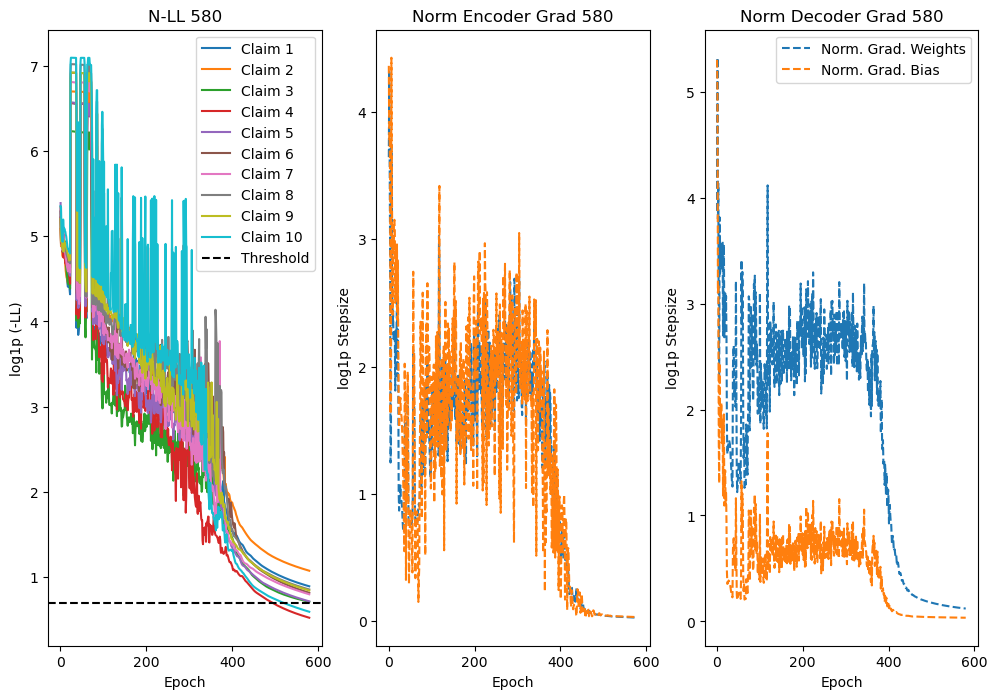

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

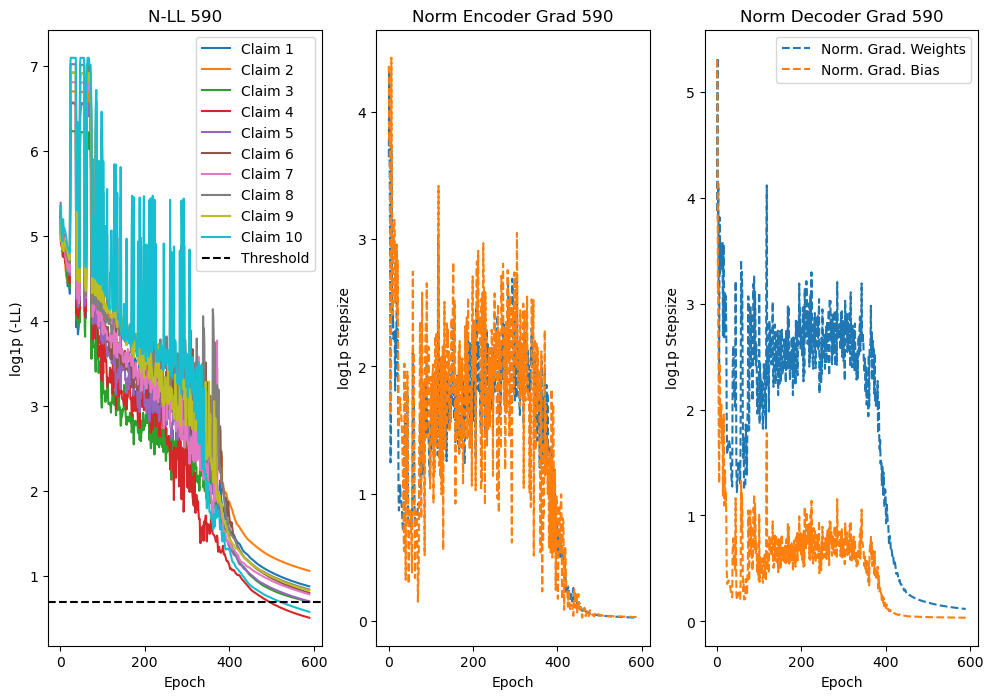

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

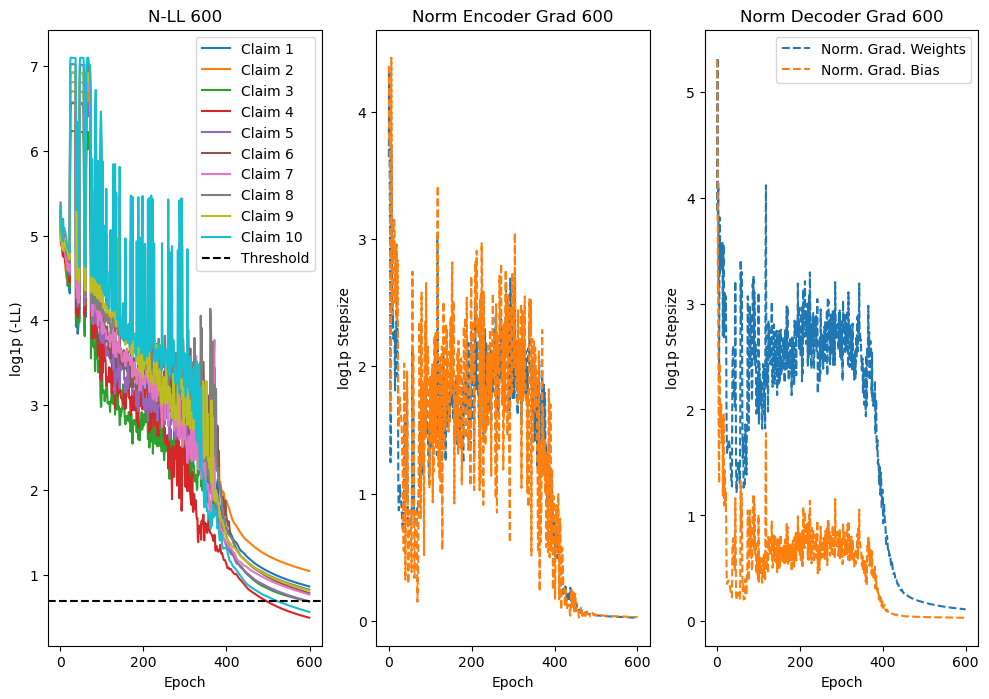

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

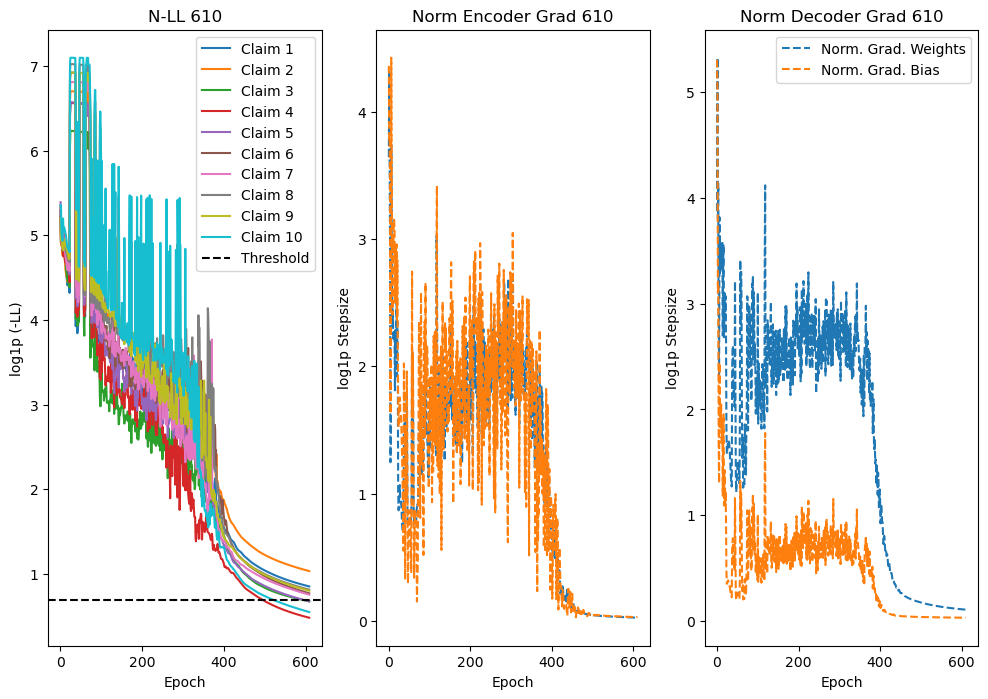

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

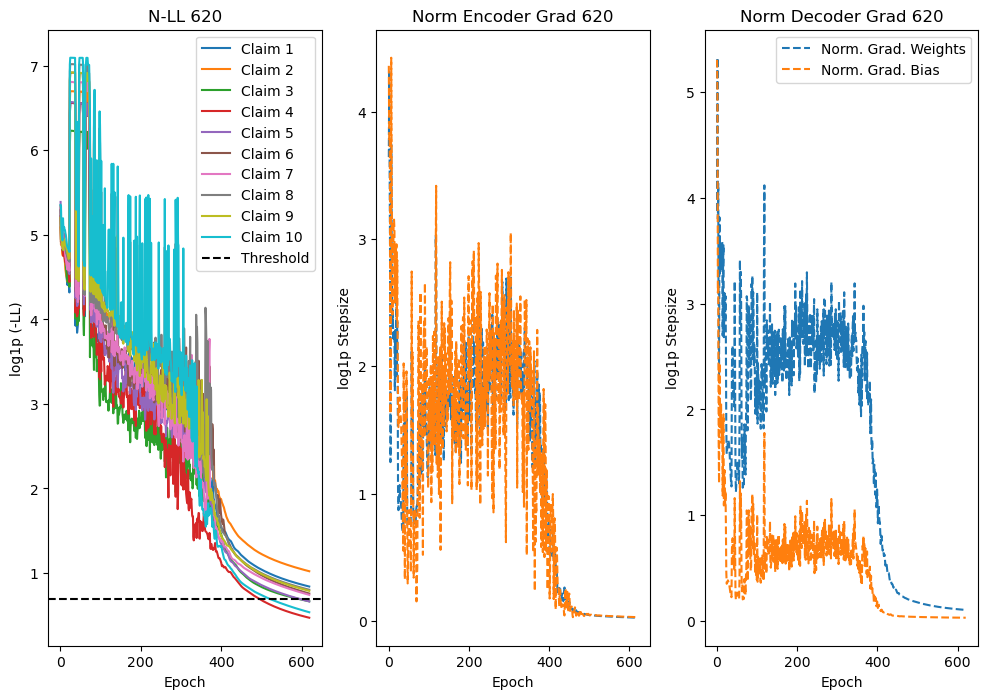

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

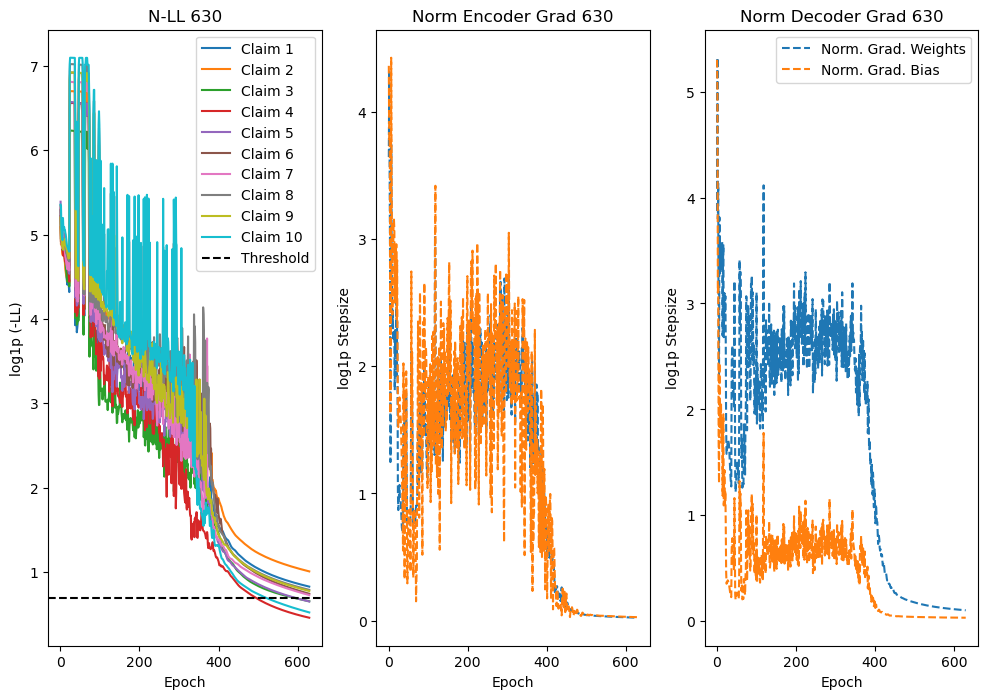

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

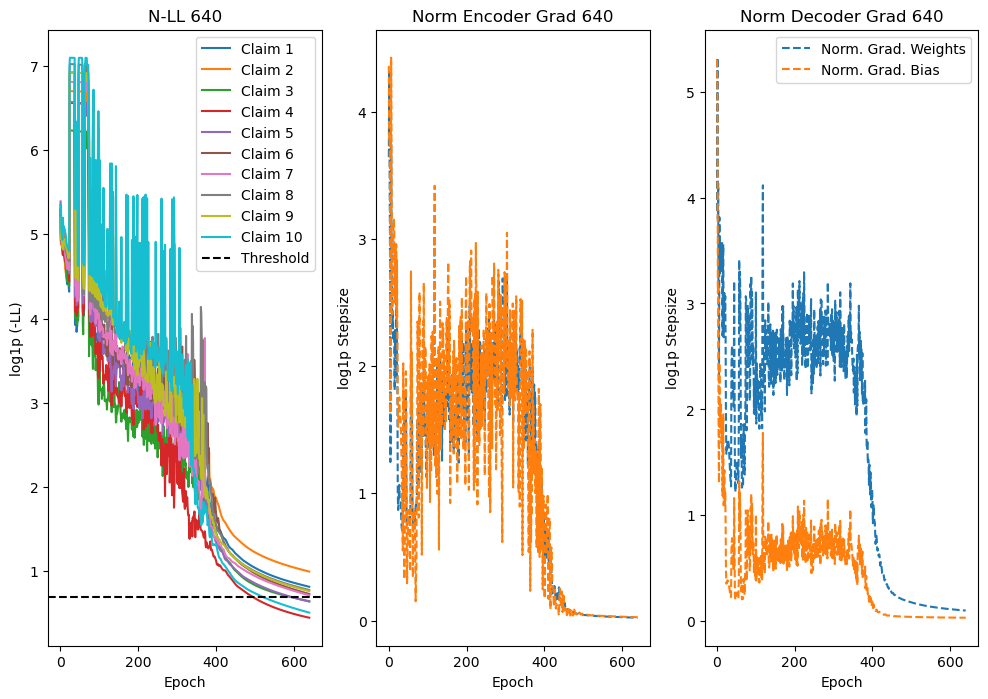

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

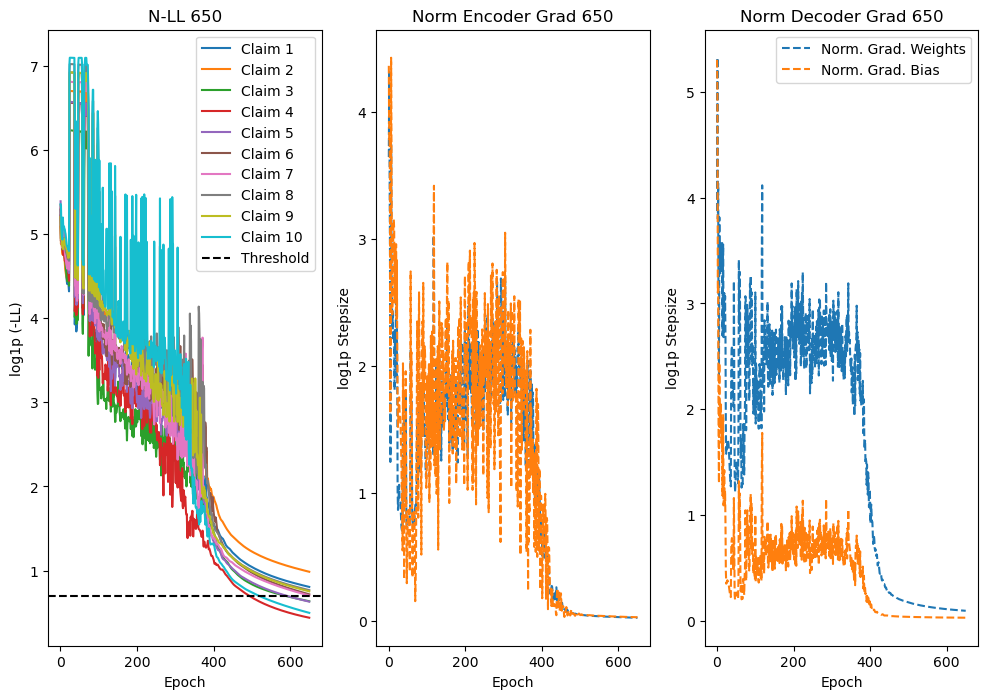

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

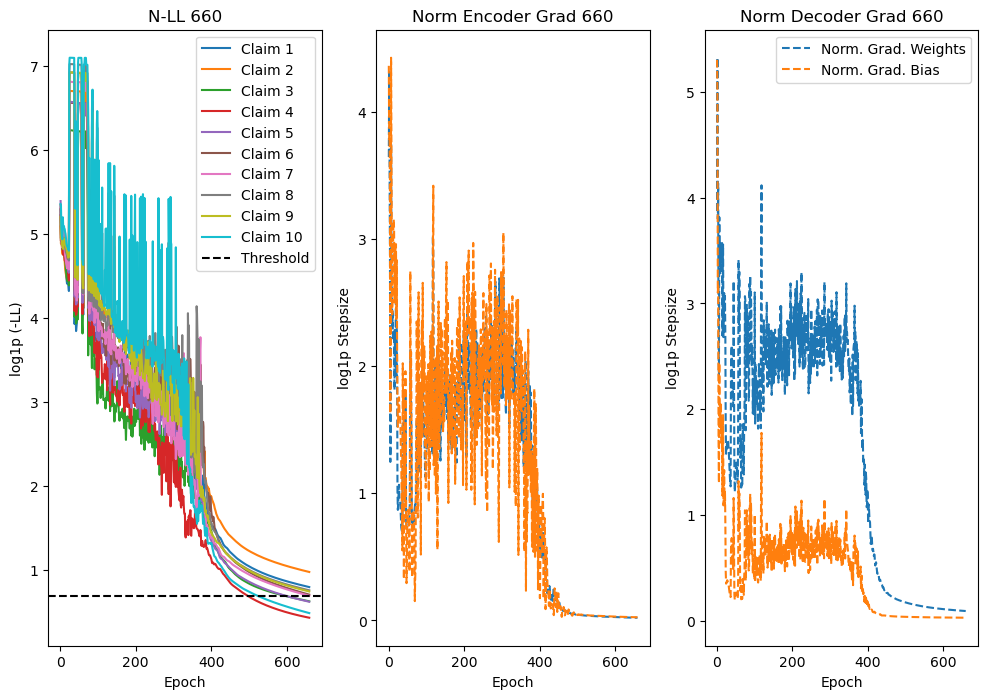

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

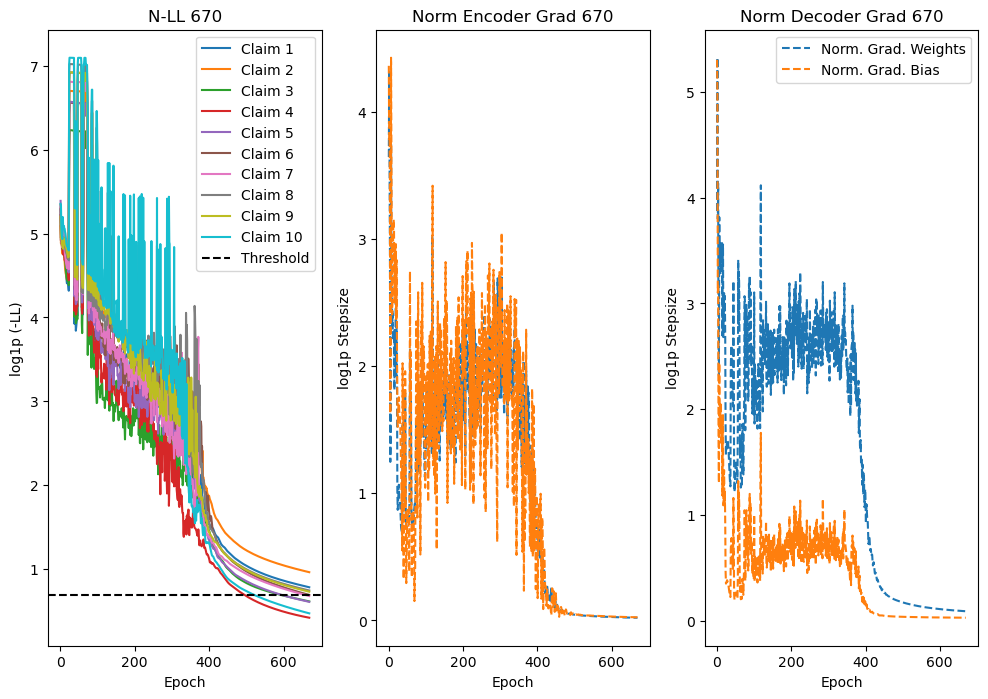

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

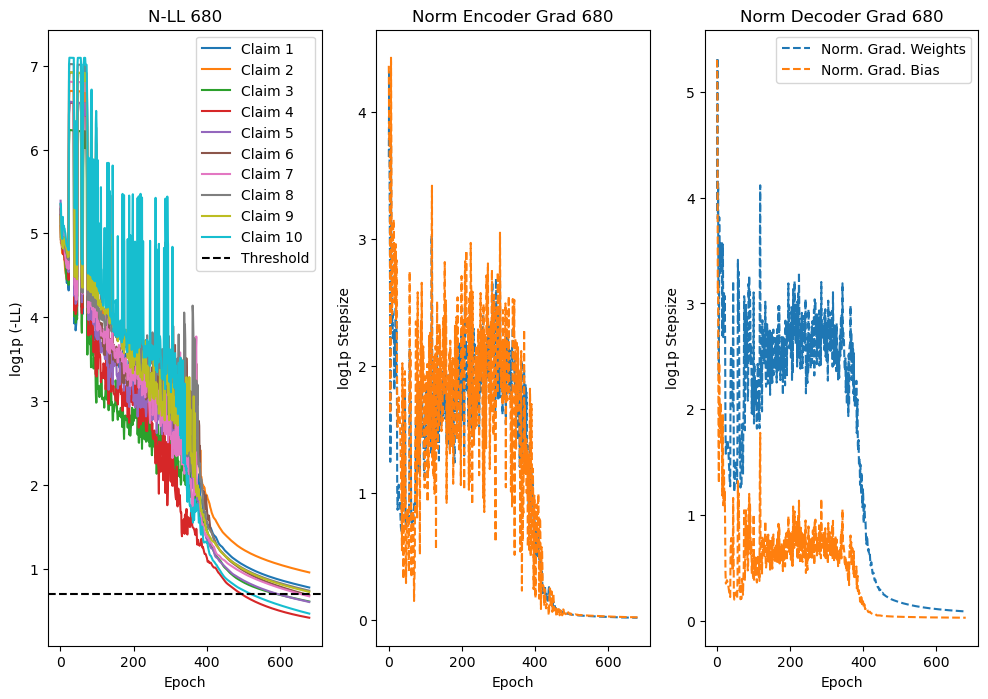

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

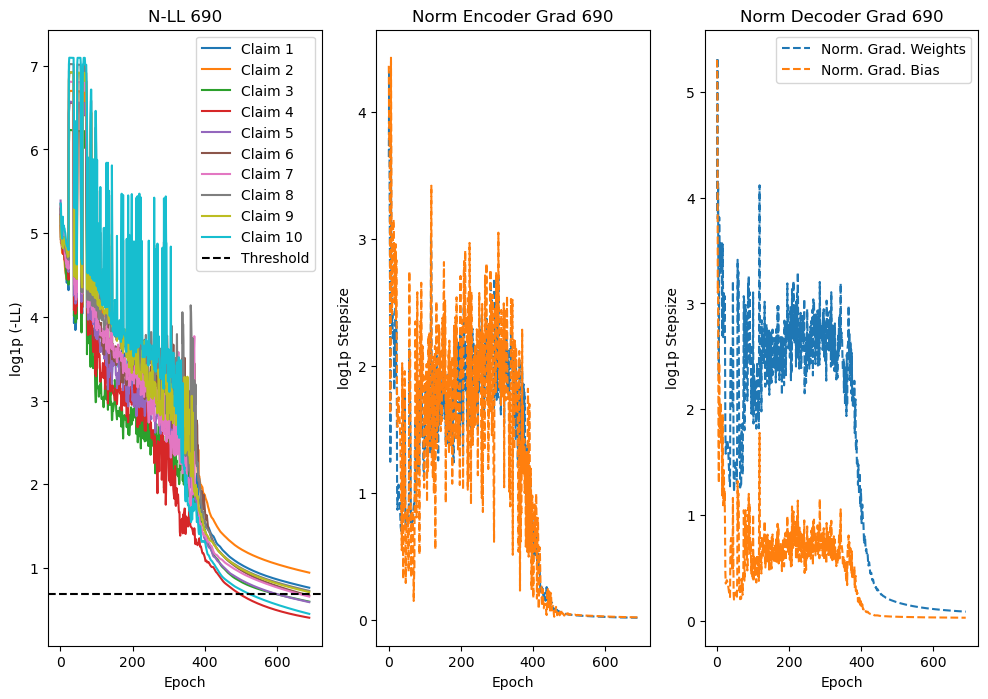

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

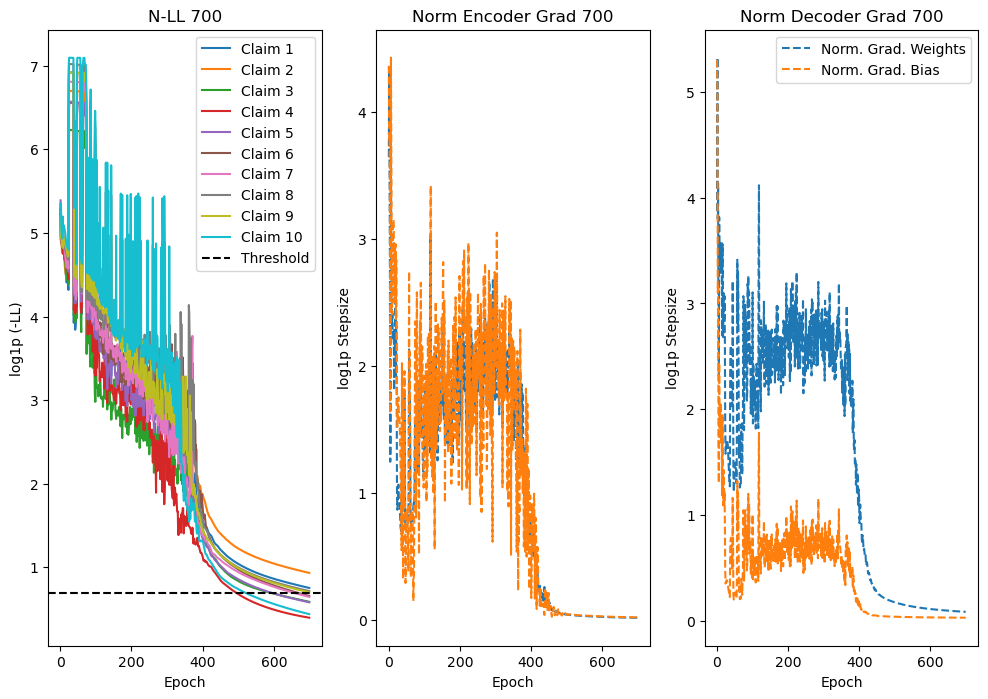

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

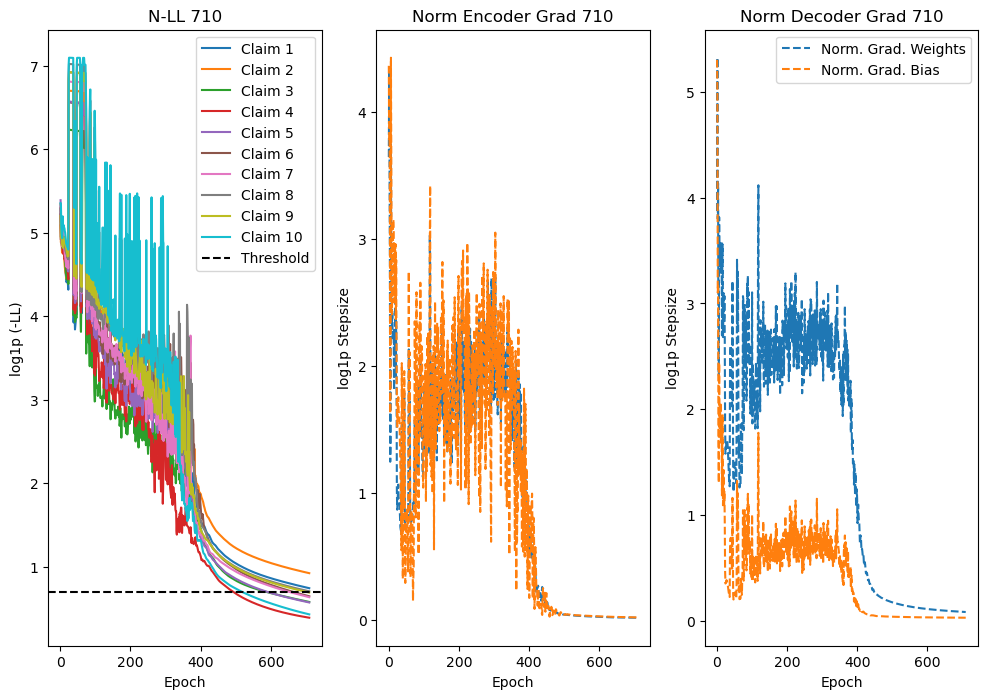

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

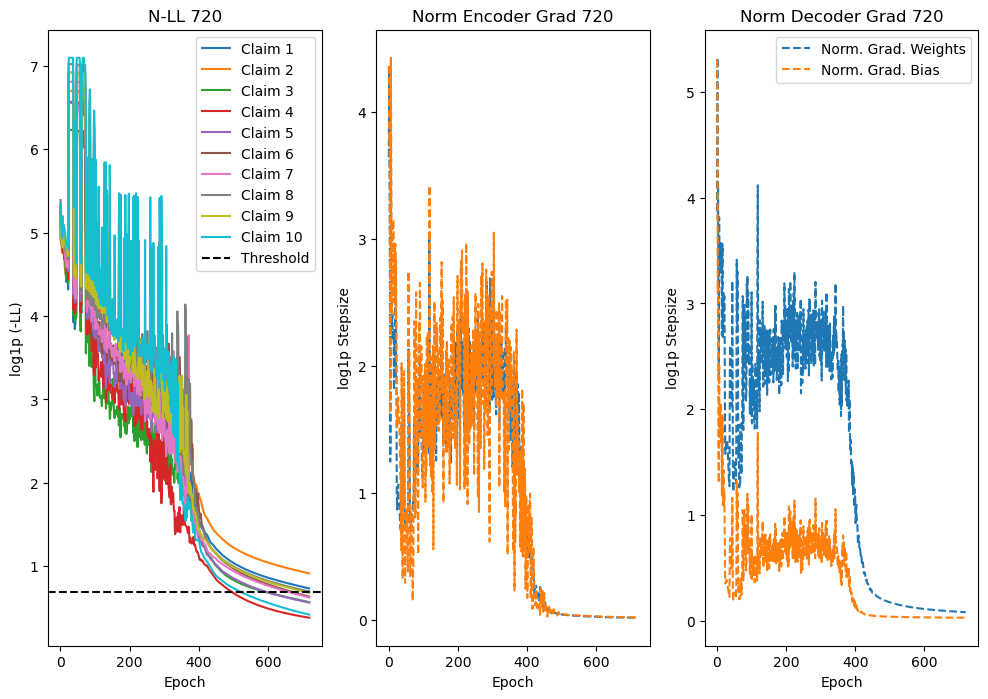

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

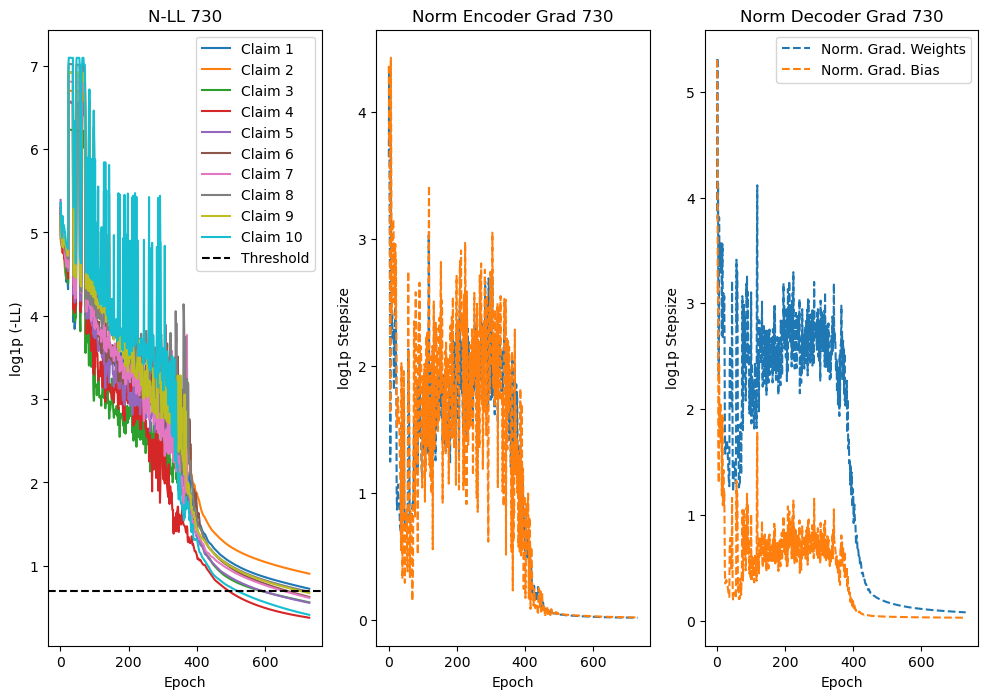

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

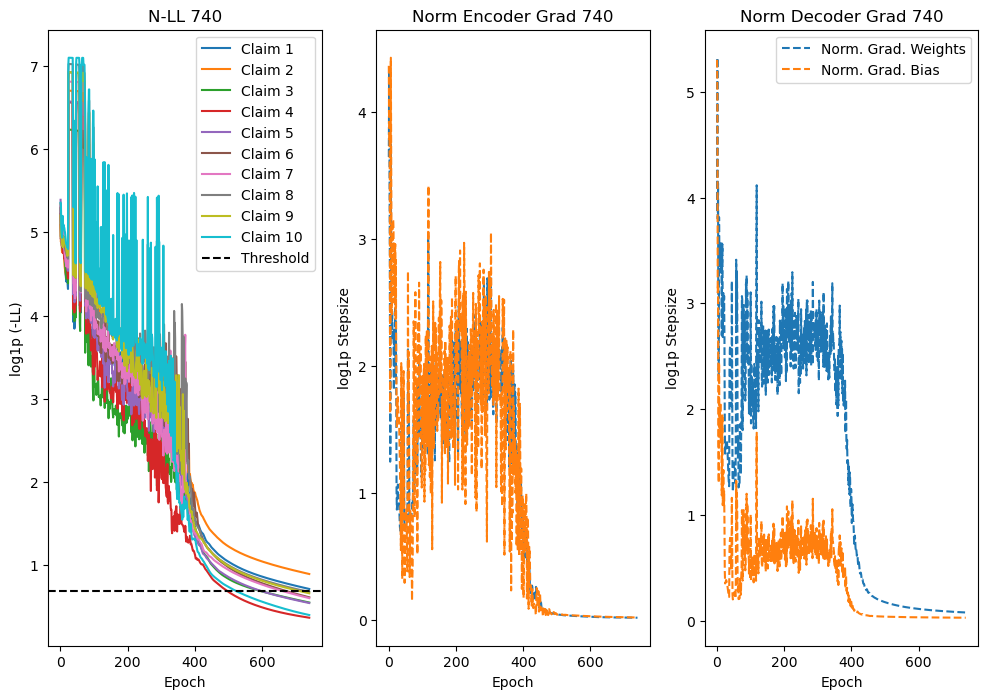

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

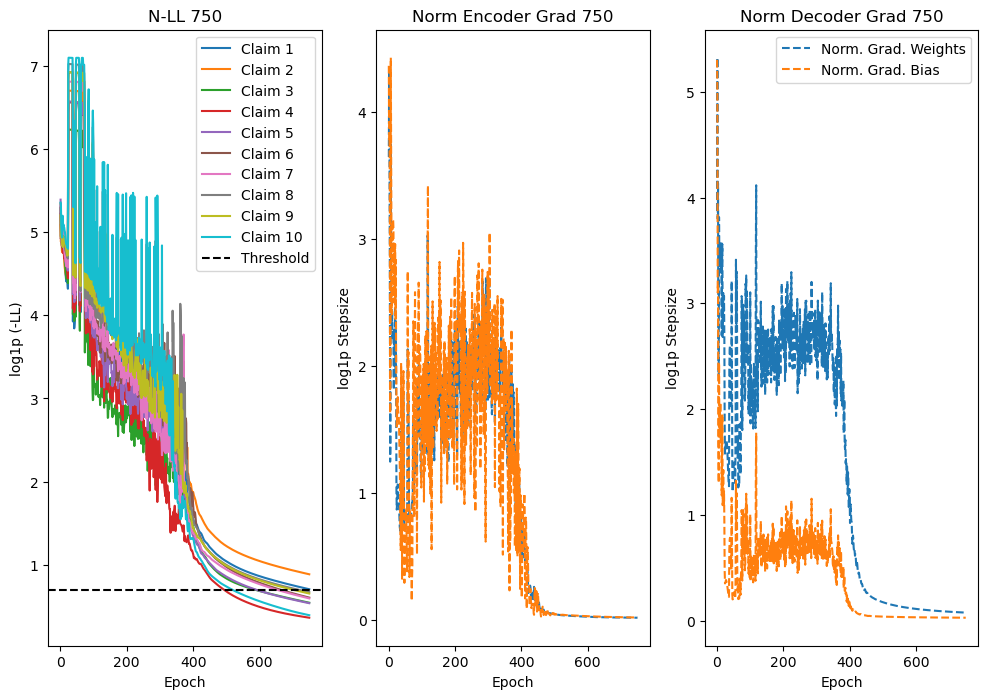

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

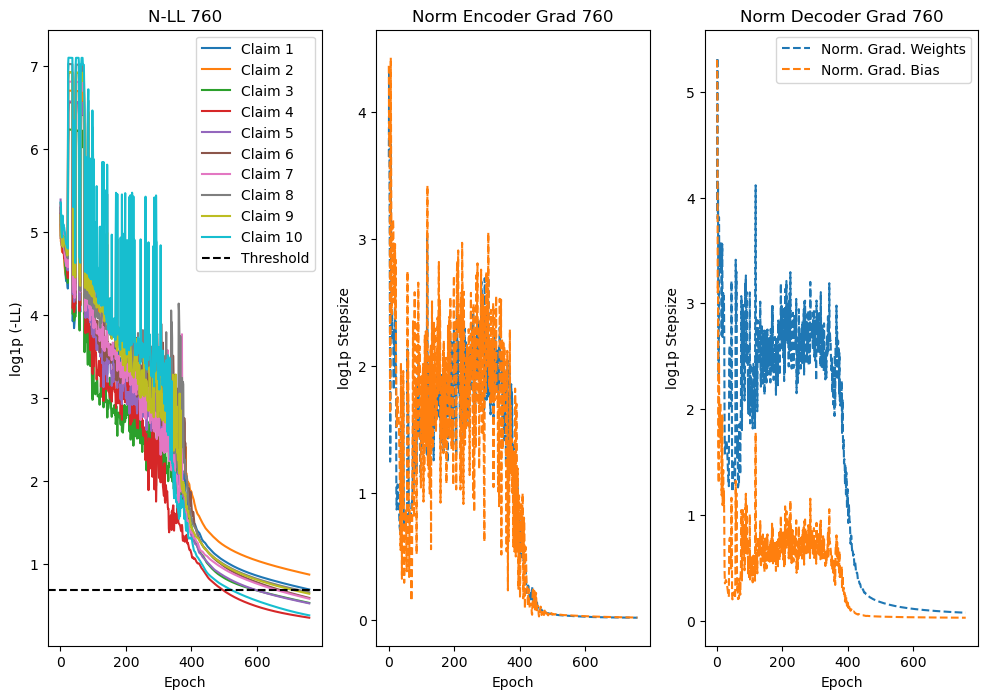

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

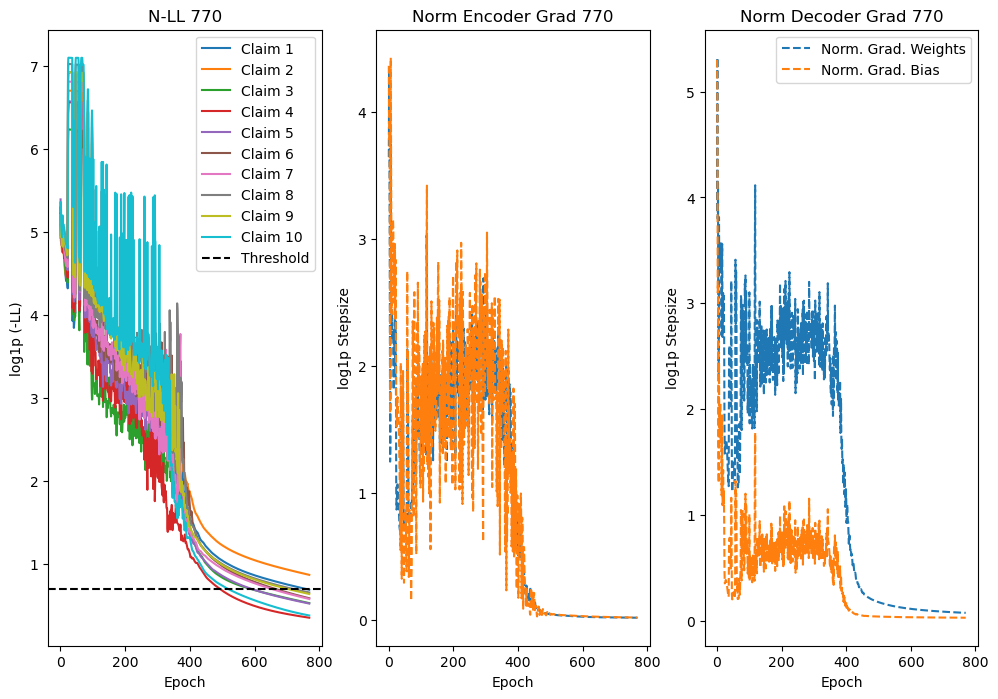

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

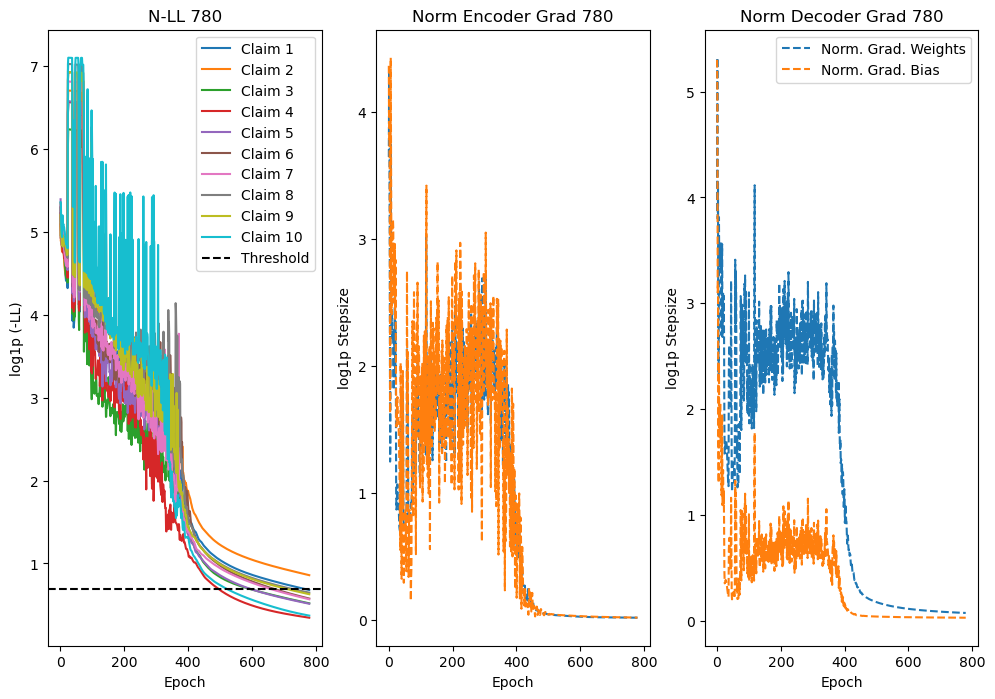

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

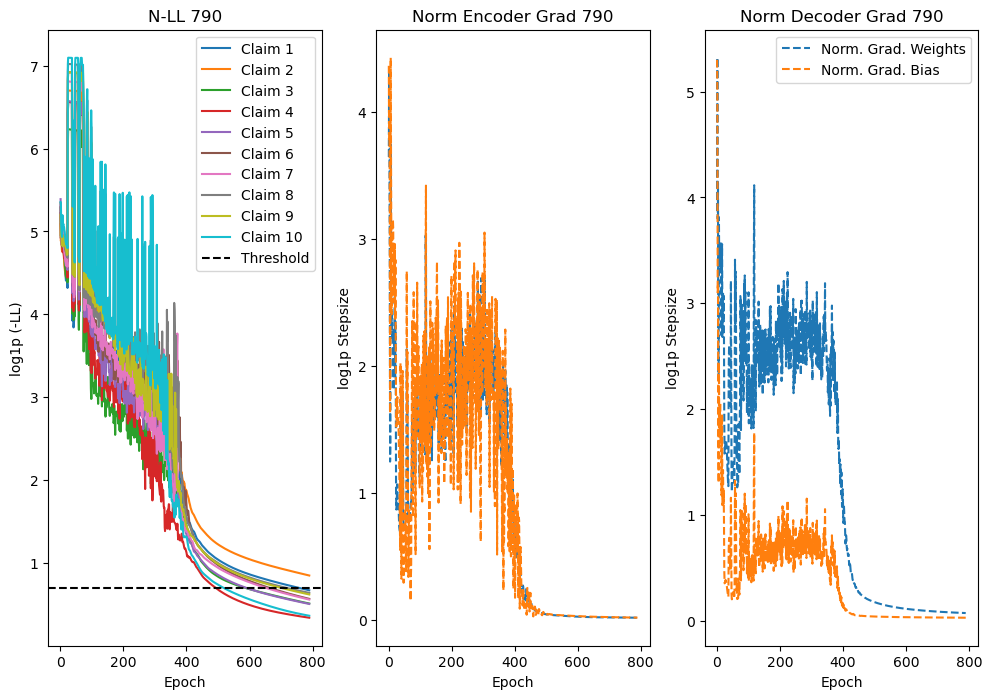

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

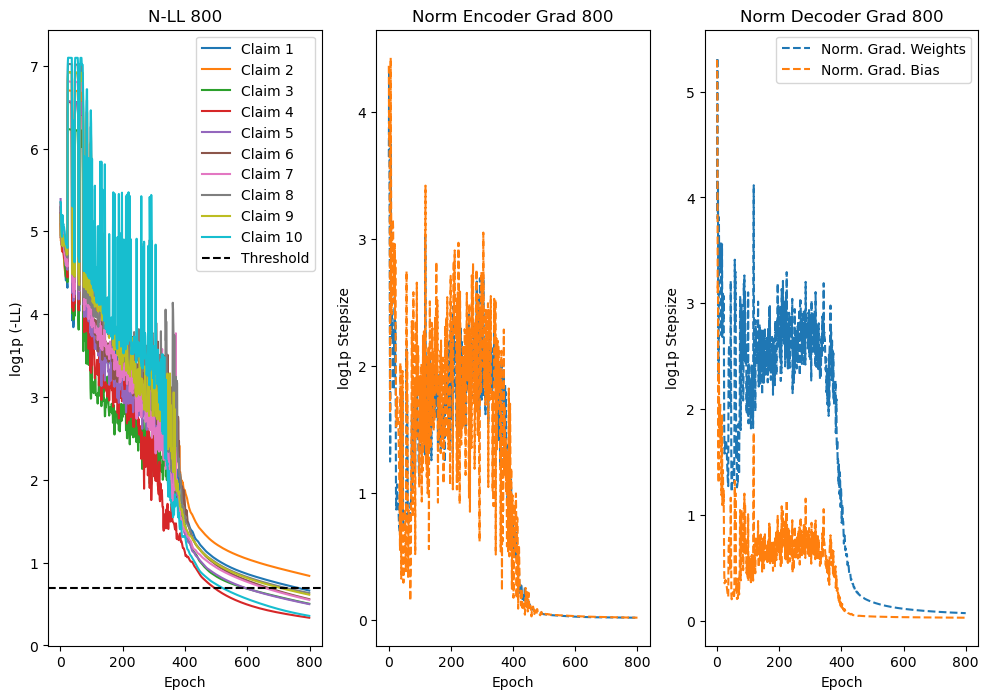

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

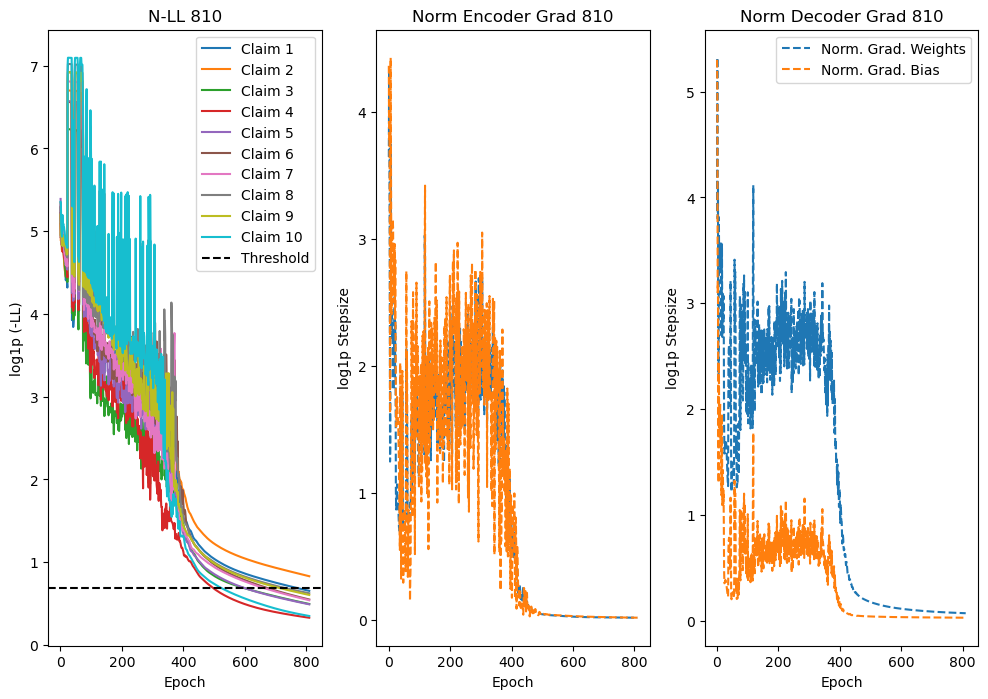

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

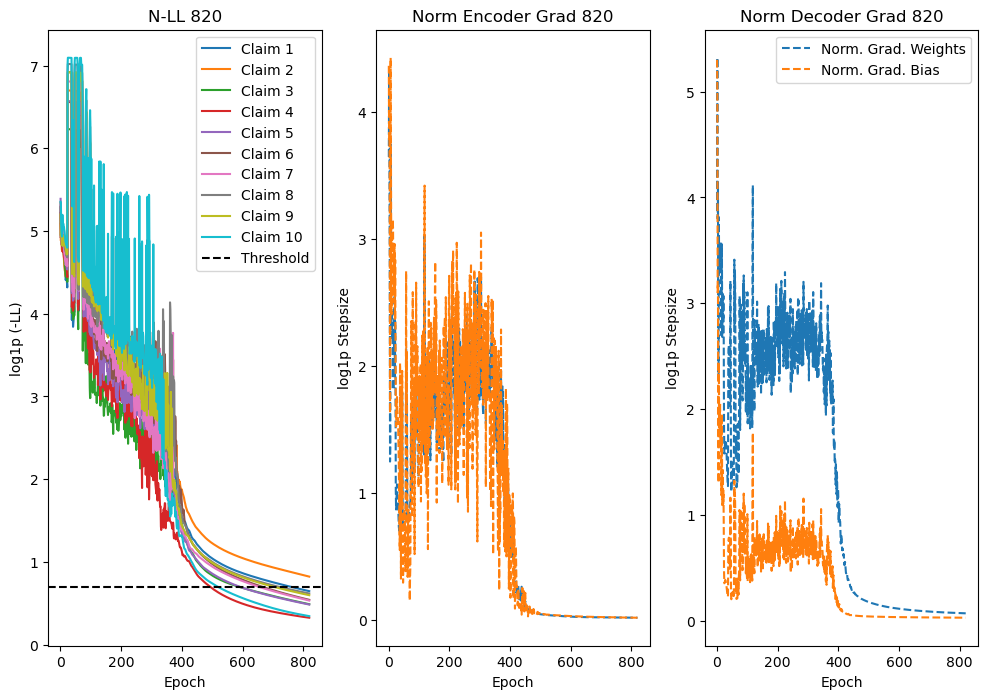

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

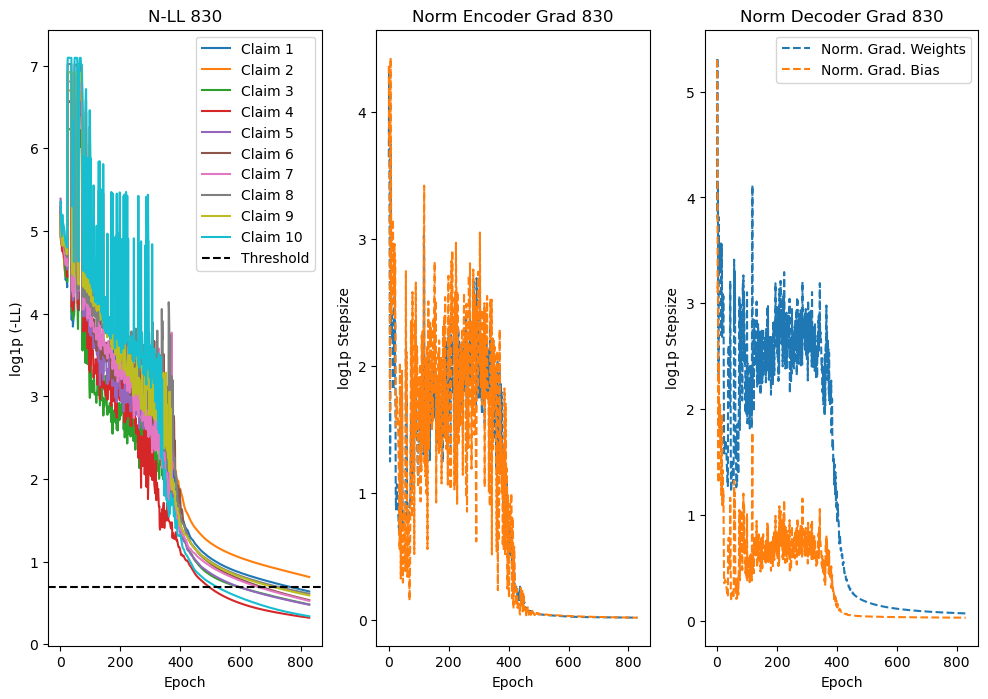

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

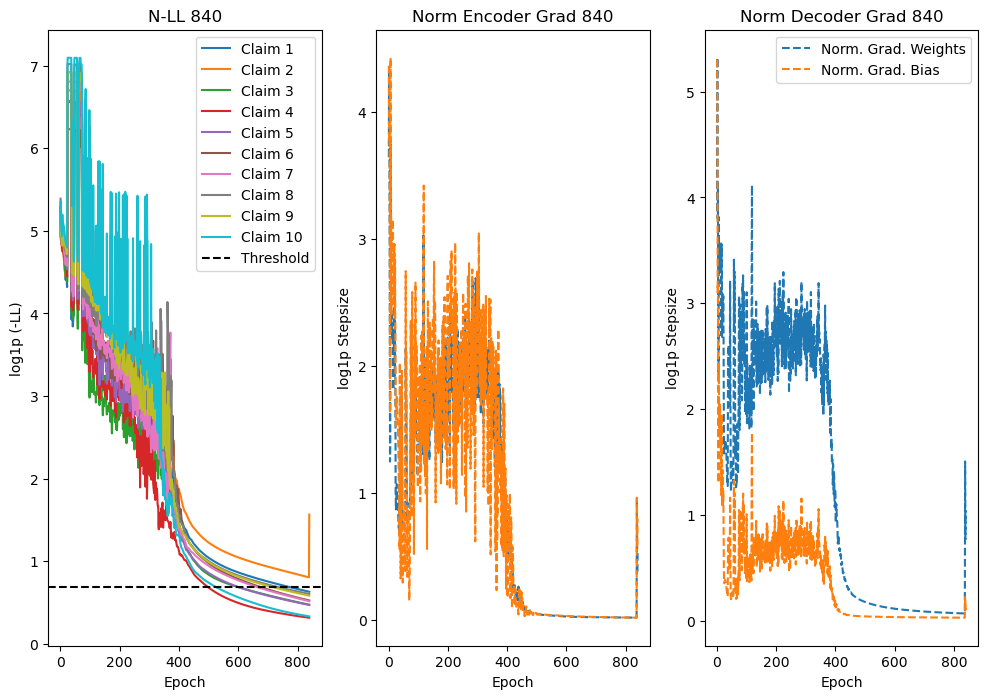

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Experience dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|

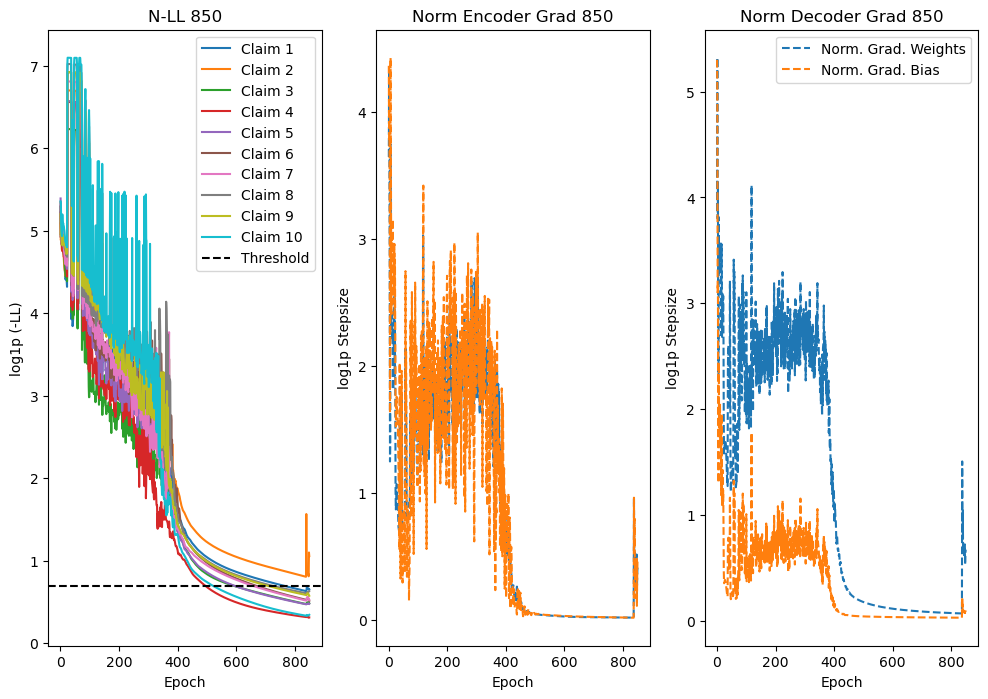

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Get dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|endofte

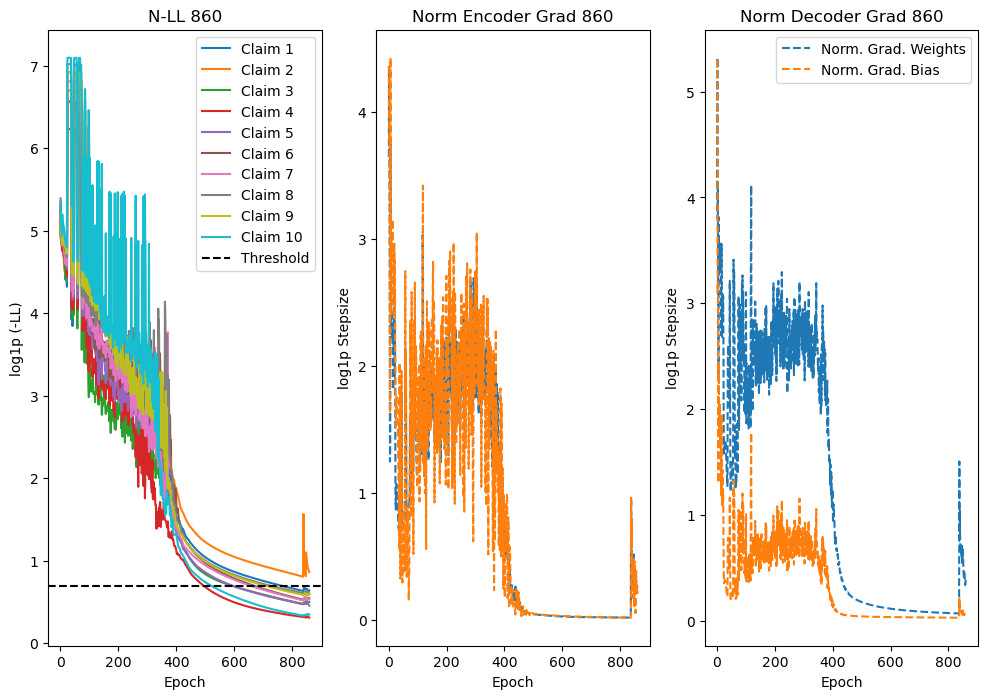

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Get dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|endofte

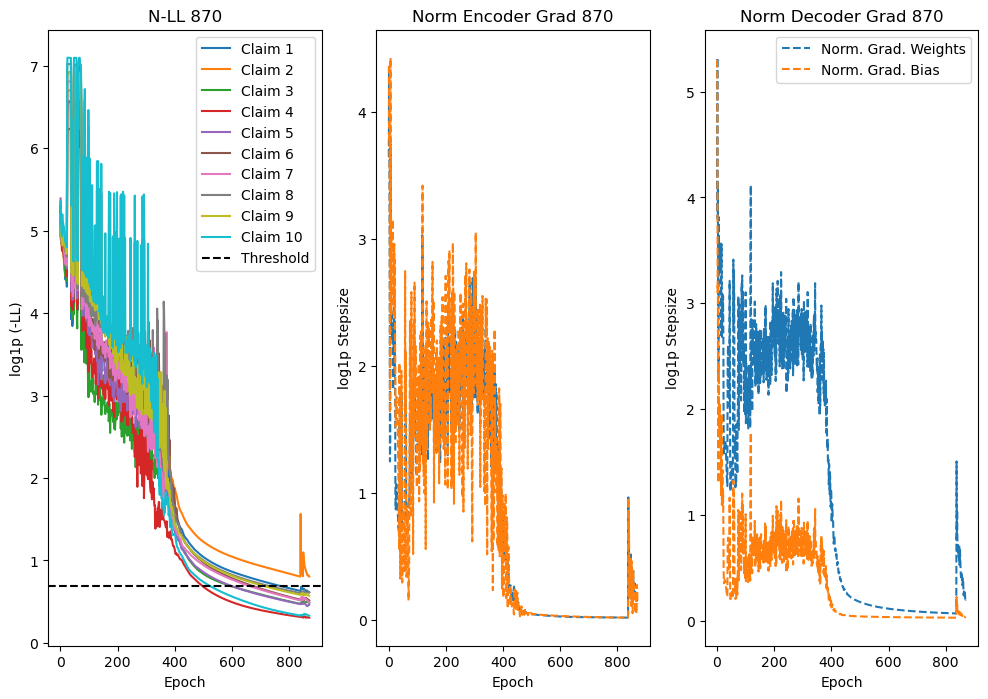

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Get dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|endofte

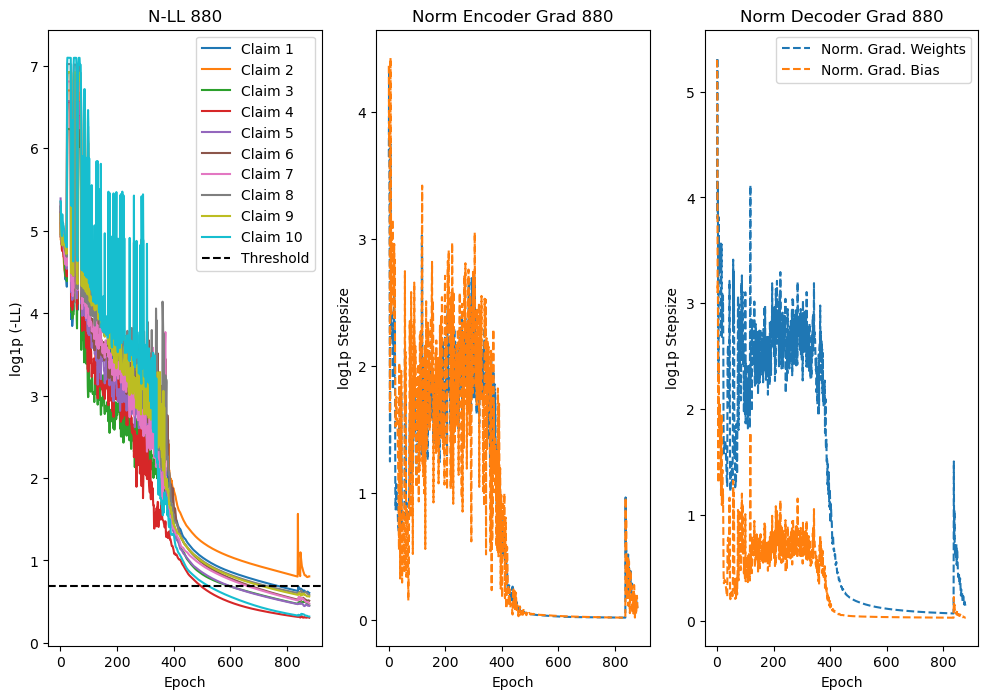

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Get dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|endofte

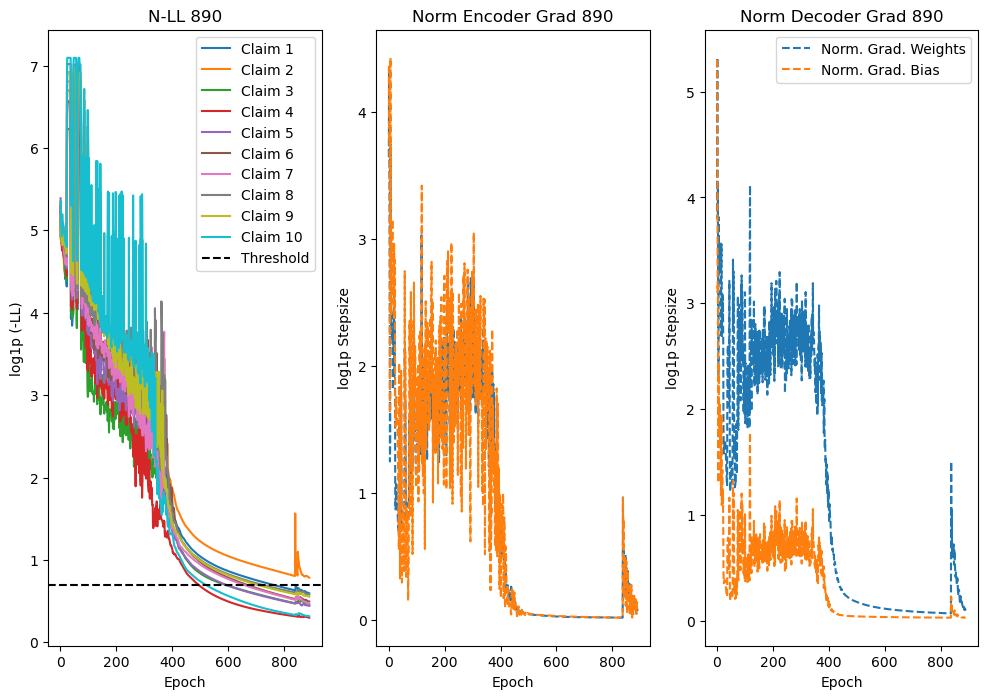

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Get dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|endofte

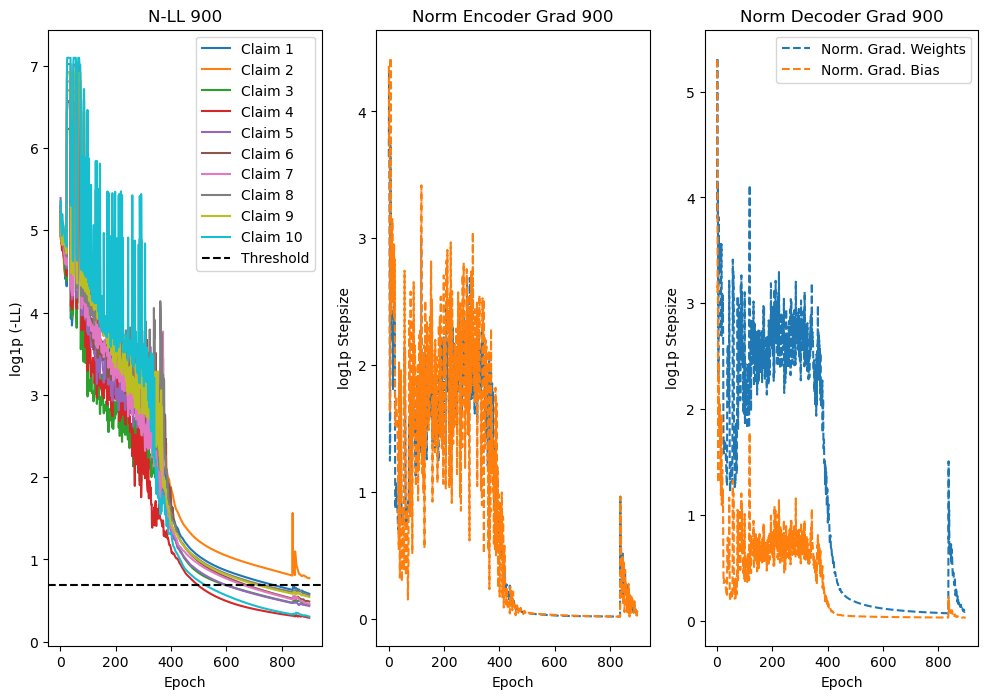

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Get dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|endofte

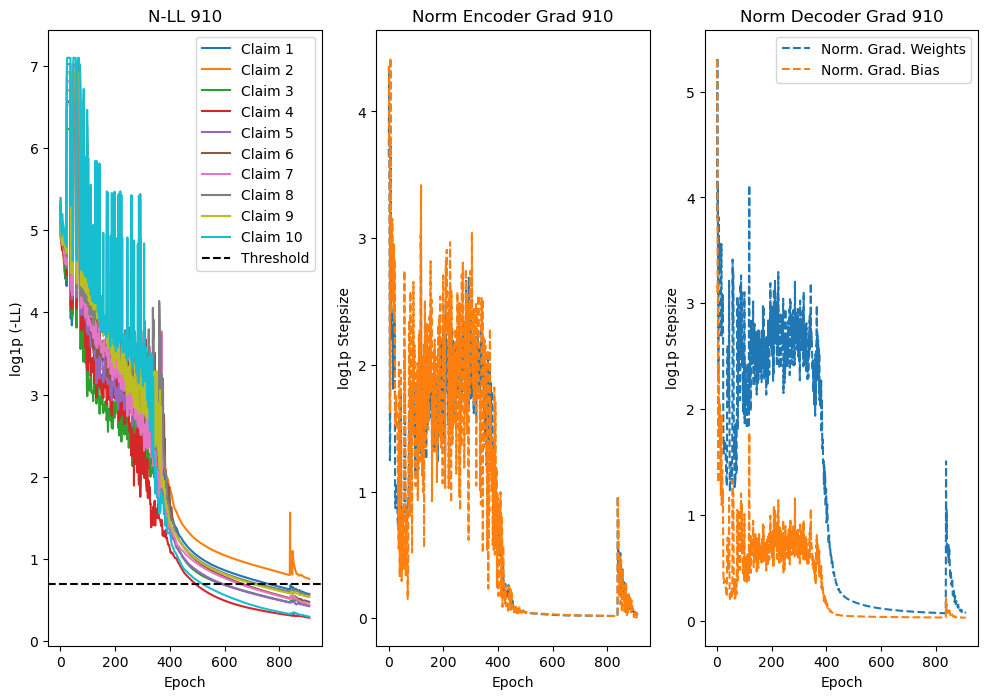

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Get dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|endofte

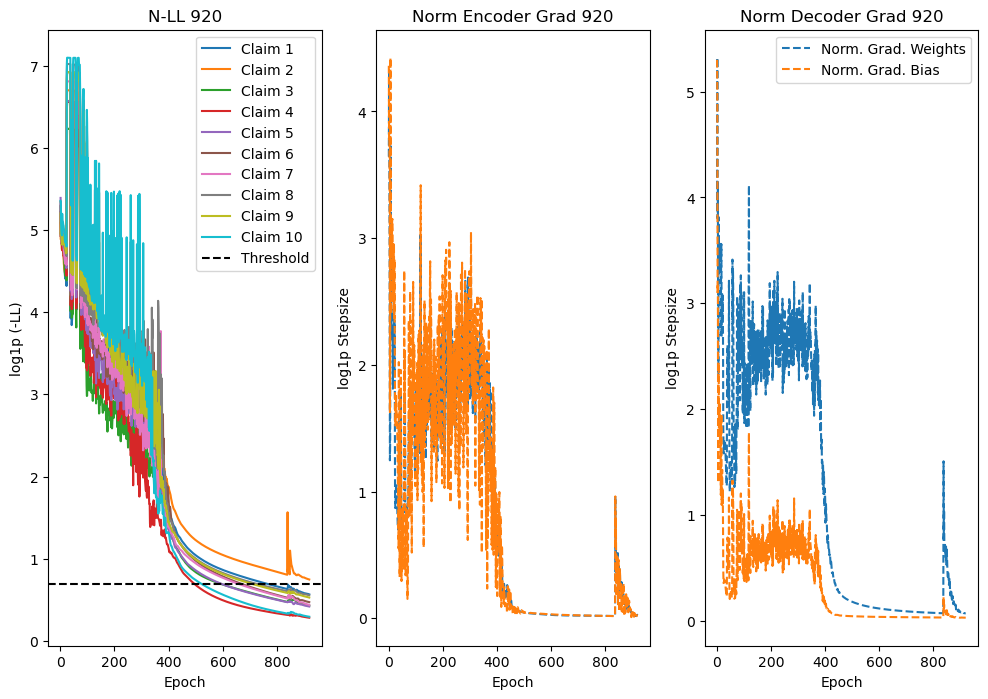

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Get dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|endofte

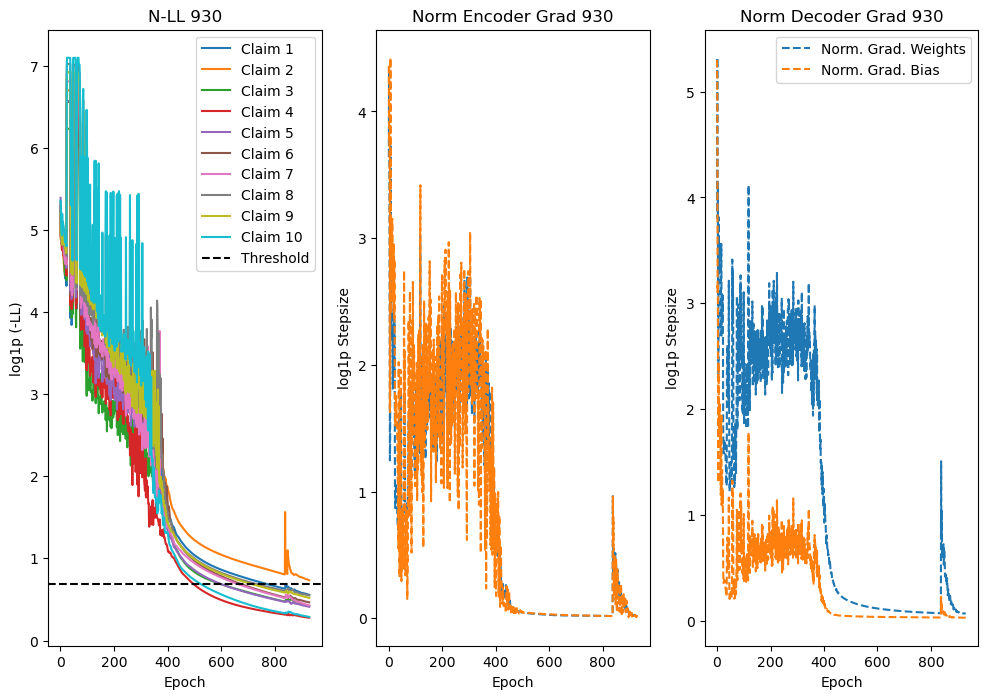

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Get dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|endofte

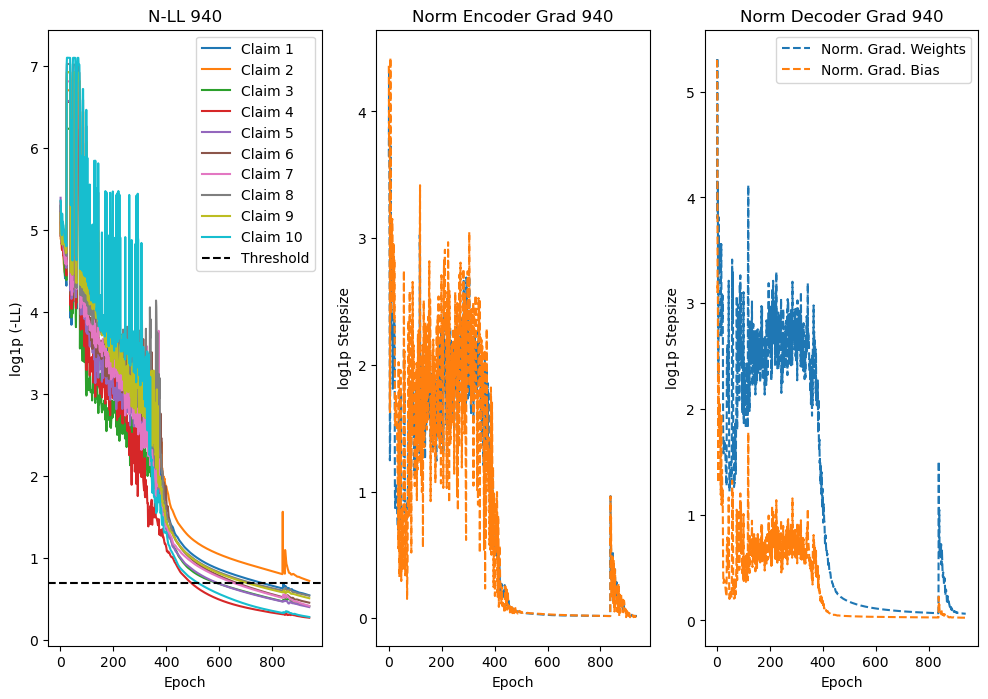

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Get dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|endofte

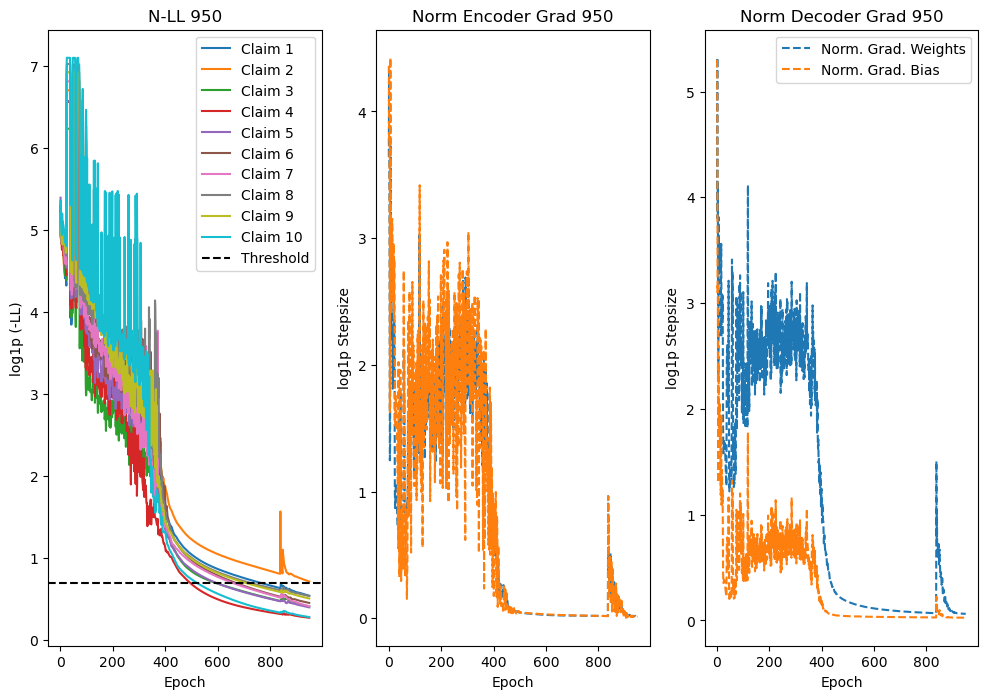

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Get dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|endofte

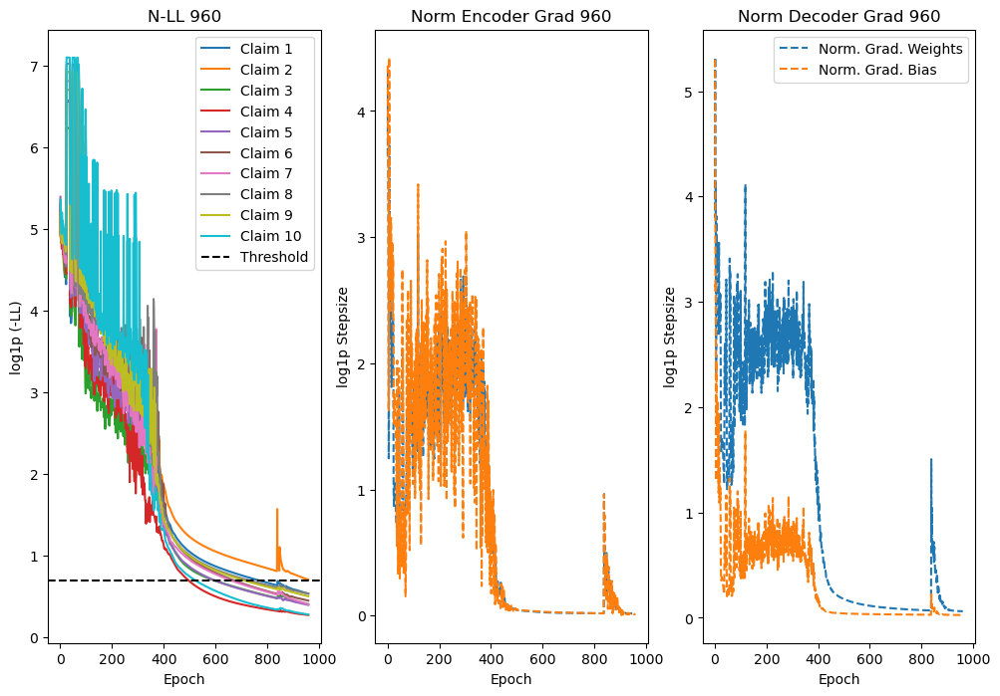

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Get dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|endofte

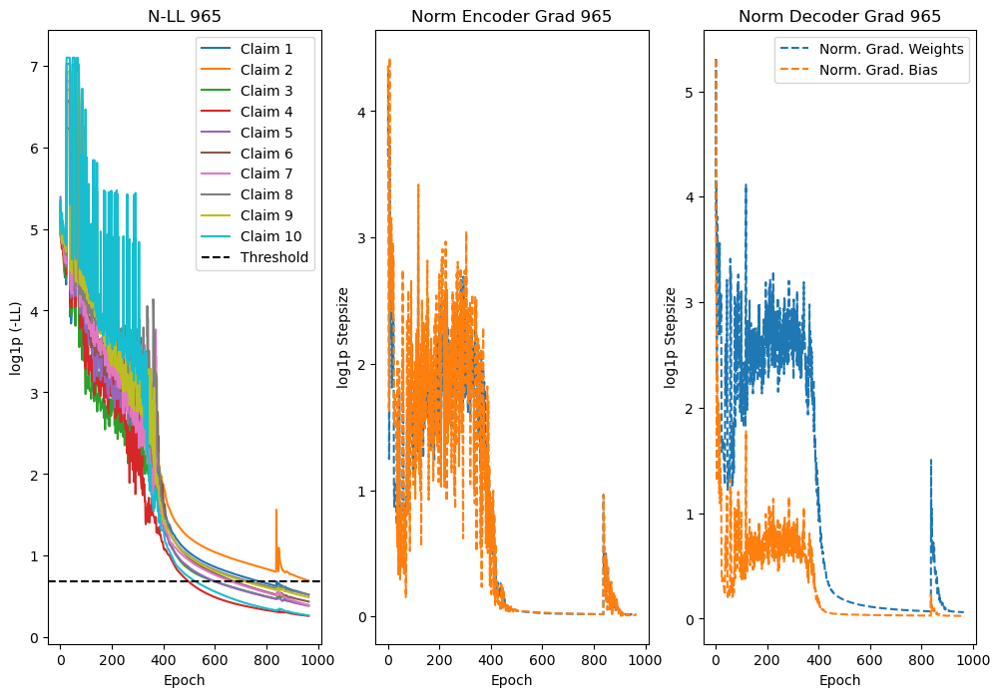

Claim 0: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 1: <|endoftext|>Get dazzling, glossy hair in just one use.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 2: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 3: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 4: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 5: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|><|endoftext|><|endoftext|>
Claim 6: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|><|endoftext|><|endoftext|><|endoftext|>
Claim 7: <|endofte

In [46]:
import matplotlib.pyplot as plt
# works! 410s at Adam lr=1 (4 claims);
# Training the autoencoder
# Loss function and optimizer
#optimizer = optim.SGD(ae.parameters(), lr=3e0, momentum=9e-1)
# mlflow.end_run()
# TODO: Init ae with lin comb of summary
# TODO: Are the EOS tokens working?
learning_rate = 5e-1

ae = Autoencoder(input_size, encoding_dim, output_size)
optimizer = optim.Adam(ae.parameters(), lr=learning_rate)

# Create a new MLflow Experiment
# mlflow.set_experiment("MLflow Quickstart")

# checkpoint = torch.load("model_checkpoint.pt")
# ae.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
# epoch = checkpoint['epoch']
epoch = 0
# loss = checkpoint['loss']

dEps = 1
bStop = False
aLLHistory = np.ones((1, tOHETarget.shape[0]))

lStepsWeightsDecoder = []
lStepsBiasDecoder = []
lStepsWeightsEncoder = []
lStepsBiasEncoder = []

aLLHistory[0, :] = np.nan
aLLHistory = np.ones((1, tOHETarget.shape[0]))
aLLHistory[0, :] = np.nan

# Start MLFlow run
# mlflow.start_run()

#mlflow.log_param("learning_rate", learning_rate)
# mlflow.log_param("encoding_dim", encoding_dim)
# mlflow.log_param("optimizer", optimizer)

#tIdxA, tIdxB = torch.arange(tTargetStrings.shape[0]).view(-1, 1).expand(-1, iMaxTokens), torch.arange(iMaxTokens).view(1, -1).expand(tTargetStrings.shape[0], -1)
tIdxA, tIdxB = torch.arange(tTargetStrings.shape[0]).view(-1, 1).expand(-1, 50257), torch.arange(50257).view(1, -1).expand(tTargetStrings.shape[0], -1)

tic_total = time.time()
tic = time.time()
lLoss = []
while not bStop:
    aStore = np.zeros((1, tOHETarget.shape[0]))

    tAEOutputs = ae(tOHETarget).reshape(tOHETarget.shape[0], 1, -1)

    outputs = fn_generate_max(tAEOutputs)
    #loss = llikelihood(outputs, tTargetStrings, tIdxA, tIdxB)
    loss, loss_monitor = LLikelihood(outputs.scores, tTargetStrings, iMaxTokens, 10)
    lLoss.append(loss.item())

    # Backward pass and optimization
    optimizer.zero_grad()
    loss.backward()
    
    aLLHistory = np.vstack([aLLHistory, loss_monitor.cpu().detach().numpy()])
    bStop = loss < dEps
    bStop = np.all(aLLHistory[epoch, :] < dEps)
    
    # Log optimizer step size
    lStepsWeightsDecoder.append(torch.norm(ae.decoder[0].weight.grad).cpu().detach().numpy())
    lStepsBiasDecoder.append(torch.norm(ae.decoder[0].bias.grad).cpu().detach().numpy())

    lStepsWeightsEncoder.append(torch.norm(ae.encoder[0].weight.grad).cpu().detach().numpy())
    lStepsBiasEncoder.append(torch.norm(ae.encoder[0].bias.grad).cpu().detach().numpy())
    optimizer.step()

    # Reporting
    if (epoch % 10 == 0) or bStop:
        toc = time.time()
        print(f"time: {np.round(toc - tic, 2)} s")
        
        fig, axs = plt.subplots(1, 3, figsize=(12, 8))
        # Plot 1
        for i in range(tOHETarget.shape[0]):
            axs[0].plot(np.log1p(aLLHistory[0:epoch, i]), label=f"Claim {i + 1}")
        axs[0].axhline(y=np.log1p(dEps), linestyle='--', color='black', label="Threshold")
        axs[0].legend()
        axs[0].set_xlabel("Epoch")
        axs[0].set_ylabel("log1p (-LL)")
        axs[0].set_title(f"N-LL {epoch}")

        # # Plot 3
        axs[1].plot(np.log1p(np.asarray(lStepsWeightsEncoder)), linestyle='--', label="Norm. Grad. Weights")
        axs[1].plot(np.log1p(np.asarray(lStepsBiasEncoder)), linestyle='--', label="Norm. Grad. Bias")
        axs[1].set_xlabel("Epoch")
        axs[1].set_ylabel("log1p Stepsize")
        axs[1].set_title(f"Norm Encoder Grad {epoch}")
        plt.legend()

        # Plot 2
        axs[2].plot(np.log1p(np.asarray(lStepsWeightsDecoder)), linestyle='--', label="Norm. Grad. Weights")
        axs[2].plot(np.log1p(np.asarray(lStepsBiasDecoder)), linestyle='--', label="Norm. Grad. Bias")
        axs[2].set_xlabel("Epoch")
        axs[2].set_ylabel("log1p Stepsize")
        axs[2].set_title(f"Norm Decoder Grad {epoch}")
        plt.legend()

        plt.show()
        
        tGenNew = fn_generate_max(ae(tOHETarget).reshape(tOHETarget.shape[0], 1, -1)).sequences
        for i in range(tOHETarget.shape[0]):
            print(f"Claim {i}: {tokenizer.decode(tGenNew[i])}")

        # mlflow.pytorch.log_model(ae, "models")
        tic = time.time()

    epoch = 1 + epoch

toc = time.time()
print(f"Total time: {np.round(toc - tic_total, 2)} s")
# Encoding the data using the trained autoencoder
#mlflow.log_metric("number_epochs", epoch)
torch.save(ae.state_dict(), "autoencoder_dict_test.pt")
model_scripted = torch.jit.script(ae) # Export to TorchScript
model_scripted.save('autoencoder_test.pt') # Save


# TODO: Deal with different generated sequence length!


torch.Size([10, 15, 50257])

In [21]:
# works! 410s at Adam lr=1 (4 claims);
# Training the autoencoder
# Loss function and optimizer
#optimizer = optim.SGD(ae.parameters(), lr=3e0, momentum=9e-1)
# mlflow.end_run()
learning_rate = 3e0

ae = Autoencoder(input_size, encoding_dim, output_size)
optimizer = optim.Adam(ae.parameters(), lr=learning_rate)

# Create a new MLflow Experiment
# mlflow.set_experiment("MLflow Quickstart")

# checkpoint = torch.load("model_checkpoint.pt")
# ae.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
# epoch = checkpoint['epoch']
epoch = 0
# loss = checkpoint['loss']

dEps = 1
bStop = False
aLLHistory = np.ones((1, tOHETarget.shape[0]))

lStepsWeightsDecoder = []
lStepsBiasDecoder = []
lStepsWeightsEncoder = []
lStepsBiasEncoder = []

aLLHistory[0, :] = np.nan
aLLHistory = np.ones((1, tOHETarget.shape[0]))
aLLHistory[0, :] = np.nan

# Start MLFlow run
# mlflow.start_run()

#mlflow.log_param("learning_rate", learning_rate)
# mlflow.log_param("encoding_dim", encoding_dim)
# mlflow.log_param("optimizer", optimizer)

tic_total = time.time()
tic = time.time()
while not bStop:
    aStore = np.zeros((1, tOHETarget.shape[0]))
    dLLJoint = torch.tensor(0.0, requires_grad=True)
    lLoss = []
    for i in range(tOHETarget.shape[0]):
        # Forward pass
        ae_outputs = ae(tOHETarget[i, :])
        outputs = lGenerate[i](ae_outputs.reshape(1, 1, -1))
        loss = llikelihood(outputs, lTargetSequence[i])
        aStore[0, i] = loss.item()

        #optimizer.zero_grad()
        #loss.backward()
        #optimizer.step()
        lLoss.append(loss)
    # Compute the joint loss
    joint_loss = torch.sum(torch.stack(lLoss))

    # Backward pass and optimization
    optimizer.zero_grad()
    joint_loss.backward()

    aLLHistory = np.vstack([aLLHistory, aStore])
    bStop = np.all(aLLHistory[epoch, :] < dEps)
    
    # Log optimizer step size
    lStepsWeightsDecoder.append(torch.norm(ae.decoder[0].weight.grad).cpu().detach().numpy())
    lStepsBiasDecoder.append(torch.norm(ae.decoder[0].bias.grad).cpu().detach().numpy())

    lStepsWeightsEncoder.append(torch.norm(ae.encoder[0].weight.grad).cpu().detach().numpy())
    lStepsBiasEncoder.append(torch.norm(ae.encoder[0].bias.grad).cpu().detach().numpy())
    optimizer.step()

    #mlflow.log_metric("optimizer_step_size", step_size, step=epoch)

    # Logging metrics with MLFlow
    #mlflow.log_metric("joint_loss", joint_loss.item(), step=epoch)
    #mlflow.log_metric("mean_loss", np.mean(torch.sum(torch.stack(lLoss)).cpu().detach().numpy()), step=epoch)

    # Reporting
    if (epoch % 10 == 0) or bStop:
        toc = time.time()
        print(f"EPOCH {epoch}: {aLLHistory[epoch, :]}, joint: {np.sum(aLLHistory[epoch, :])}, time: {np.round(toc - tic, 2)} s")
        import matplotlib.pyplot as plt

        fig, axs = plt.subplots(1, 3, figsize=(12, 8))

        # Plot 1
        for i in range(tOHETarget.shape[0]):
            axs[0].plot(np.log1p(aLLHistory[0:epoch, i]), label=f"Claim {i + 1}")
        axs[0].plot(np.mean(np.log1p(aLLHistory[0:epoch, :])), linestyle='--', color='grey', label="Avg")
        axs[0].axhline(y=np.log1p(dEps), linestyle='--', color='black', label="Threshold")
        axs[0].legend()
        axs[0].set_xlabel("Epoch")
        axs[0].set_ylabel("log1p (-LL)")
        axs[0].set_title(f"N-LL {epoch}")

        # Plot 3
        axs[1].plot(np.log1p(np.asarray(lStepsWeightsEncoder)), linestyle='--', label="Norm. Grad. Weights")
        axs[1].plot(np.log1p(np.asarray(lStepsBiasEncoder)), linestyle='--', label="Norm. Grad. Bias")
        axs[1].set_xlabel("Epoch")
        axs[1].set_ylabel("log1p Stepsize")
        axs[1].set_title(f"Norm Encoder Grad {epoch}")
        plt.legend()

        # Plot 2
        axs[2].plot(np.log1p(np.asarray(lStepsWeightsDecoder)), linestyle='--', label="Norm. Grad. Weights")
        axs[2].plot(np.log1p(np.asarray(lStepsBiasDecoder)), linestyle='--', label="Norm. Grad. Bias")
        axs[2].set_xlabel("Epoch")
        axs[2].set_ylabel("log1p Stepsize")
        axs[2].set_title(f"Norm Decoder Grad {epoch}")
        plt.legend()


        plt.show()

        # mlflow.pytorch.log_model(ae, "models")
        tic = time.time()

    epoch = 1 + epoch

toc = time.time()
print(f"Total time: {np.round(toc - tic_total, 2)} s")
# Encoding the data using the trained autoencoder
#mlflow.log_metric("number_epochs", epoch)
torch.save(ae.state_dict(), "autoencoder_dict_test.pt")
model_scripted = torch.jit.script(ae) # Export to TorchScript
model_scripted.save('autoencoder_test.pt') # Save

torch.Size([50257, 10])
torch.Size([10, 10])
torch.Size([50257, 11])
torch.Size([11, 11])
torch.Size([50257, 8])
torch.Size([8, 8])
torch.Size([50257, 10])
torch.Size([10, 10])
torch.Size([50257, 10])
torch.Size([10, 10])
torch.Size([50257, 13])
torch.Size([13, 13])
torch.Size([50257, 12])
torch.Size([12, 12])
torch.Size([50257, 14])
torch.Size([14, 14])
torch.Size([50257, 13])
torch.Size([13, 13])
torch.Size([50257, 15])
torch.Size([15, 15])


KeyboardInterrupt: 

In [8]:
for i in range(tOHETarget.shape[0]):
    print(f"Target: {lTargetStrings[i]}")
    print(f"Generated: {tokenizer.decode(lGenerate[i](ae(tOHETarget[i, :]).reshape(1, 1, -1)).sequences[0])}")

Target: Experience mirror-like shine with every wash.
Generated: <|endoftext|>Experience mirror-like shine with every wash.<|endoftext|>
Target: Get dazzling, glossy hair in just one use.
Generated: <|endoftext|>Get dazzling, glossy hair in just one use.<|endoftext|>
Target: Transform dull strands into radiant locks.
Generated: <|endoftext|>Transform dull strands into radiant locks.<|endoftext|>
Target: Achieve salon-quality shine at home.
Generated: <|endoftext|>Achieve salon-quality shine at home.<|endoftext|>
Target: Enhance natural brilliance with our advanced formula.
Generated: <|endoftext|>Enhance natural brilliance with our advanced formula.<|endoftext|>
Target: Unlock the confidence of luminous hair that turns heads.
Generated: <|endoftext|>Unlock the confidence of luminous hair that turns heads.<|endoftext|>
Target: Experience the joy of hair that gleams with vitality.
Generated: <|endoftext|>Experience the joy of hair that gleams with vitality.<|endoftext|>
Target: Embrace t

In [2]:
ae = torch.load("autoencoder.pt")

/Users/hoener/miniforge3/envs/mphil/lib/python3.9/site-packages/torch/serialization.py:995: UserWarning: 'torch.load' received a zip file that looks like a TorchScript archive dispatching to 'torch.jit.load' (call 'torch.jit.load' directly to silence this warning)
  warnings.warn("'torch.load' received a zip file that looks like a TorchScript archive"


In [3]:
encoded_data = ae.encoder(tOHETarget).cpu().detach().numpy()
encoded_data_test = ae.encoder(tOHETarget)

In [4]:
encoded_data_test[i, :]

tensor([-0.8093, -0.1887], device='mps:0', grad_fn=<SliceBackward0>)

In [5]:
tokenizer.decode(lGenerate[0](ae.decoder(encoded_data_test[0, :]).reshape(1, 1, -1)).sequences[0])

"<|endoftext|>Locks in moisture to amplify hair's natural luster.<|endoftext|>"

In [6]:
fn_gen_new = lambda x, i: tokenizer.decode(fn_generate_i(ae.decoder(x).reshape(1, 1, -1), i).sequences[0])

In [7]:
def get_halfway_point(tA, tB, dWeight = 0.5):
    return (dWeight * tA + (1 - dWeight) * tB)

In [8]:
tPoint = get_halfway_point(encoded_data_test[0, :], encoded_data_test[1, :])
tPoint = torch.tensor([200, 500], dtype=torch.float32)
fn_gen_new(tPoint, 15)

'<|endoftext|>Emling allne allall. all all all all all all all all'

In [9]:
for i in range(tOHETarget.shape[0]):
    print(f"{i} \n")
    print(f"Target: {lTargetStrings[i]}")
    print(f"Generated: {tokenizer.decode(lGenerate[i](ae(tOHETarget[i, :]).reshape(1, 1, -1)).sequences[0])}")

0 

Target: Locks in moisture to amplify hair's natural luster.
Generated: <|endoftext|>Locks in moisture to amplify hair's natural luster.<|endoftext|>
1 

Target: Achieve salon-quality shine without leaving home.
Generated: <|endoftext|>Achieve salon-quality shine without leaving home.<|endoftext|>
2 

Target: Visible reduction in dullness, replaced with stunning shine.
Generated: <|endoftext|>Visible reduction in dullness, replaced with stunning shine.<|endoftext|>
3 

Target: Say goodbye to lackluster hair, hello to mirror-like shine.
Generated: <|endoftext|>Say goodbye to lackluster hair, hello to mirror-like shine.<|endoftext|>
4 

Target: Clinically proven to enhance shine by up to 70%.
Generated: <|endoftext|>Clinically proven to enhance shine by up to 70%.<|endoftext|>
5 

Target: Elevate your confidence with hair that gleams under any light.
Generated: <|endoftext|>Elevate your confidence with hair that gleams under any light.<|endoftext|>
6 

Target: Embrace the allure of lu

Embrace the allure of luminous hair that turns heads.
6
<|endoftext|>
 a a a a a a a a a a a a a a


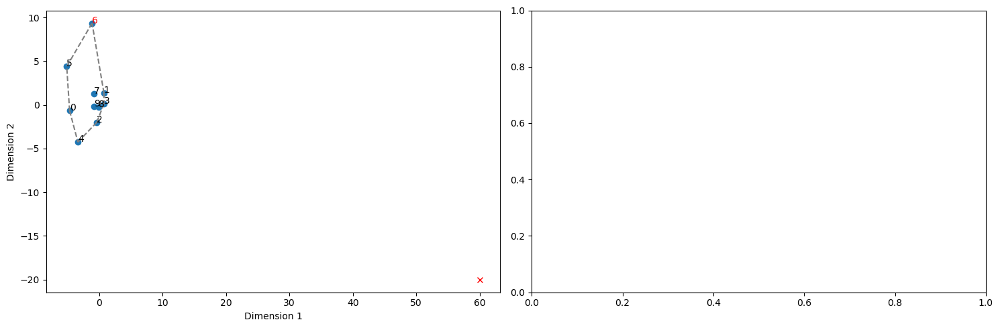

In [10]:
from scipy.spatial import ConvexHull
import difflib

def find_closest_string(target_string, string_list):
    closest_match = difflib.get_close_matches(target_string, string_list, n=1, cutoff=0.2)
    if closest_match:
        closest_index = string_list.index(closest_match[0])
        
        return closest_match[0], closest_index
    else:
        return None, None
    


fig, axes = plt.subplots(1, 2, figsize=(15, 5))

iA = 1
iB = 2
dWeight = 0.8
tPoint = get_halfway_point(encoded_data_test[iA, :], encoded_data_test[iB, :], dWeight)
tPoint = torch.tensor([60, -20], dtype=torch.float32)
sNewString = fn_gen_new(tPoint, 15)
sClosestString, iClosestIdx = find_closest_string(sNewString, lTargetStrings)

print(sClosestString)
print(iClosestIdx)
print(sNewString)


# Compute the convex hull
hull = ConvexHull(encoded_data)

# Plot the convex hull
for simplex in hull.simplices:
    axes[0].plot(encoded_data[simplex, 0], encoded_data[simplex, 1], '--', c="grey")

axes[0].scatter(encoded_data[:, 0], encoded_data[:, 1])
axes[0].set_xlabel('Dimension 1')
axes[0].set_ylabel('Dimension 2')

# Draw the point tPoint with a red cross
axes[0].plot(tPoint.cpu().detach().numpy()[0], tPoint[1].cpu().detach().numpy(), 'rx')

for i, txt in enumerate(range(encoded_data.shape[0])):
    if i == iClosestIdx:
        axes[0].annotate(txt, (encoded_data[i, 0], encoded_data[i, 1]), c="red")
    else:
        axes[0].annotate(txt, (encoded_data[i, 0], encoded_data[i, 1]))
    


plt.tight_layout()
plt.show()


In [11]:
import difflib
def find_closest_string(target_string, string_list):
    
    if "<|endoftext|>" not in target_string[-13:]:
        return None, None, None
    
    else:
    
        closest_match = difflib.get_close_matches(target_string[13:-13], string_list, n=1, cutoff=0.999)
        if closest_match:
            closest_index = string_list.index(closest_match[0])
            similarity_ratio = difflib.SequenceMatcher(None, target_string, closest_match[0]).ratio()
            
            return closest_match[0], closest_index, similarity_ratio
        
        else:
            return None, None, None

def find_new_string(target_string, string_list):
    
    if "<|endoftext|>" not in target_string[-13:]:
        return False
    
    else:
    
        closest_match = difflib.get_close_matches(target_string[13:-13], string_list, n=1, cutoff=1)
        
        if closest_match:
            return False
        
        else:
            print(f"New string: {target_string}")
            return True

In [22]:
def drange(start, stop, step):
    r = start
    while r < stop:
        yield r
        r += step

new_valid_strings = []
closest_matches = []

step_x = 0.5
step_y = 0.5
min_x = -5
max_x = 5
min_y = -10
max_y = 10

for x in drange(min_x, max_x, step):
    for y in drange(min_y, max_y, step):
        point = torch.tensor([x, y], dtype=torch.float32)
        generated_string = fn_gen_new(point, 20)
        
        closest_string, closest_index, distance_measure = find_closest_string(generated_string, lTargetStrings)
        if closest_string is None: 
            closest_index = -1
        
        closest_matches.append((point, closest_index, distance_measure))
        new_valid_strings.append(find_new_string(generated_string, lTargetStrings))


New string: <|endoftext|>Clinically proven to enhance shine by up to%.<|endoftext|>
New string: <|endoftext|>Clinically to enhance enhance by enhance by<|endoftext|>
New string: <|endoftext|>Clin in to enhance by enhance by<|endoftext|>
New string: <|endoftext|>Lin in in enhance staff staff staff staff.<|endoftext|>
New string: <|endoftext|>Locks in hair that hair that l.<|endoftext|>
New string: <|endoftext|>Elocks that hair that hair.<|endoftext|>
New string: <|endoftext|>Elevlevate your confidence with hair that gleamslev.<|endoftext|>
New string: <|endoftext|>Elevlevlev'slev of yourl<|endoftext|>
New string: <|endoftext|>Clinically proven to enhance shine by up to%.<|endoftext|>
New string: <|endoftext|>Clin in to enhance enhance by enhance by<|endoftext|>
New string: <|endoftext|>Lininin's in by<|endoftext|>
New string: <|endoftext|>Locks that hair that hair that hair.<|endoftext|>
New string: <|endoftext|>Elocks that hair that hair.<|endoftext|>
New string: <|endoftext|>Elevlevle

<|endoftext|>Transform youriverseiverseiverseiverseiverseiverse<|endoftext|>


/var/folders/ph/_pvfyv5d5zjf03_vbyrbp1qw0000gn/T/ipykernel_11548/2777250040.py:35: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "rx" (-> color='r'). The keyword argument will take precedence.
  plt.plot(tPoint.cpu().detach().numpy()[0], tPoint[1].cpu().detach().numpy(), 'rx', c="black")


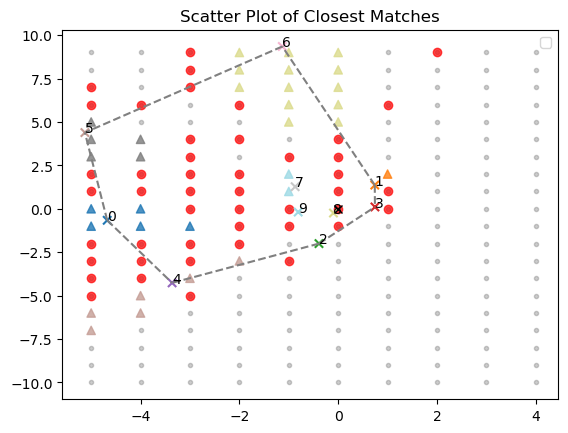

In [23]:
import matplotlib.pyplot as plt

# Extract the x and y coordinates from closest_matches
x_coords = np.asarray([point[0][0].item() for point in closest_matches])
y_coords = np.asarray([point[0][1].item() for point in closest_matches])

# Extract the closest_index values
colors = [point[1] for point in closest_matches]
similarity_ratio = [similarity_ratio[2] for similarity_ratio in closest_matches]

# Plot the scatter plot
vNull = np.asarray(colors) == -1
vNew = np.asarray(new_valid_strings)

tPoint = torch.tensor([0, 0], dtype=torch.float32)
print(fn_gen_new(tPoint, 30))

# cmap="hsv"
plt.scatter(x_coords[vNull], y_coords[vNull], c="grey", marker=".", alpha=0.4)
plt.scatter(x_coords[~vNull], y_coords[~vNull], c=np.asarray(colors)[~vNull], marker="^", alpha=np.asarray(similarity_ratio)[~vNull], cmap="tab20")
plt.scatter(x_coords[vNew], y_coords[vNew], c="red", marker="o", alpha=0.7)
plt.scatter(encoded_data[:, 0], encoded_data[:, 1], marker="x", c = range(len(lTargetStrings)), cmap="tab20")


# Compute the convex hull
hull = ConvexHull(encoded_data)

# Plot the convex hull
for simplex in hull.simplices:
    plt.plot(encoded_data[simplex, 0], encoded_data[simplex, 1], '--', c="grey")

for i, txt in enumerate(range(encoded_data.shape[0])):
    plt.annotate(txt, (encoded_data[i, 0], encoded_data[i, 1]))
    
plt.plot(tPoint.cpu().detach().numpy()[0], tPoint[1].cpu().detach().numpy(), 'rx', c="black")


# Add labels and title
plt.title('Scatter Plot of Closest Matches')
plt.legend()
# Show the plot
plt.show()

In [10]:
lTargetStrings

['Our surface cleaner delivers a mirror-like shine every time.',
 'Say goodbye to streaks and smudges with our powerful formula.',
 'Achieve a noticeable sparkle on all surfaces with just one application.',
 'Experience surfaces so clean, you can see your reflection in them.',
 'Our cleaner leaves behind a gleaming, polished finish that lasts.',
 'Elevate your surroundings with a touch of brilliance.',
 'Unleash the hidden beauty of your home with our surface cleaner.',
 'Experience the joy of pristine surfaces that brighten your space.',
 'Bring a sense of clarity and freshness to your environment.',
 'Enhance the ambiance of any room with surfaces that radiate.']

In [33]:
tEmbeddingPred = ae(tOHETarget)
torch.save(tEmbeddingPred, 'embedding_pred_cleaner_2d.pt')


In [ ]:
for i in range(tOHETarget.shape[0]):
    print(ae(tOHETarget[i, :]))

tensor([ 1.2112e+02,  5.9987e+02, -3.3875e+01, -7.4569e+02, -1.3546e+02,
         1.0528e+03, -7.3800e+01,  1.2362e+03, -1.9888e+02,  2.7633e+02,
        -6.0742e+02,  4.2501e+02, -1.4230e+03,  2.0281e+03, -9.5566e+02,
         7.0487e+01,  1.1019e+03,  1.0383e+03, -6.5086e+02,  2.0682e+02,
         2.2125e+01,  8.3004e+01,  1.4147e+02,  2.4559e+02,  9.7392e+02,
        -2.9866e+02, -4.1906e+02, -2.8782e+02, -5.1623e+01, -8.8010e+02,
         5.4598e+02, -1.1972e+03,  6.4163e+02, -6.2773e+02, -1.2063e+03,
        -6.9569e+02, -9.4996e+02,  1.5320e+02, -5.6047e+02,  4.7472e+02,
         4.6824e+02, -4.3786e+02,  8.1568e+02, -1.3525e+03, -6.0194e+01,
         7.6577e+02, -1.0102e+03,  1.6102e+03,  5.8933e+01, -3.5954e+01,
         1.0273e+03,  1.8438e+02,  1.4473e+03, -4.1928e+02, -6.4492e+02,
         4.8131e+01, -1.3824e+02, -8.3516e+02,  1.5654e+02,  1.4400e+02,
        -5.7154e+01,  1.1014e+03,  7.1195e+02,  2.8492e+02, -6.8821e+02,
         1.7722e+03, -9.0469e+02,  4.6884e+02,  1.7